In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import geopandas as gpd
import folium
import time
from pandas.plotting import lag_plot
import warnings
warnings.filterwarnings('ignore')
from sklearn import metrics
from math import sqrt

data = pd.read_csv('/Users/alket/desktop/dati/new_data_backfill_forwfill.csv', index_col = 0)

In [2]:
data.head(5)

,date,cell_num,nr_people,hours,minutes
0,2017-04-16,486-1252,36.0,0.0,0.0
221,2017-04-16,486-1252,36.0,0.0,15.0
442,2017-04-16,486-1252,34.0,0.0,30.0
663,2017-04-16,486-1252,33.0,0.0,45.0
884,2017-04-16,486-1252,32.0,1.0,0.0


### Aggregare i dati nei vari gradi

In [3]:
# aggrega per numero cella
agg_by_cell = data.groupby(by = data['cell_num'])
print(len(agg_by_cell))

agg_by_date_cell = data.groupby(['date', 'cell_num'])
print(len(agg_by_date_cell))

agg_by_date_cell_hour = data.groupby(['date', 'cell_num', 'hours'])
print(len(agg_by_date_cell_hour))

221
27183
652392


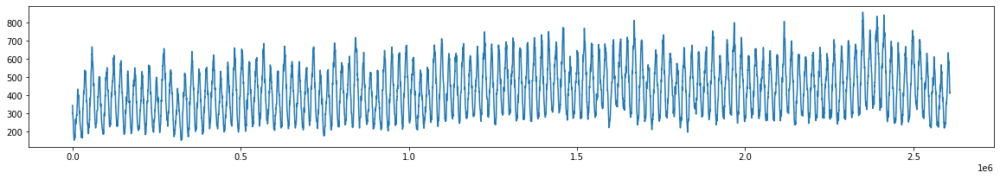

In [4]:
high_act_cell = agg_by_cell.get_group('490-1254')
plt.figure(figsize = (20, 3))
plt.plot(high_act_cell['nr_people'])
plt.show()

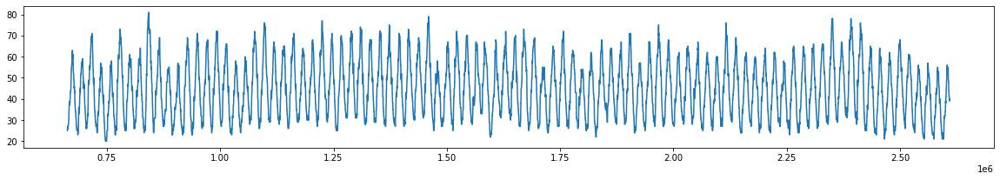

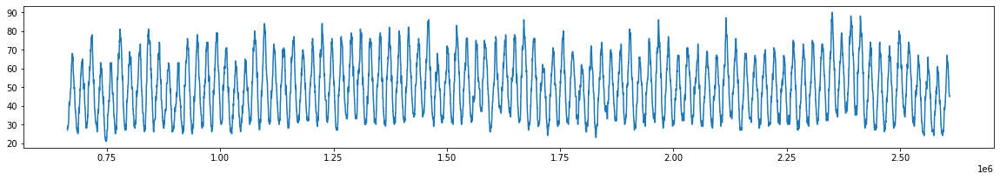

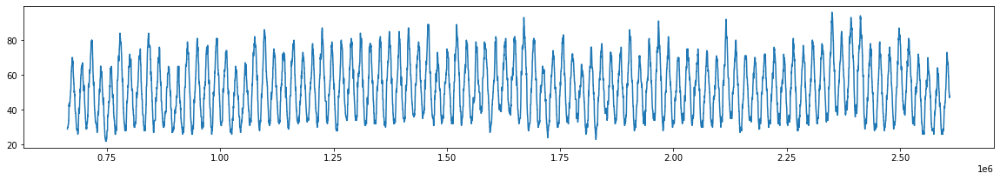

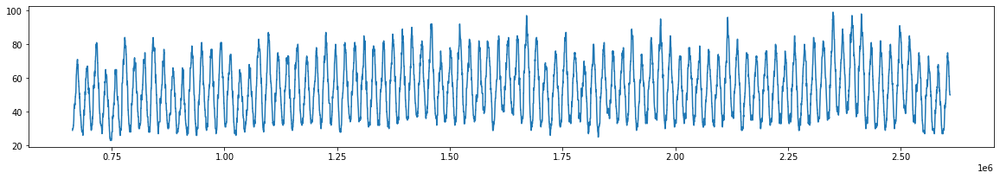

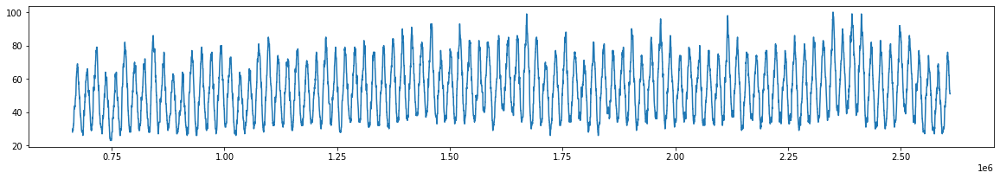

...

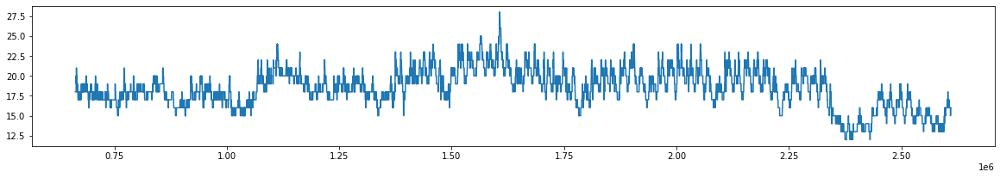

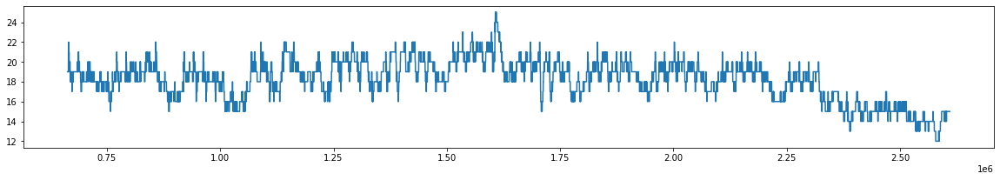

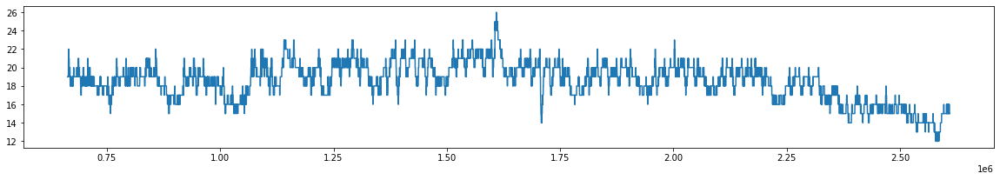

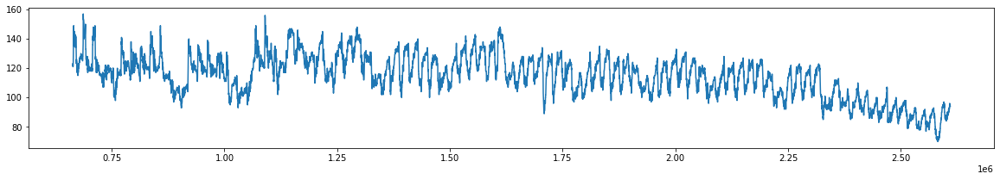

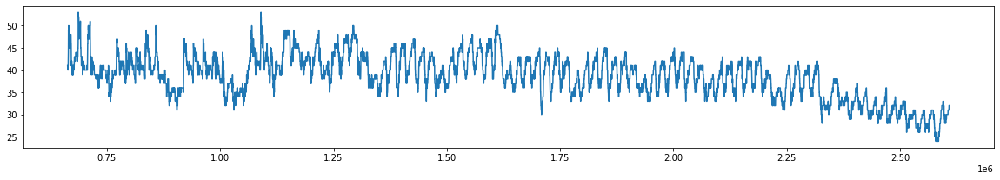

In [5]:
for i, k in agg_by_cell: 
    plt.figure(figsize = (20, 3))
    k = k[3000:]
    plt.plot(k['nr_people'])
    plt.show()

In [6]:
# 488-1264
serie = agg_by_cell.get_group('488-1264')
serie.tail(10)

,date,cell_num,nr_people,hours,minutes
2607404,2017-08-16,488-1264,389.0,21.0,30.0
2607625,2017-08-16,488-1264,383.0,21.0,45.0
2607846,2017-08-16,488-1264,389.0,22.0,0.0
2608067,2017-08-16,488-1264,376.0,22.0,15.0
2608288,2017-08-16,488-1264,376.0,22.0,30.0
2608509,2017-08-16,488-1264,384.0,22.0,45.0
2608730,2017-08-16,488-1264,375.0,23.0,0.0
2608951,2017-08-16,488-1264,362.0,23.0,15.0
2609172,2017-08-16,488-1264,356.0,23.0,30.0
2609393,2017-08-16,488-1264,356.0,23.0,45.0


### Autoregressione semplice (il valore che viene previsto è semplicemente il vaolre precedente)

In [7]:
l = list(serie['nr_people'].shift(1))
serie['nr_people_t1'] = l
serie

,date,cell_num,nr_people,hours,minutes,nr_people_t1
46,2017-04-16,488-1264,394.0,0.0,0.0,NaN
267,2017-04-16,488-1264,396.0,0.0,15.0,394.0
488,2017-04-16,488-1264,387.0,0.0,30.0,396.0
709,2017-04-16,488-1264,375.0,0.0,45.0,387.0
930,2017-04-16,488-1264,365.0,1.0,0.0,375.0
...,...,...,...,...,...,...
2608509,2017-08-16,488-1264,384.0,22.0,45.0,376.0
2608730,2017-08-16,488-1264,375.0,23.0,0.0,384.0
2608951,2017-08-16,488-1264,362.0,23.0,15.0,375.0
2609172,2017-08-16,488-1264,356.0,23.0,30.0,362.0


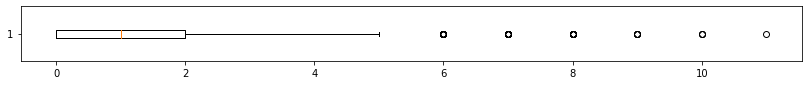

486-1252
MAE for Naive Method :  1.0419242822054713
RMSE for Naive Method:  1.5939561465646317


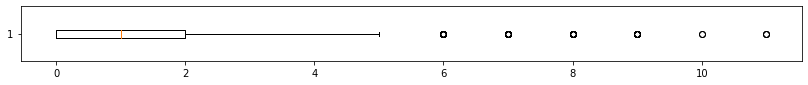

486-1253
MAE for Naive Method :  1.1472855085965952
RMSE for Naive Method:  1.7404167785979328


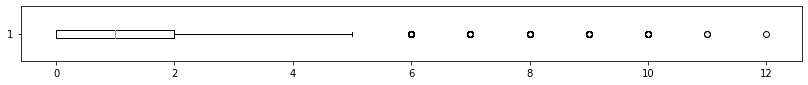

486-1254
MAE for Naive Method :  1.205301939527399
RMSE for Naive Method:  1.8210117185711276


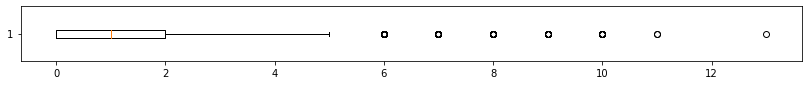

486-1255
MAE for Naive Method :  1.218514440586093
RMSE for Naive Method:  1.8450843911875356


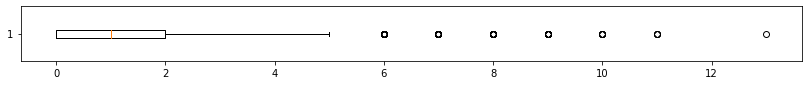

486-1256
MAE for Naive Method :  1.20640298128229
RMSE for Naive Method:  1.8287855747029833


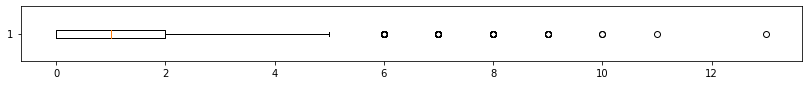

486-1257
MAE for Naive Method :  1.038875243499619
RMSE for Naive Method:  1.594062413850097


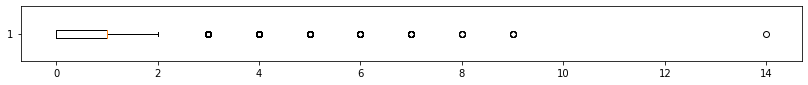

486-1258
MAE for Naive Method :  0.8888794782755992
RMSE for Naive Method:  1.3724842627802956


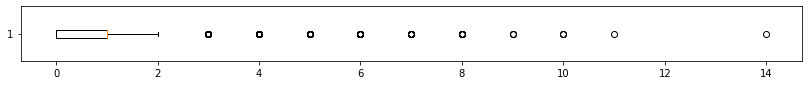

486-1259
MAE for Naive Method :  0.91437282967731
RMSE for Naive Method:  1.4038145711652852


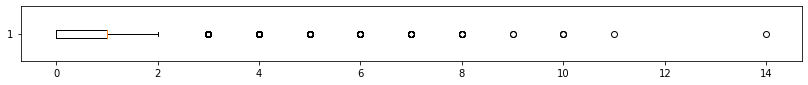

486-1260
MAE for Naive Method :  0.9158973490302363
RMSE for Naive Method:  1.40538233845297


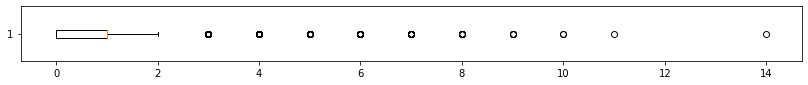

486-1261
MAE for Naive Method :  0.91437282967731
RMSE for Naive Method:  1.4042368345441134


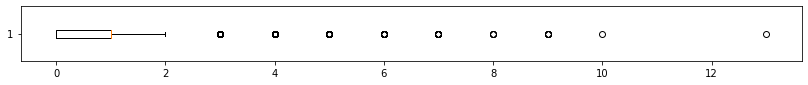

486-1262
MAE for Naive Method :  0.9086982298636402
RMSE for Naive Method:  1.3910566259004056


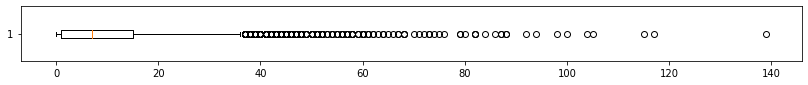

486-1263
MAE for Naive Method :  10.07173710510714
RMSE for Naive Method:  14.91375221336774


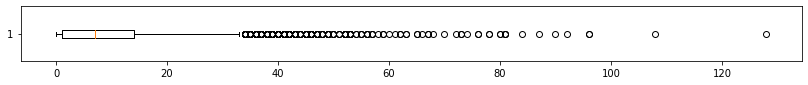

486-1264
MAE for Naive Method :  9.222749216566443
RMSE for Naive Method:  13.640637600787183


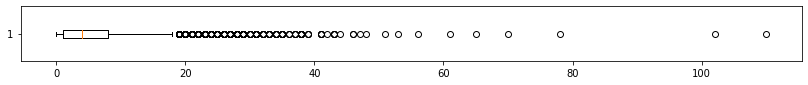

486-1265
MAE for Naive Method :  5.605403574150928
RMSE for Naive Method:  8.457091814857874


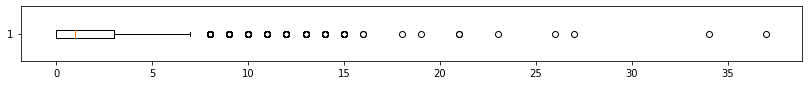

486-1266
MAE for Naive Method :  1.9577369357161005
RMSE for Naive Method:  2.971833558270125


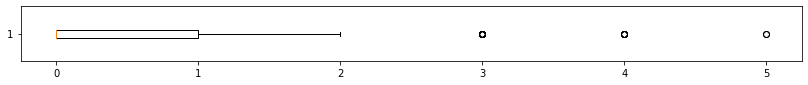

486-1267
MAE for Naive Method :  0.3496231049377488
RMSE for Naive Method:  0.6389306726913349


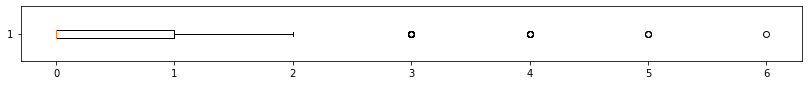

486-1268
MAE for Naive Method :  0.370966375878716
RMSE for Naive Method:  0.6674566900802533


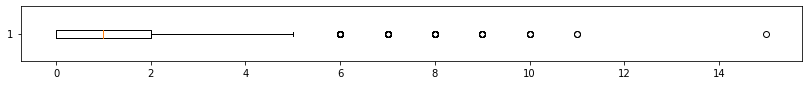

487-1252
MAE for Naive Method :  1.1040060980774118
RMSE for Naive Method:  1.6848057275629833


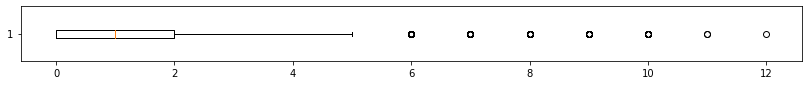

487-1253
MAE for Naive Method :  1.2635724570170237
RMSE for Naive Method:  1.900796193944937


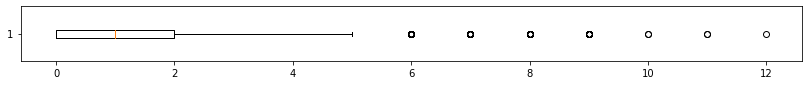

487-1254
MAE for Naive Method :  1.2003049038705853
RMSE for Naive Method:  1.8128308116841214


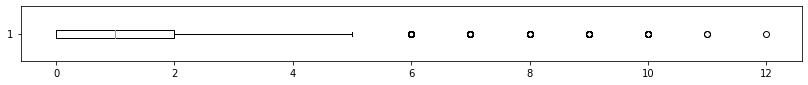

487-1255
MAE for Naive Method :  1.2147878377233845
RMSE for Naive Method:  1.8386006293033574


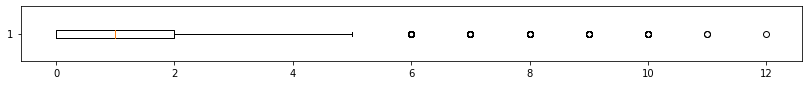

487-1256
MAE for Naive Method :  1.2201236554586263
RMSE for Naive Method:  1.8471718119568945


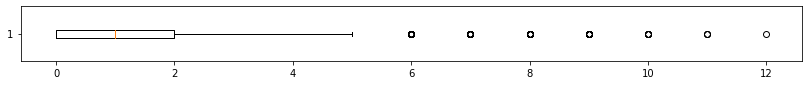

487-1257
MAE for Naive Method :  1.2044549843313288
RMSE for Naive Method:  1.8338959589013961


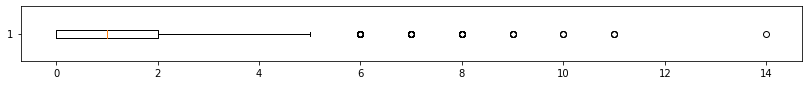

487-1258
MAE for Naive Method :  1.0718218006267468
RMSE for Naive Method:  1.6315835488163084


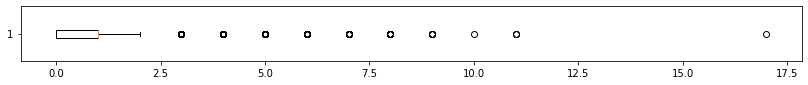

487-1259
MAE for Naive Method :  0.9704412636571526
RMSE for Naive Method:  1.4897521256176018


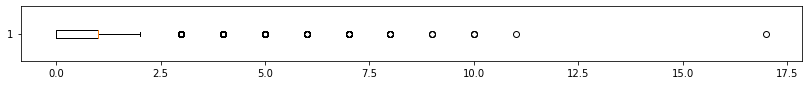

487-1260
MAE for Naive Method :  0.9318201067163547
RMSE for Naive Method:  1.4311209086365777


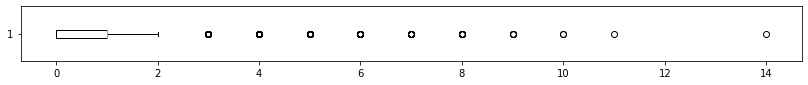

487-1261
MAE for Naive Method :  0.920809689167443
RMSE for Naive Method:  1.412895394973489


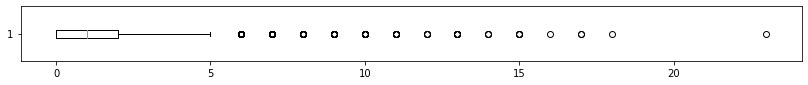

487-1262
MAE for Naive Method :  1.5733886677394766
RMSE for Naive Method:  2.358253994792605


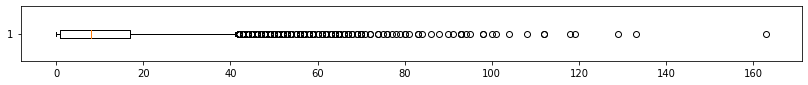

487-1263
MAE for Naive Method :  11.399847548064708
RMSE for Naive Method:  16.885833196822432


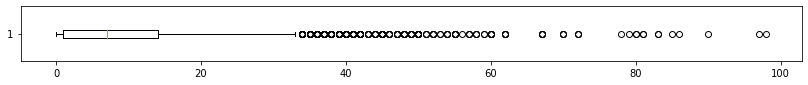

487-1264
MAE for Naive Method :  9.083001609214872
RMSE for Naive Method:  13.36858183450825


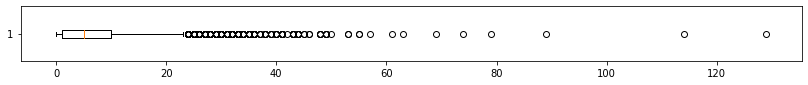

487-1265
MAE for Naive Method :  6.471415262132633
RMSE for Naive Method:  9.754841915573609


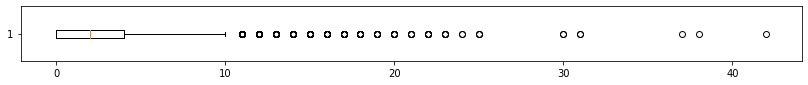

487-1266
MAE for Naive Method :  2.8037604810705514
RMSE for Naive Method:  4.2457737096030685


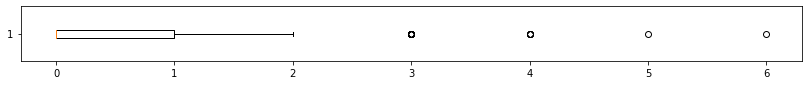

487-1267
MAE for Naive Method :  0.3630896925552638
RMSE for Naive Method:  0.6571624262510435


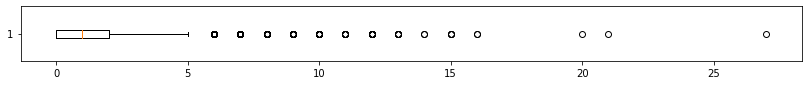

487-1268
MAE for Naive Method :  1.6031167951215382
RMSE for Naive Method:  2.4497663415749904


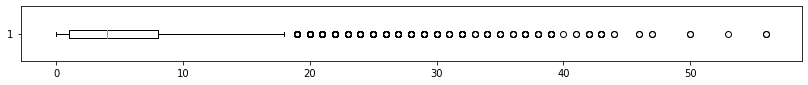

488-1252
MAE for Naive Method :  5.630727534513424
RMSE for Naive Method:  8.38475145221307


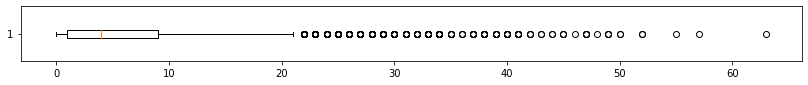

488-1253
MAE for Naive Method :  6.136698568645719
RMSE for Naive Method:  9.110428930872596


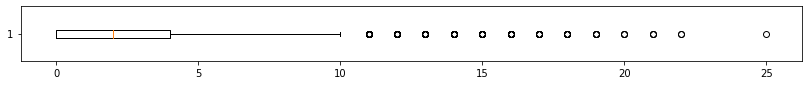

488-1254
MAE for Naive Method :  2.46243753705429
RMSE for Naive Method:  3.665643761422075


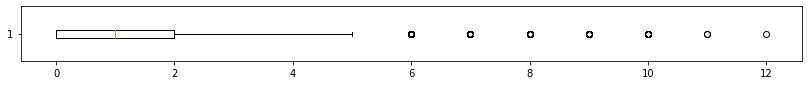

488-1255
MAE for Naive Method :  1.2216481748115524
RMSE for Naive Method:  1.8471718119568945


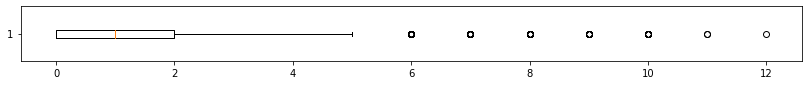

488-1256
MAE for Naive Method :  1.219107309223342
RMSE for Naive Method:  1.8399130193278979


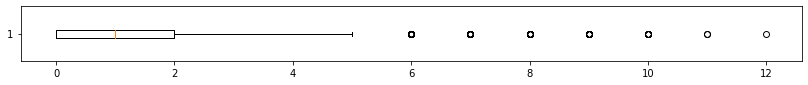

488-1257
MAE for Naive Method :  1.217582789870416
RMSE for Naive Method:  1.841385465335042


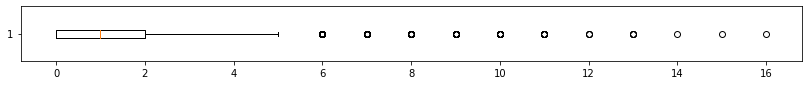

488-1258
MAE for Naive Method :  1.4179723892606082
RMSE for Naive Method:  2.1366464138591588


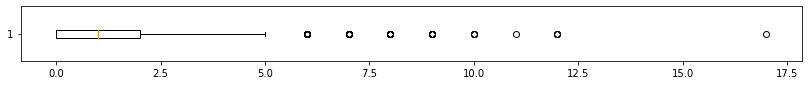

488-1259
MAE for Naive Method :  1.1419496908613533
RMSE for Naive Method:  1.7297020639745235


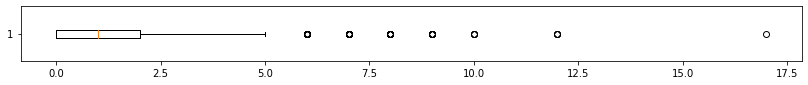

488-1260
MAE for Naive Method :  1.1119674769204708
RMSE for Naive Method:  1.69167872600011


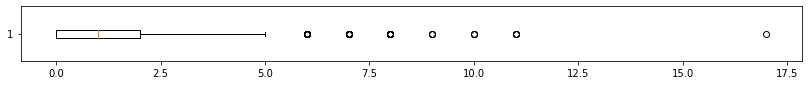

488-1261
MAE for Naive Method :  1.0282883035487422
RMSE for Naive Method:  1.5701058847101113


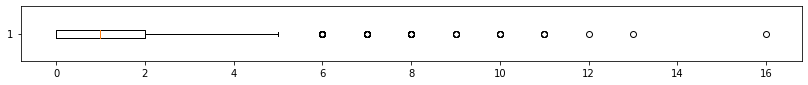

488-1262
MAE for Naive Method :  1.079275006352164
RMSE for Naive Method:  1.635575735570658


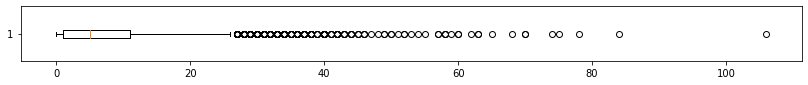

488-1263
MAE for Naive Method :  7.138053696959431
RMSE for Naive Method:  10.584801759518388


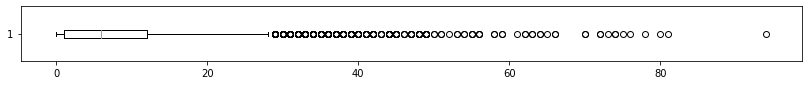

488-1264
MAE for Naive Method :  8.2705174896248
RMSE for Naive Method:  12.171420385896393


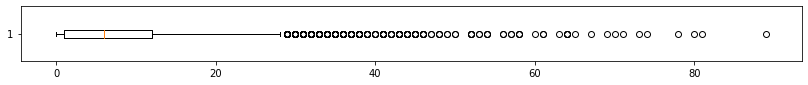

488-1265
MAE for Naive Method :  7.797662403658847
RMSE for Naive Method:  11.496166888922977


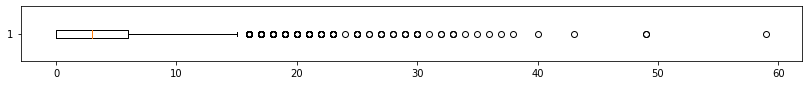

488-1266
MAE for Naive Method :  3.85965952401118
RMSE for Naive Method:  5.8074682571864455


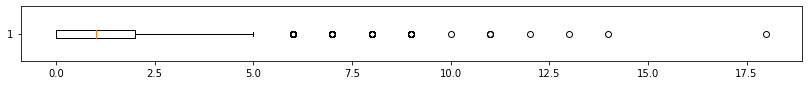

488-1267
MAE for Naive Method :  1.1066316591852292
RMSE for Naive Method:  1.714233282924152


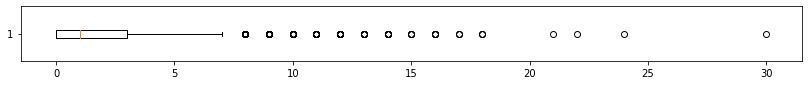

488-1268
MAE for Naive Method :  1.8689760311679513
RMSE for Naive Method:  2.8442384842456208


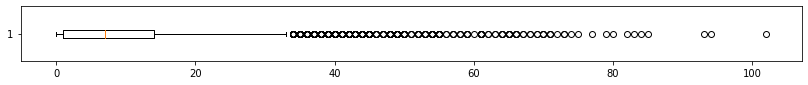

489-1252
MAE for Naive Method :  9.63369187769967
RMSE for Naive Method:  14.32628939984651


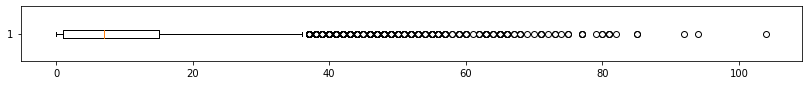

489-1253
MAE for Naive Method :  10.076056576607098
RMSE for Naive Method:  14.958200986168434


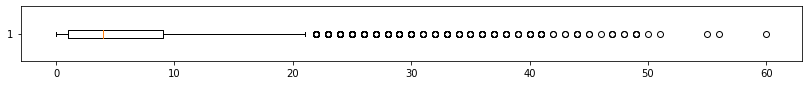

489-1254
MAE for Naive Method :  6.08393325993055
RMSE for Naive Method:  9.039325731061378


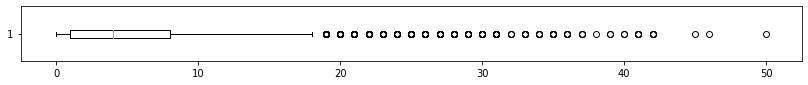

489-1255
MAE for Naive Method :  5.122385025832133
RMSE for Naive Method:  7.6050225677587076


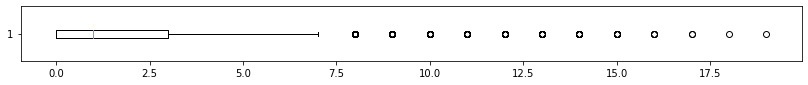

489-1256
MAE for Naive Method :  1.9551960701278903
RMSE for Naive Method:  2.9231569026707946


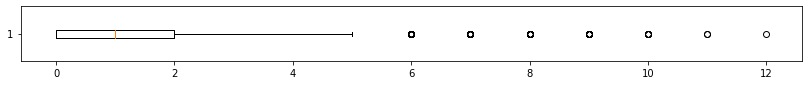

489-1257
MAE for Naive Method :  1.2180909629880579
RMSE for Naive Method:  1.8384854626775449


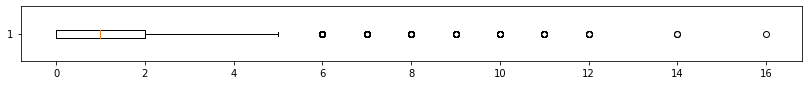

489-1258
MAE for Naive Method :  1.3791818412805963
RMSE for Naive Method:  2.091536178913052


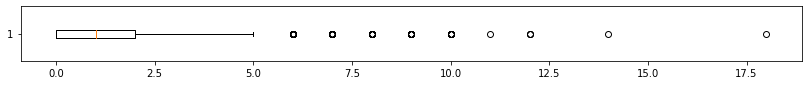

489-1259
MAE for Naive Method :  1.2191920047429492
RMSE for Naive Method:  1.8455433674113484


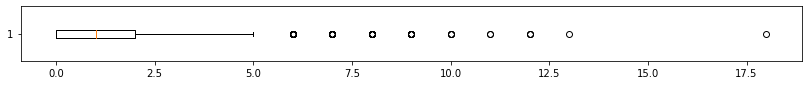

489-1260
MAE for Naive Method :  1.1493182010671636
RMSE for Naive Method:  1.7471194940921302


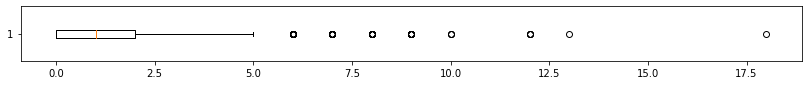

489-1261
MAE for Naive Method :  1.1553315829592614
RMSE for Naive Method:  1.7520330239801316


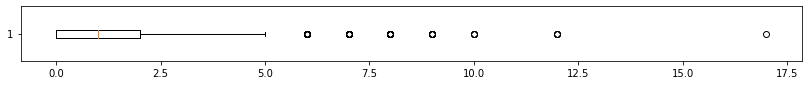

489-1262
MAE for Naive Method :  1.1168798170576777
RMSE for Naive Method:  1.6963783981433722


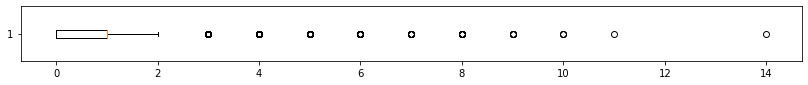

489-1263
MAE for Naive Method :  0.9355467095790633
RMSE for Naive Method:  1.4372625797727574


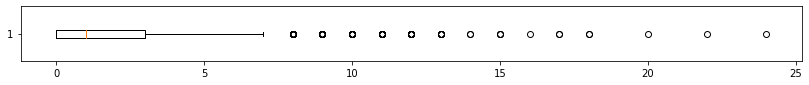

489-1264
MAE for Naive Method :  1.729059032777166
RMSE for Naive Method:  2.6044862950004672


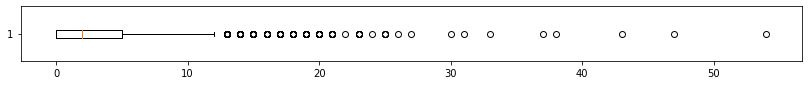

489-1265
MAE for Naive Method :  3.027526043872279
RMSE for Naive Method:  4.5698701350891335


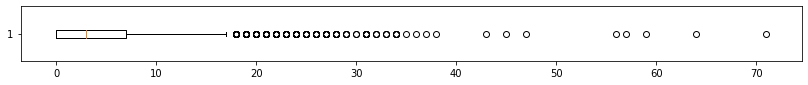

489-1266
MAE for Naive Method :  4.366223426780723
RMSE for Naive Method:  6.6039069002433886


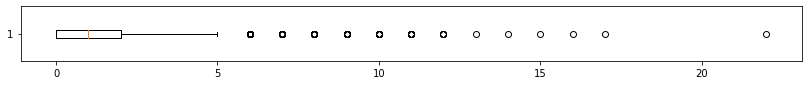

489-1267
MAE for Naive Method :  1.3419158126535107
RMSE for Naive Method:  2.0683255776956915


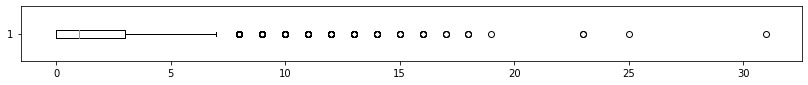

489-1268
MAE for Naive Method :  1.920132125010587
RMSE for Naive Method:  2.9271525824670377


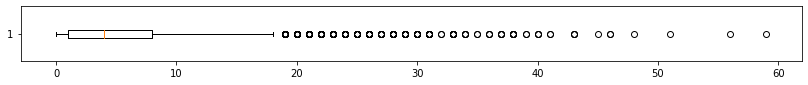

490-1252
MAE for Naive Method :  5.080460743626662
RMSE for Naive Method:  7.5971503530543965


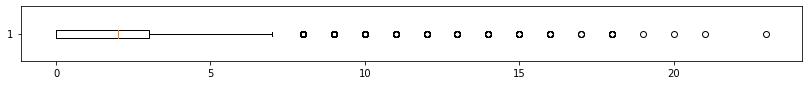

490-1253
MAE for Naive Method :  2.2215634792919454
RMSE for Naive Method:  3.3193178146476243


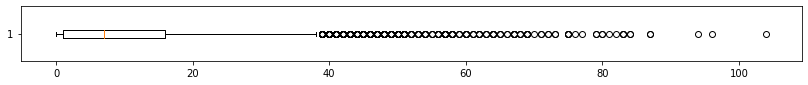

490-1254
MAE for Naive Method :  10.421444905564496
RMSE for Naive Method:  15.484332289624003


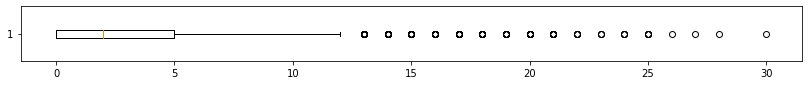

490-1255
MAE for Naive Method :  3.0611501651562634
RMSE for Naive Method:  4.552926940803769


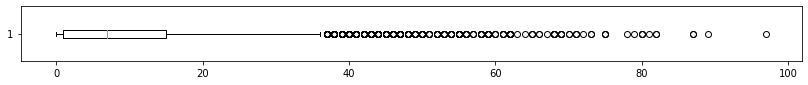

490-1256
MAE for Naive Method :  10.071567714067927
RMSE for Naive Method:  14.920054595585725


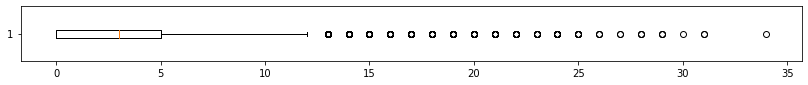

490-1257
MAE for Naive Method :  3.5513678326416533
RMSE for Naive Method:  5.264037161379581


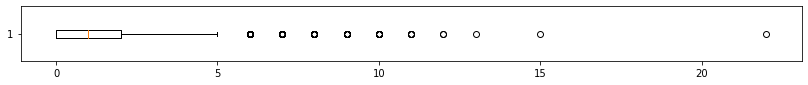

490-1258
MAE for Naive Method :  1.3087151689675616
RMSE for Naive Method:  1.9767428999718557


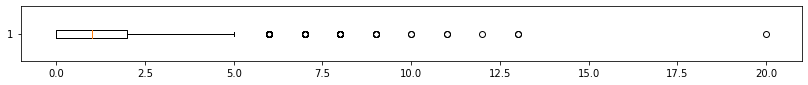

490-1259
MAE for Naive Method :  1.0974845430676716
RMSE for Naive Method:  1.6738362490399064


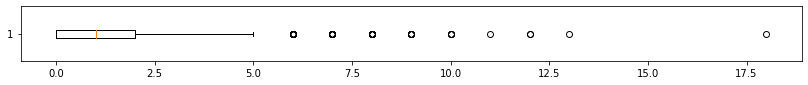

490-1260
MAE for Naive Method :  1.098585584822563
RMSE for Naive Method:  1.6786615599473655


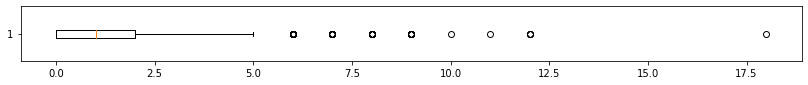

490-1261
MAE for Naive Method :  1.1132379097145761
RMSE for Naive Method:  1.6894994530320349


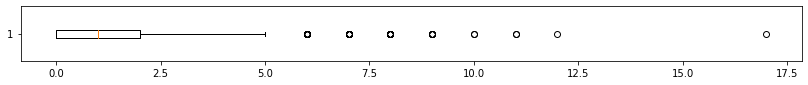

490-1262
MAE for Naive Method :  1.0159227576861185
RMSE for Naive Method:  1.5573777945591831


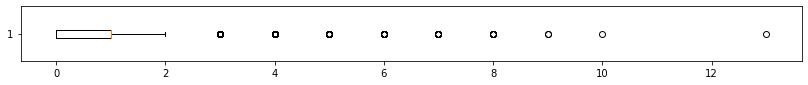

490-1263
MAE for Naive Method :  0.781739645972728
RMSE for Naive Method:  1.2303851906845054


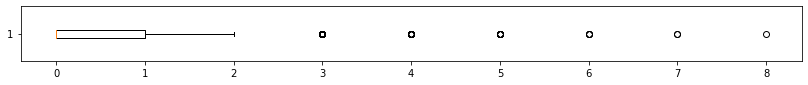

490-1264
MAE for Naive Method :  0.5814347421021427
RMSE for Naive Method:  0.9356802798914228


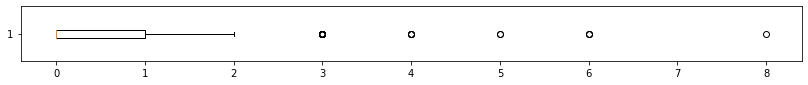

490-1265
MAE for Naive Method :  0.41162022529008213
RMSE for Naive Method:  0.7266304901599696


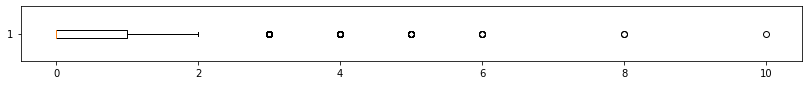

490-1266
MAE for Naive Method :  0.6192936393664775
RMSE for Naive Method:  1.0031710541929157


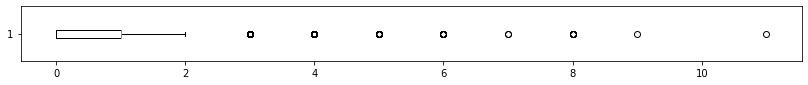

490-1267
MAE for Naive Method :  0.7263487761497417
RMSE for Naive Method:  1.1637359487942849


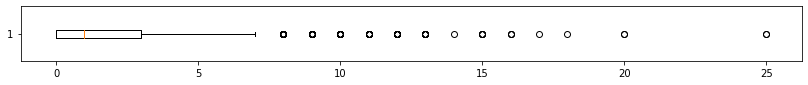

490-1268
MAE for Naive Method :  1.7048361141695605
RMSE for Naive Method:  2.605884240623797


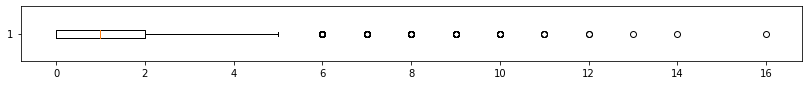

491-1252
MAE for Naive Method :  1.2349453713898535
RMSE for Naive Method:  1.8910128326713405


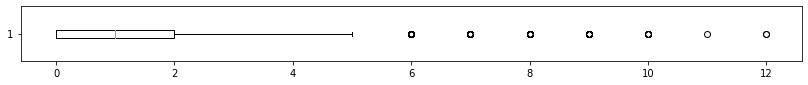

491-1253
MAE for Naive Method :  1.1834504954687897
RMSE for Naive Method:  1.7993957372008227


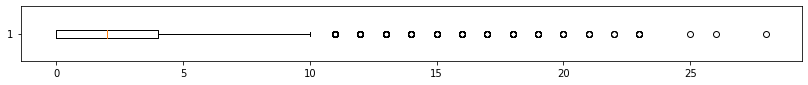

491-1254
MAE for Naive Method :  2.780215126619802
RMSE for Naive Method:  4.147958055005646


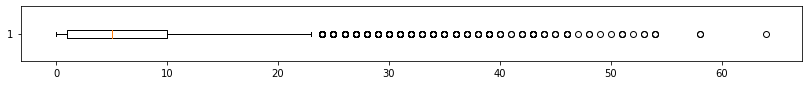

491-1255
MAE for Naive Method :  6.521893791818413
RMSE for Naive Method:  9.675203029115806


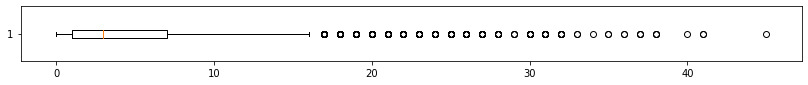

491-1256
MAE for Naive Method :  4.632675531464385
RMSE for Naive Method:  6.870679267018878


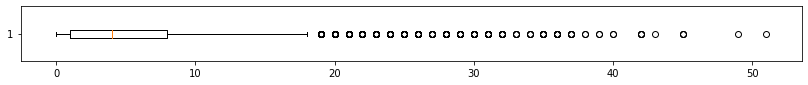

491-1257
MAE for Naive Method :  5.3331921741339885
RMSE for Naive Method:  7.885739681177797


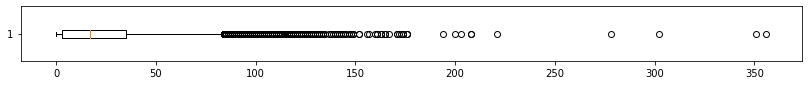

491-1258
MAE for Naive Method :  23.531379690014397
RMSE for Naive Method:  34.894093783581575


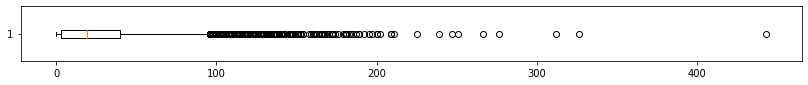

491-1259
MAE for Naive Method :  26.74964004404167
RMSE for Naive Method:  39.77515466684031


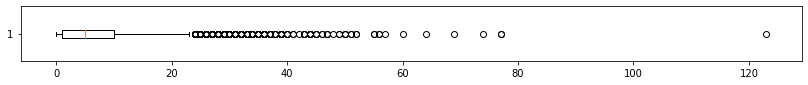

491-1260
MAE for Naive Method :  6.68586431777759
RMSE for Naive Method:  9.977759633512004


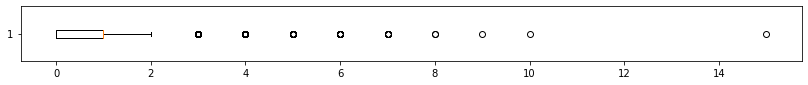

491-1261
MAE for Naive Method :  0.7609045481494029
RMSE for Naive Method:  1.1972414016517656


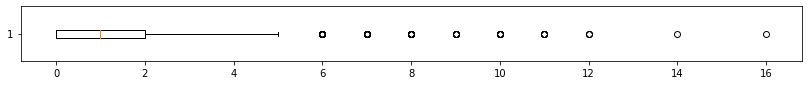

491-1262
MAE for Naive Method :  1.1793004150080462
RMSE for Naive Method:  1.8066532413872505


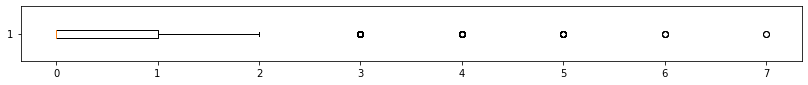

491-1263
MAE for Naive Method :  0.6035402727195731
RMSE for Naive Method:  0.9818372595125017


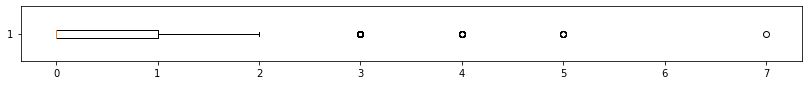

491-1264
MAE for Naive Method :  0.5172355382400271
RMSE for Naive Method:  0.8509183257636143


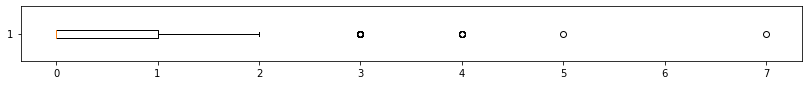

491-1265
MAE for Naive Method :  0.3965444228000339
RMSE for Naive Method:  0.7065376087397849


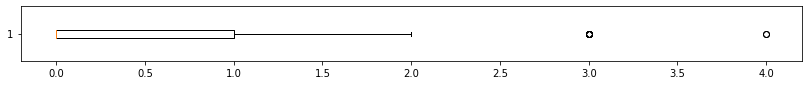

491-1266
MAE for Naive Method :  0.29457101719319045
RMSE for Naive Method:  0.5683561487141199


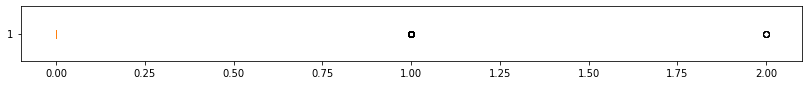

491-1267
MAE for Naive Method :  0.15948166342000508
RMSE for Naive Method:  0.4004105625680661


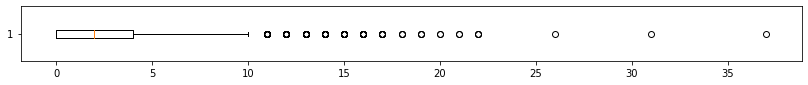

491-1268
MAE for Naive Method :  2.371643940035572
RMSE for Naive Method:  3.5886101971773847


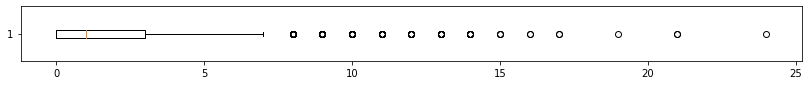

492-1252
MAE for Naive Method :  1.7172016600321842
RMSE for Naive Method:  2.61623172082305


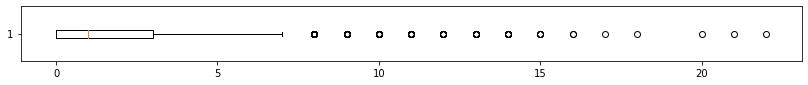

492-1253
MAE for Naive Method :  1.8032523079529093
RMSE for Naive Method:  2.725196511773074


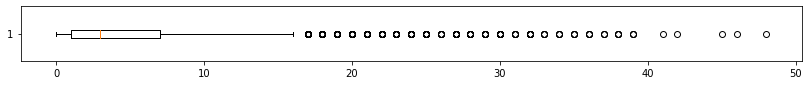

492-1254
MAE for Naive Method :  4.865164732785636
RMSE for Naive Method:  7.238715396592729


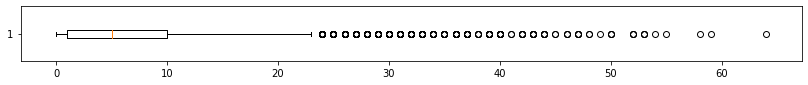

492-1255
MAE for Naive Method :  6.554247480308292
RMSE for Naive Method:  9.728011104579256


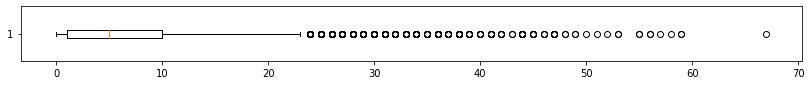

492-1256
MAE for Naive Method :  6.789531633776574
RMSE for Naive Method:  10.06058550514634


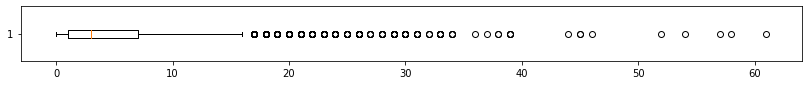

492-1257
MAE for Naive Method :  4.82053019395274
RMSE for Naive Method:  7.215399997252566


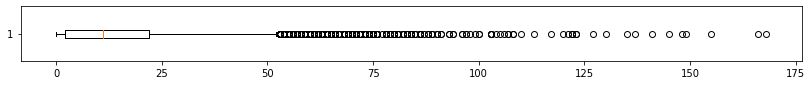

492-1258
MAE for Naive Method :  15.225628864233082
RMSE for Naive Method:  22.546285077148426


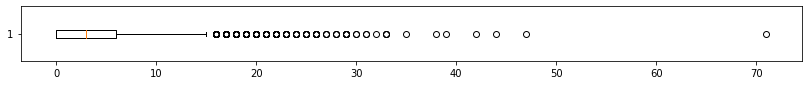

492-1259
MAE for Naive Method :  3.91352587448124
RMSE for Naive Method:  5.833645690113019


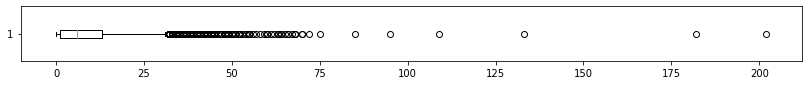

492-1260
MAE for Naive Method :  8.56534259337681
RMSE for Naive Method:  13.100231876177666


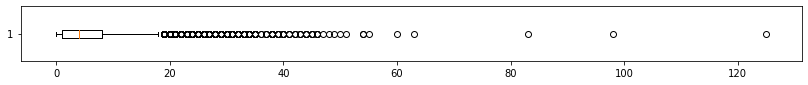

492-1261
MAE for Naive Method :  5.732616244600661
RMSE for Naive Method:  8.846990847561147


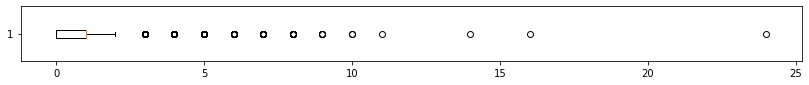

492-1262
MAE for Naive Method :  0.9647666638434826
RMSE for Naive Method:  1.538446065163798


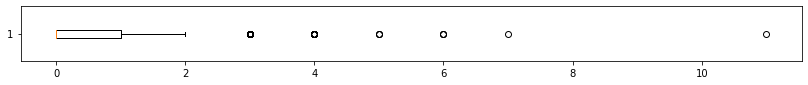

492-1263
MAE for Naive Method :  0.47903785889726436
RMSE for Naive Method:  0.8274530684595298


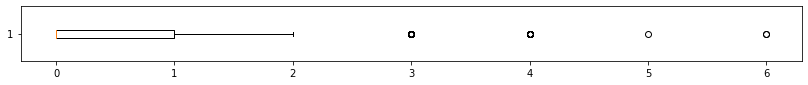

492-1264
MAE for Naive Method :  0.4471076480054205
RMSE for Naive Method:  0.7700346308892195


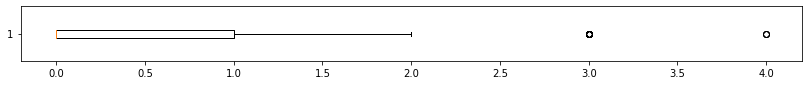

492-1265
MAE for Naive Method :  0.351062928771068
RMSE for Naive Method:  0.6378029324740381


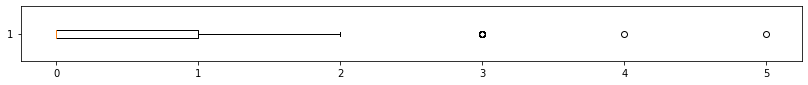

492-1266
MAE for Naive Method :  0.2760226983992547
RMSE for Naive Method:  0.5588133684791875


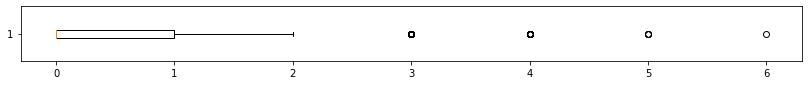

492-1267
MAE for Naive Method :  0.522994833573304
RMSE for Naive Method:  0.869526827379008


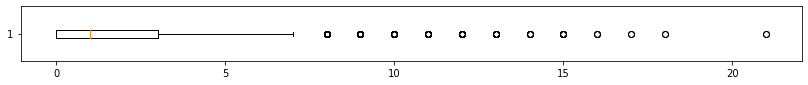

492-1268
MAE for Naive Method :  1.8710934191581265
RMSE for Naive Method:  2.836620021212683


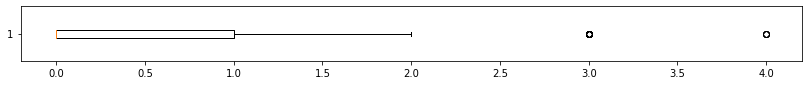

493-1252
MAE for Naive Method :  0.33937494706530025
RMSE for Naive Method:  0.6276295576948367


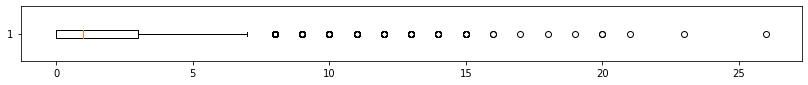

493-1253
MAE for Naive Method :  1.879901753197256
RMSE for Naive Method:  2.8562879094491005


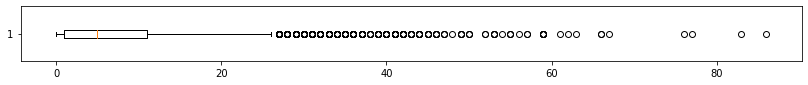

493-1254
MAE for Naive Method :  7.368510205810113
RMSE for Naive Method:  11.047101509712926


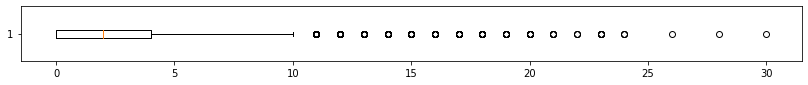

493-1255
MAE for Naive Method :  2.8642330820699584
RMSE for Naive Method:  4.2767400706907654


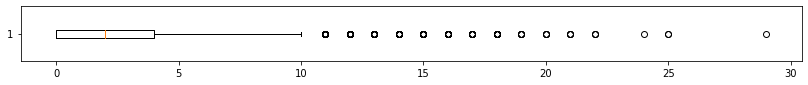

493-1256
MAE for Naive Method :  2.7437960531887864
RMSE for Naive Method:  4.069273943765188


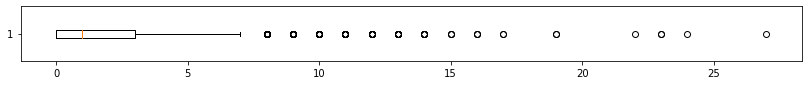

493-1257
MAE for Naive Method :  1.8002032692470569
RMSE for Naive Method:  2.744798818784832


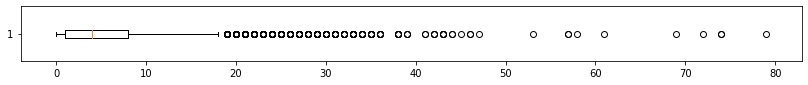

493-1258
MAE for Naive Method :  5.591682899974591
RMSE for Naive Method:  8.412327663145316


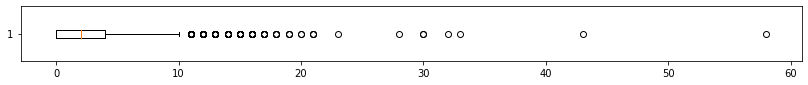

493-1259
MAE for Naive Method :  2.3670703819767933
RMSE for Naive Method:  3.6562741711708244


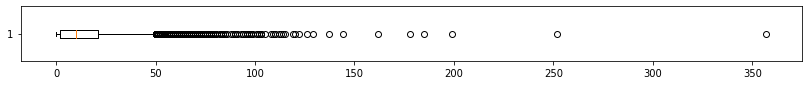

493-1260
MAE for Naive Method :  14.145591598204454
RMSE for Naive Method:  21.774351540880204


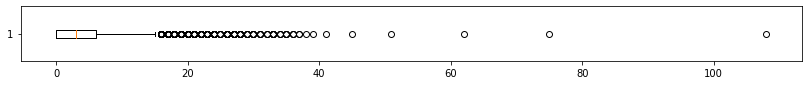

493-1261
MAE for Naive Method :  4.337426950114339
RMSE for Naive Method:  6.699821568182357


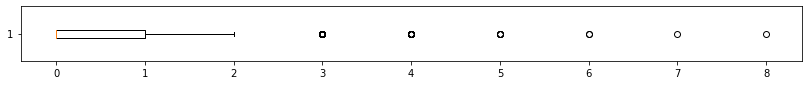

493-1262
MAE for Naive Method :  0.4707376979757771
RMSE for Naive Method:  0.8180855676117352


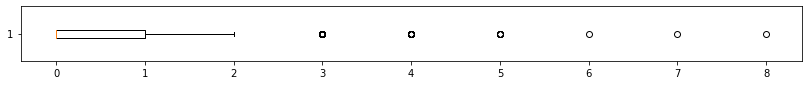

493-1263
MAE for Naive Method :  0.45405268061319554
RMSE for Naive Method:  0.7969515051325199


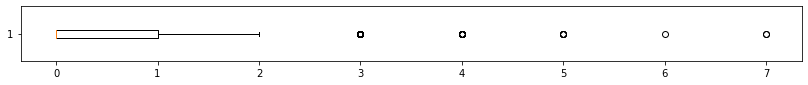

493-1264
MAE for Naive Method :  0.4613364952993987
RMSE for Naive Method:  0.8019308451331998


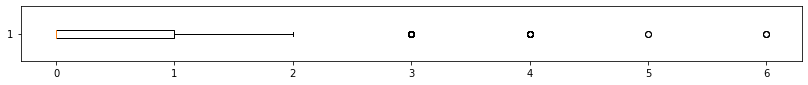

493-1265
MAE for Naive Method :  0.443635131701533
RMSE for Naive Method:  0.7787296837710834


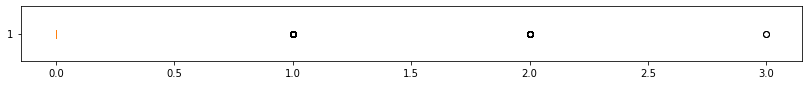

493-1266
MAE for Naive Method :  0.21682053019395273
RMSE for Naive Method:  0.47446885157556973


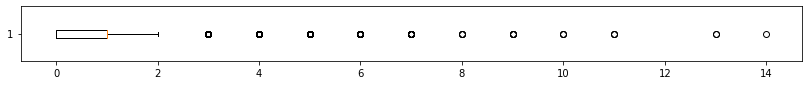

493-1267
MAE for Naive Method :  0.9880579317354112
RMSE for Naive Method:  1.56937749129135


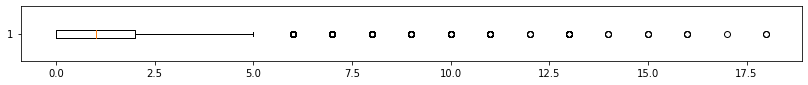

493-1268
MAE for Naive Method :  1.4887778436520709
RMSE for Naive Method:  2.3729867923340517


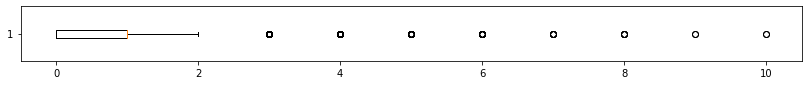

494-1252
MAE for Naive Method :  0.7859744219530787
RMSE for Naive Method:  1.2832187234448937


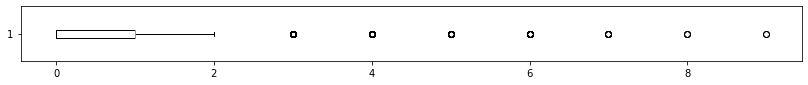

494-1253
MAE for Naive Method :  0.6963665622088592
RMSE for Naive Method:  1.1198222462968983


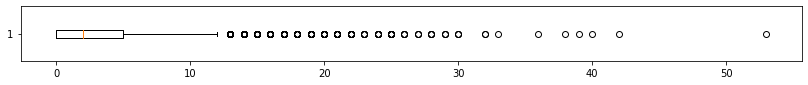

494-1254
MAE for Naive Method :  3.5676293724062
RMSE for Naive Method:  5.40566598091424


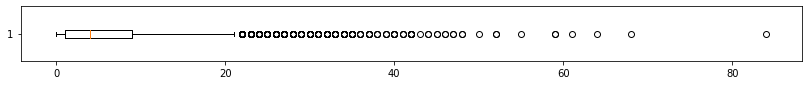

494-1255
MAE for Naive Method :  5.845007199119166
RMSE for Naive Method:  8.795946770919508


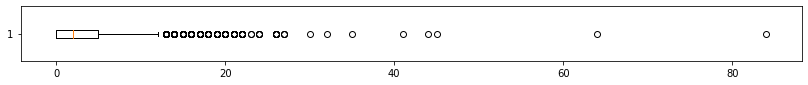

494-1256
MAE for Naive Method :  3.231981028203608
RMSE for Naive Method:  4.96911780764237


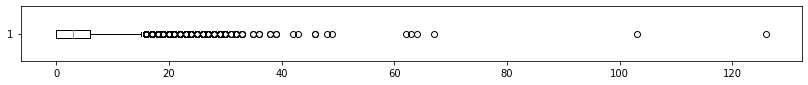

494-1257
MAE for Naive Method :  4.358600830016092
RMSE for Naive Method:  6.880853914205261


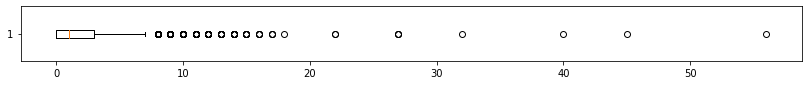

494-1258
MAE for Naive Method :  1.7591259422376557
RMSE for Naive Method:  2.884114486570174


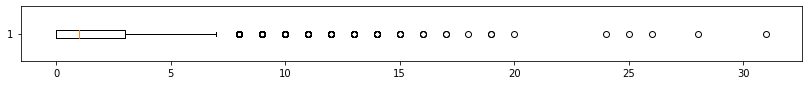

494-1259
MAE for Naive Method :  1.940374354196663
RMSE for Naive Method:  2.981862679498071


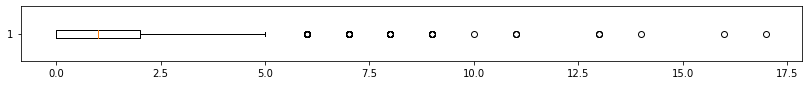

494-1260
MAE for Naive Method :  1.08647412551876
RMSE for Naive Method:  1.6981000148814431


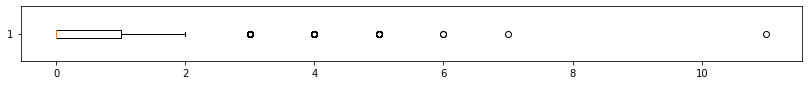

494-1261
MAE for Naive Method :  0.576183619886508
RMSE for Naive Method:  0.956538393539203


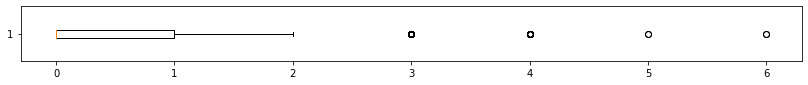

494-1262
MAE for Naive Method :  0.47878377233844327
RMSE for Naive Method:  0.8194820162541728


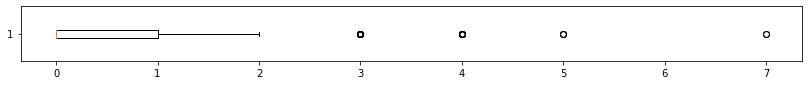

494-1263
MAE for Naive Method :  0.48039298721097656
RMSE for Naive Method:  0.8254033921173397


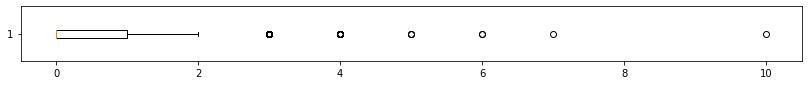

494-1264
MAE for Naive Method :  0.4873380198187516
RMSE for Naive Method:  0.8347902343262655


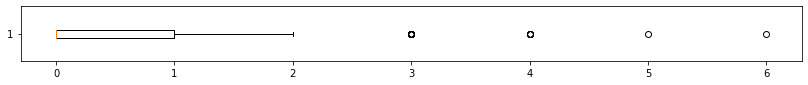

494-1265
MAE for Naive Method :  0.35487422715338357
RMSE for Naive Method:  0.6537381677223585


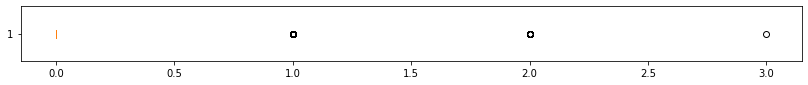

494-1266
MAE for Naive Method :  0.18954857288049462
RMSE for Naive Method:  0.44097722505555925


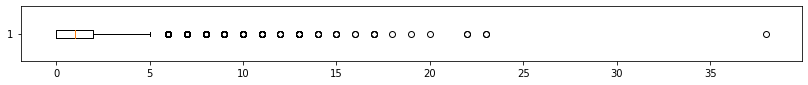

494-1267
MAE for Naive Method :  1.6778182434149234
RMSE for Naive Method:  2.666430214524711


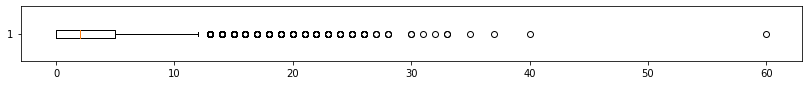

494-1268
MAE for Naive Method :  3.2440924875074106
RMSE for Naive Method:  5.134038054344482


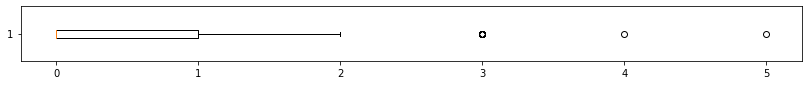

495-1252
MAE for Naive Method :  0.2901668501736258
RMSE for Naive Method:  0.5729570961221979


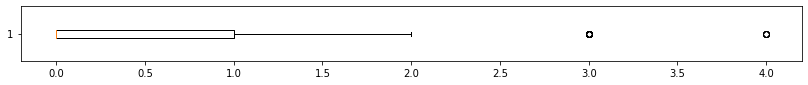

495-1253
MAE for Naive Method :  0.3267553146438553
RMSE for Naive Method:  0.622820583956663


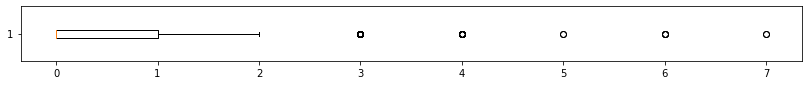

495-1254
MAE for Naive Method :  0.4748877784365207
RMSE for Naive Method:  0.8153374352962357


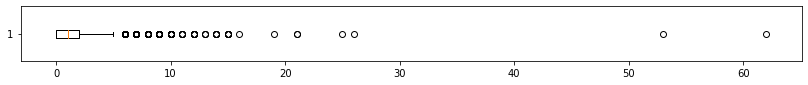

495-1255
MAE for Naive Method :  1.5331582959261456
RMSE for Naive Method:  2.4836212861422213


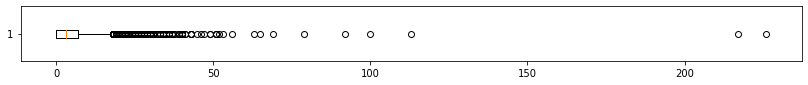

495-1256
MAE for Naive Method :  5.11992885576353
RMSE for Naive Method:  8.606730069547218


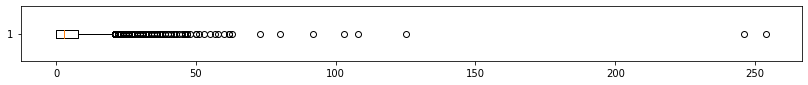

495-1257
MAE for Naive Method :  5.294486321673584
RMSE for Naive Method:  9.049715411560538


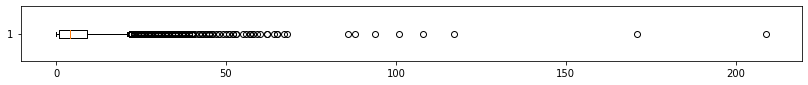

495-1258
MAE for Naive Method :  6.361480477682731
RMSE for Naive Method:  10.316290470541437


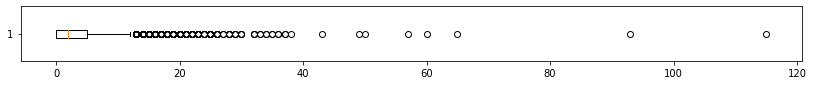

495-1259
MAE for Naive Method :  3.614635385788092
RMSE for Naive Method:  5.839326898678176


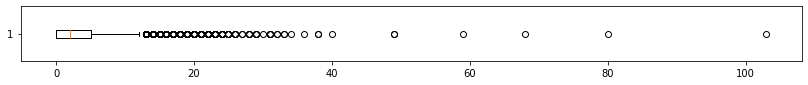

495-1260
MAE for Naive Method :  3.6919623951892944
RMSE for Naive Method:  5.862682924344307


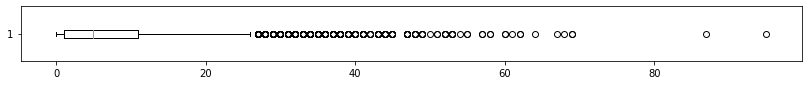

495-1261
MAE for Naive Method :  7.376895062251207
RMSE for Naive Method:  11.184581305617115


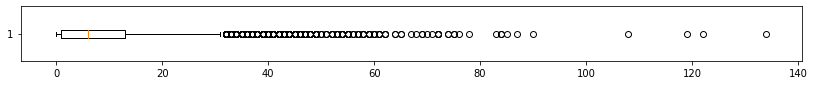

495-1262
MAE for Naive Method :  8.867790293893453
RMSE for Naive Method:  13.752836429879766


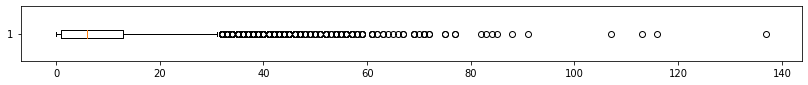

495-1263
MAE for Naive Method :  8.786313204031506
RMSE for Naive Method:  13.627943482689355


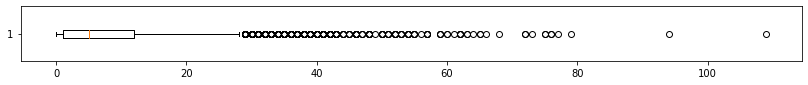

495-1264
MAE for Naive Method :  7.917845345981197
RMSE for Naive Method:  12.201381847162475


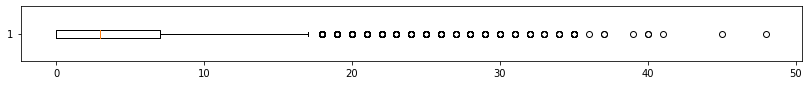

495-1265
MAE for Naive Method :  4.659524011179808
RMSE for Naive Method:  7.189912519833321


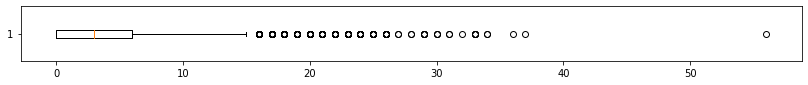

495-1266
MAE for Naive Method :  3.9764546455492504
RMSE for Naive Method:  6.134347509018036


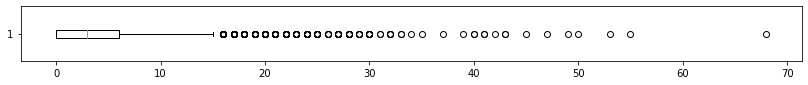

495-1267
MAE for Naive Method :  4.099009062420598
RMSE for Naive Method:  6.412178480193888


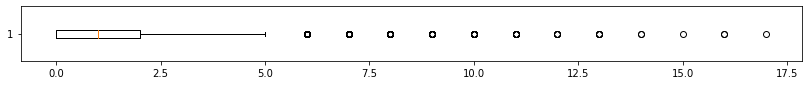

495-1268
MAE for Naive Method :  1.4189040399762853
RMSE for Naive Method:  2.2234953487741227


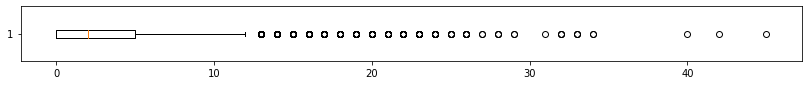

496-1252
MAE for Naive Method :  3.3557211823494537
RMSE for Naive Method:  5.248907414935343


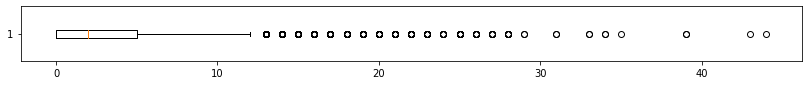

496-1253
MAE for Naive Method :  3.442534089946642
RMSE for Naive Method:  5.414518937993388


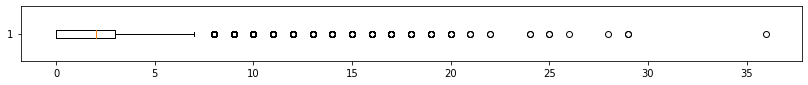

496-1254
MAE for Naive Method :  2.357753874820022
RMSE for Naive Method:  3.736130161869602


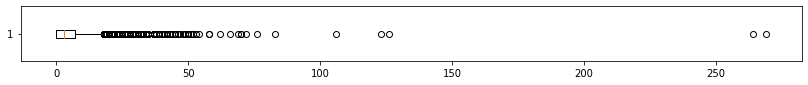

496-1255
MAE for Naive Method :  5.091471161175574
RMSE for Naive Method:  9.043915705127022


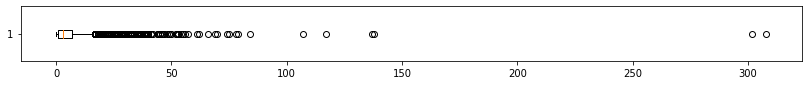

496-1256
MAE for Naive Method :  5.263657152536631
RMSE for Naive Method:  9.555302341047632


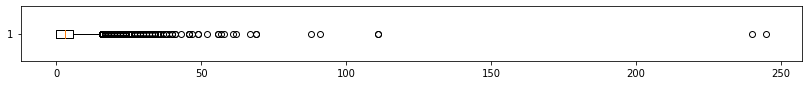

496-1257
MAE for Naive Method :  4.157533666469043
RMSE for Naive Method:  7.6004885437160645


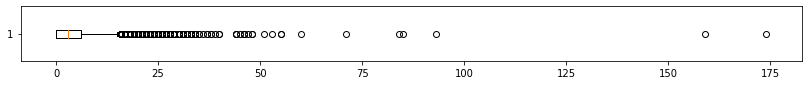

496-1258
MAE for Naive Method :  4.302701787075463
RMSE for Naive Method:  7.265908589273505


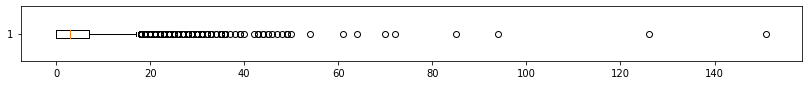

496-1259
MAE for Naive Method :  4.672567121199289
RMSE for Naive Method:  7.61383223243441


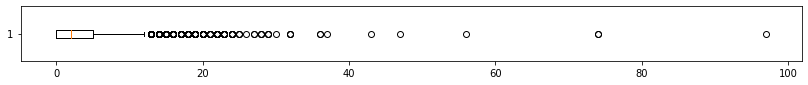

496-1260
MAE for Naive Method :  3.2362158041839586
RMSE for Naive Method:  5.190827855525226


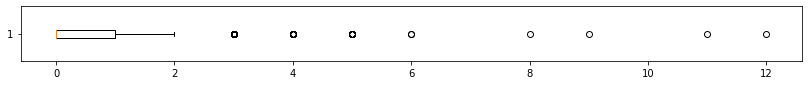

496-1261
MAE for Naive Method :  0.5177437113576692
RMSE for Naive Method:  0.8927875083252439


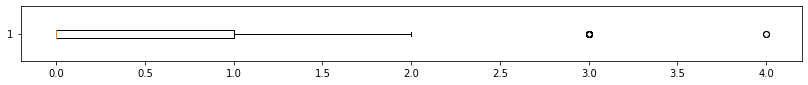

496-1262
MAE for Naive Method :  0.3206572372321504
RMSE for Naive Method:  0.6067015149248249


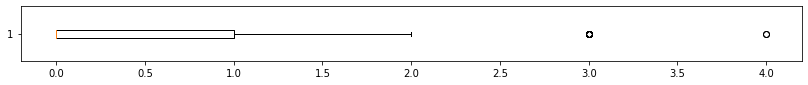

496-1263
MAE for Naive Method :  0.29685779622257985
RMSE for Naive Method:  0.577594712347701


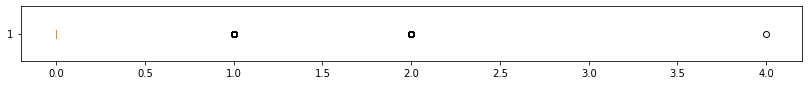

496-1264
MAE for Naive Method :  0.2351147624290675
RMSE for Naive Method:  0.499343178308311


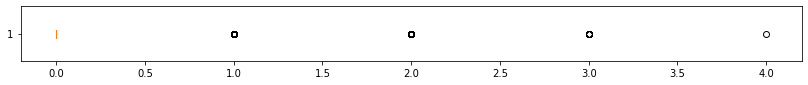

496-1265
MAE for Naive Method :  0.2546794274582875
RMSE for Naive Method:  0.5258620270725932


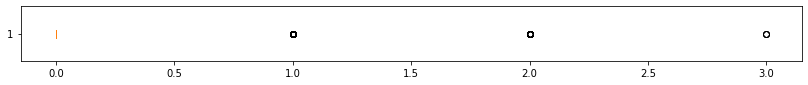

496-1266
MAE for Naive Method :  0.22664521046836622
RMSE for Naive Method:  0.48680392753183677


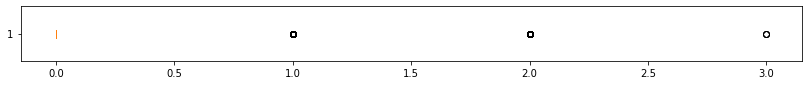

496-1267
MAE for Naive Method :  0.2415516219192005
RMSE for Naive Method:  0.5110782547399443


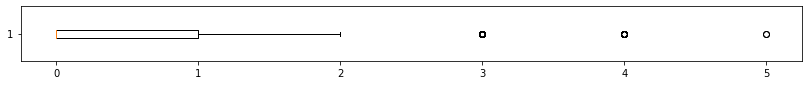

496-1268
MAE for Naive Method :  0.4020496315744897
RMSE for Naive Method:  0.7416855127663935


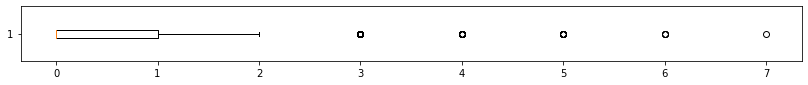

497-1252
MAE for Naive Method :  0.5243499618870162
RMSE for Naive Method:  0.8874590902264802


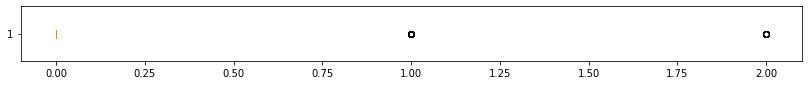

497-1253
MAE for Naive Method :  0.16735834674345726
RMSE for Naive Method:  0.4130094145277124


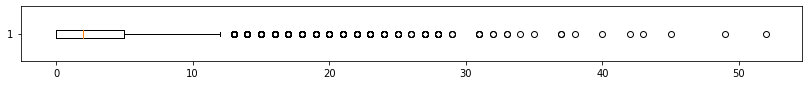

497-1254
MAE for Naive Method :  3.5408655882103837
RMSE for Naive Method:  5.647511371130656


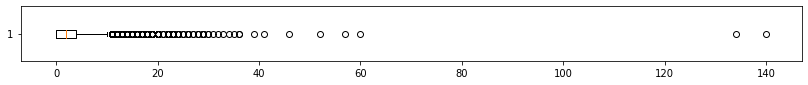

497-1255
MAE for Naive Method :  3.1016346235284153
RMSE for Naive Method:  5.282411436573835


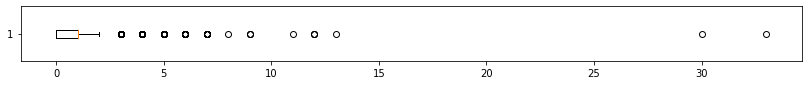

497-1256
MAE for Naive Method :  0.7819937325315491
RMSE for Naive Method:  1.3544077152646061


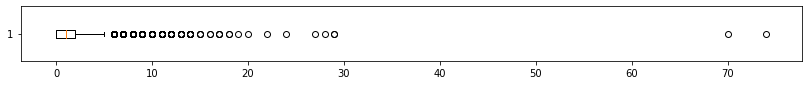

497-1257
MAE for Naive Method :  1.6467349877191497
RMSE for Naive Method:  2.8031760955351746


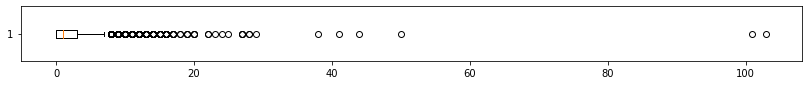

497-1258
MAE for Naive Method :  1.9647666638434826
RMSE for Naive Method:  3.4909409799098374


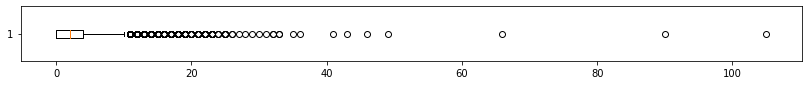

497-1259
MAE for Naive Method :  3.1095960023714744
RMSE for Naive Method:  5.055690534006366


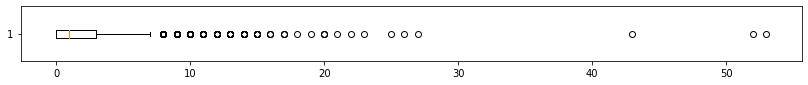

497-1260
MAE for Naive Method :  2.0107563309900907
RMSE for Naive Method:  3.1776006295614376


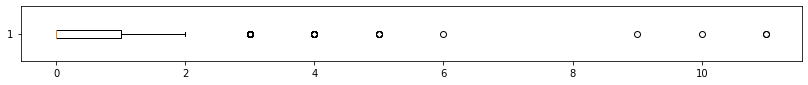

497-1261
MAE for Naive Method :  0.46150588633861267
RMSE for Naive Method:  0.8132572241370887


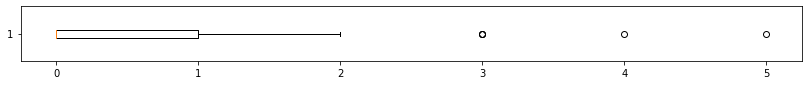

497-1262
MAE for Naive Method :  0.2678072329973744
RMSE for Naive Method:  0.5388285824015276


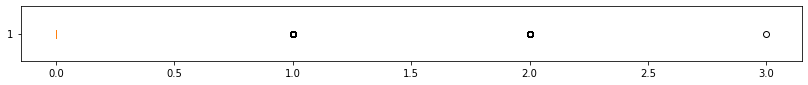

497-1263
MAE for Naive Method :  0.21478783772338444
RMSE for Naive Method:  0.4757167522696023


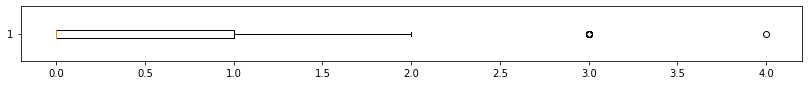

497-1264
MAE for Naive Method :  0.2733971372914373
RMSE for Naive Method:  0.551720669784633


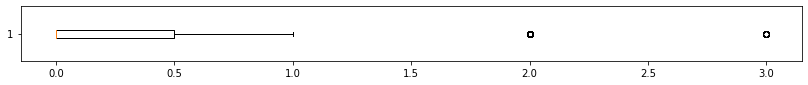

497-1265
MAE for Naive Method :  0.2615397645464555
RMSE for Naive Method:  0.5356756671985011


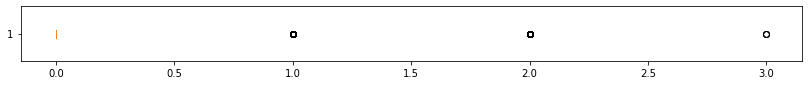

497-1266
MAE for Naive Method :  0.22622173287033115
RMSE for Naive Method:  0.49397144855528224


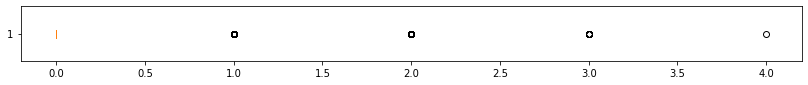

497-1267
MAE for Naive Method :  0.24341492335055476
RMSE for Naive Method:  0.5171735210922408


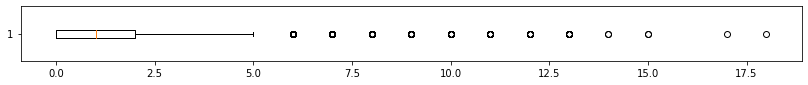

497-1268
MAE for Naive Method :  1.337511645633946
RMSE for Naive Method:  2.1946831662112


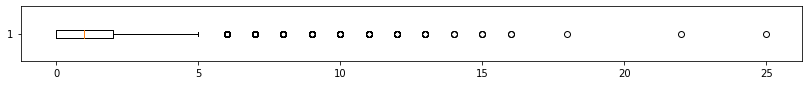

498-1252
MAE for Naive Method :  1.4605742356229356
RMSE for Naive Method:  2.357355961236005


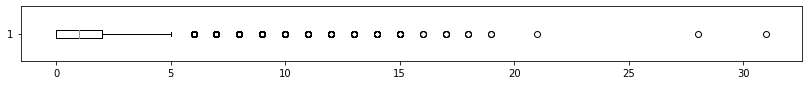

498-1253
MAE for Naive Method :  1.7585330736004066
RMSE for Naive Method:  2.861368760731535


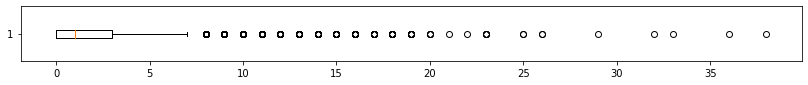

498-1254
MAE for Naive Method :  2.262386719742526
RMSE for Naive Method:  3.684334447149872


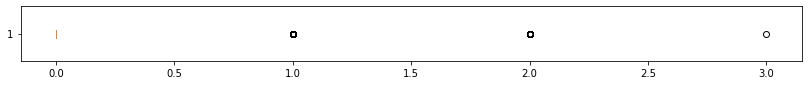

498-1255
MAE for Naive Method :  0.185313796900144
RMSE for Naive Method:  0.4398233358775057


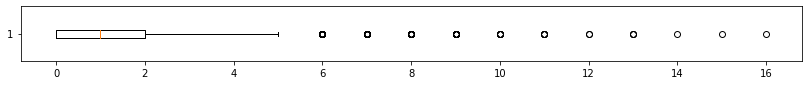

498-1256
MAE for Naive Method :  1.0929956805285
RMSE for Naive Method:  1.8300587235988102


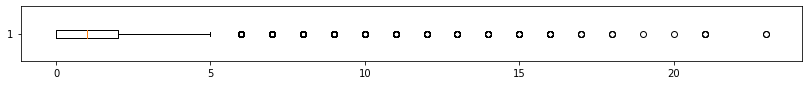

498-1257
MAE for Naive Method :  1.768188362835606
RMSE for Naive Method:  2.899651413178312


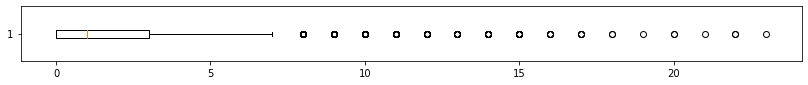

498-1258
MAE for Naive Method :  1.7843652070805454
RMSE for Naive Method:  2.904656413618001


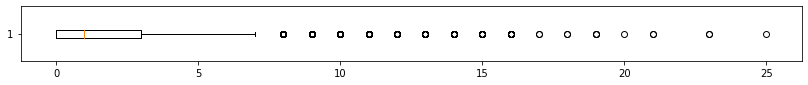

498-1259
MAE for Naive Method :  2.005251122215635
RMSE for Naive Method:  3.253653698032374


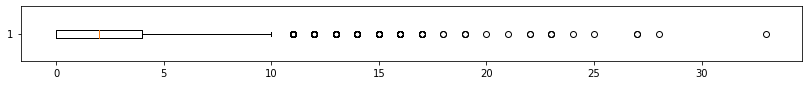

498-1260
MAE for Naive Method :  2.442110612348607
RMSE for Naive Method:  3.822366453563466


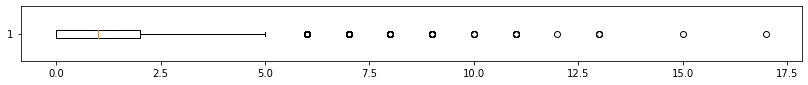

498-1261
MAE for Naive Method :  1.2438384009485899
RMSE for Naive Method:  1.981364864133877


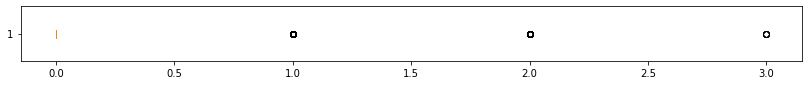

498-1262
MAE for Naive Method :  0.2211400016939104
RMSE for Naive Method:  0.4861946063287546


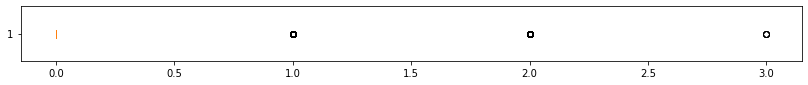

498-1263
MAE for Naive Method :  0.2377403235368849
RMSE for Naive Method:  0.5065004727437495


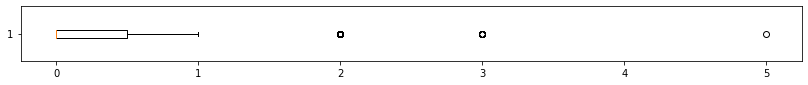

498-1264
MAE for Naive Method :  0.26314897941898874
RMSE for Naive Method:  0.5406331826329208


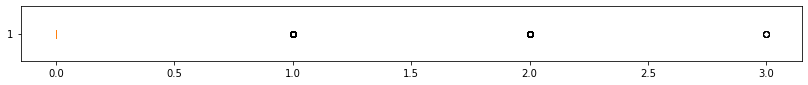

498-1265
MAE for Naive Method :  0.2191920047429491
RMSE for Naive Method:  0.48541006947395476


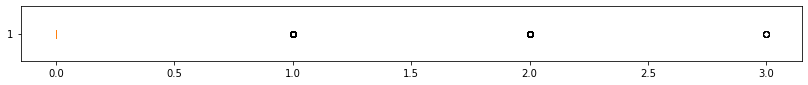

498-1266
MAE for Naive Method :  0.23206572372321504
RMSE for Naive Method:  0.499512763362719


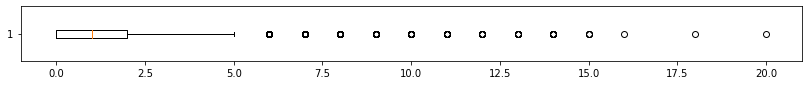

498-1267
MAE for Naive Method :  1.470483611416956
RMSE for Naive Method:  2.382568468300633


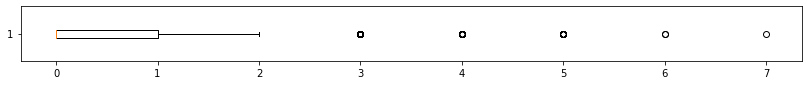

498-1268
MAE for Naive Method :  0.4948759210637757
RMSE for Naive Method:  0.8728322856454612


In [6]:
dict2naive = {}
for i, k in agg_by_cell:
    cell_i = i
    l = list(k['nr_people'].shift(1))
    k['nr_people_t1'] = l
    serie_naive = k[['nr_people','nr_people_t1']][1:]
    
    expected = serie_naive['nr_people'].values
    prediction = serie_naive['nr_people_t1'].values
   
    error_mae = abs(expected - prediction)
    
    # collect data 2 dictionary
    minimum = np.amin(error_mae)   
    per75 = np.percentile(error_mae, 75)
    per50 = np.percentile(error_mae, 50)
    per25 = np.percentile(error_mae, 25)
    maximum = np.amax(error_mae)
    l5i = [minimum, per25, per50, per75, maximum]
    dict2naive[cell_i] = l5i
    
    plt.figure(figsize = (14, 1))
    plt.boxplot(error_mae, vert=False)
    plt.show()
    print(cell_i)
    print ('MAE for Naive Method : ', np.mean(error_mae))
    error = sqrt(metrics.mean_squared_error(expected,prediction))
    # Root mean squared error: RMSE
    print ('RMSE for Naive Method: ', error)
    

### Scrivi dati su file

In [7]:
with open('error_data_4_ValorePrevisto-ValorePrecedente.csv', 'w') as f:
    for key, value in dict2naive.items():
        f.write('%s:%s\n' % (key, value))

### Calcolo prevedibilita per ogni giorno della settimana
<p>Il calcolo qui sotto prende in considerazione l'osservazione fatta in una certa ora e giorno della settimana e fa la media. Poi usa la media per fare previsione. Infine calcola l'errore per ogni ora e ogni giorno della settimana. </p>


72
Error for day Monday, Hour  0.0
Mean Absolute Error =  24.62692901234568


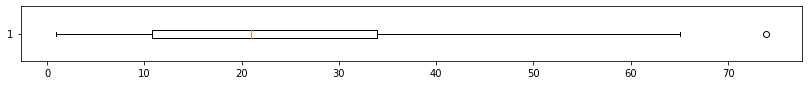

72
Error for day Monday, Hour  1.0
Mean Absolute Error =  20.037037037037035


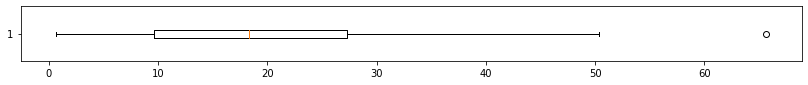

72
Error for day Monday, Hour  2.0
Mean Absolute Error =  16.549382716049383


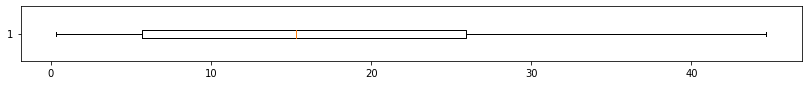

72
Error for day Monday, Hour  3.0
Mean Absolute Error =  15.248456790123457


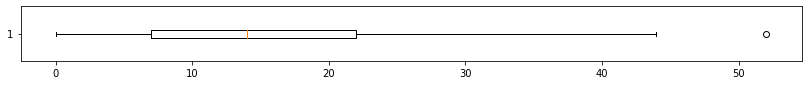

72
Error for day Monday, Hour  4.0
Mean Absolute Error =  13.061728395061728


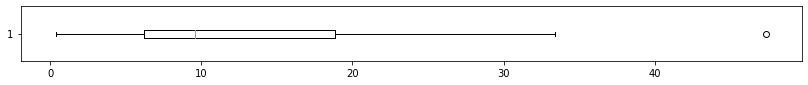

72
Error for day Monday, Hour  5.0
Mean Absolute Error =  14.046296296296292


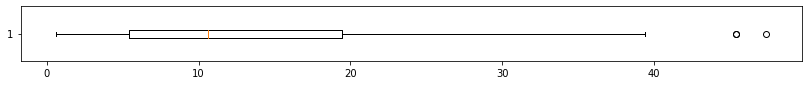

72
Error for day Monday, Hour  6.0
Mean Absolute Error =  17.678240740740744


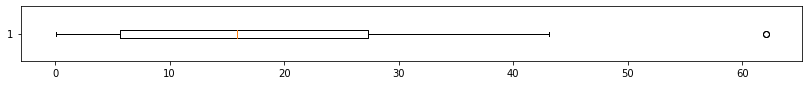

72
Error for day Monday, Hour  7.0
Mean Absolute Error =  16.470679012345677


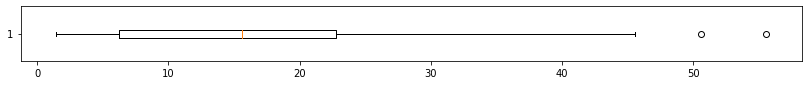

72
Error for day Monday, Hour  8.0
Mean Absolute Error =  20.34027777777778


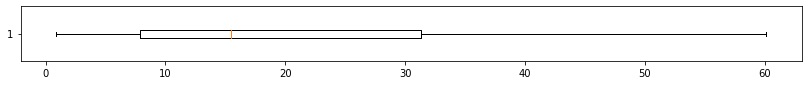

72
Error for day Monday, Hour  9.0
Mean Absolute Error =  30.958333333333332


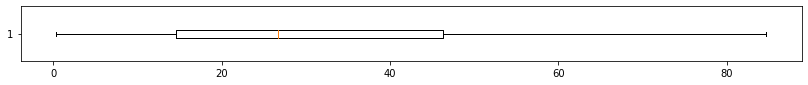

72
Error for day Monday, Hour  10.0
Mean Absolute Error =  32.85030864197531


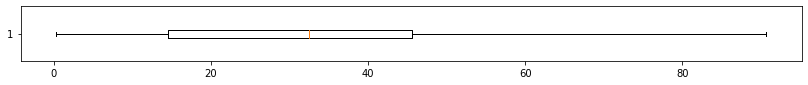

72
Error for day Monday, Hour  11.0
Mean Absolute Error =  26.75


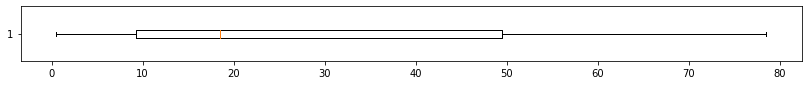

72
Error for day Monday, Hour  12.0
Mean Absolute Error =  31.0


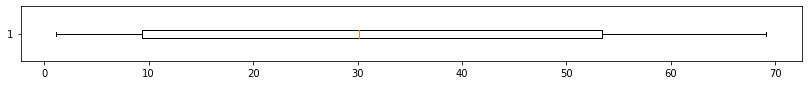

72
Error for day Monday, Hour  13.0
Mean Absolute Error =  36.15277777777778


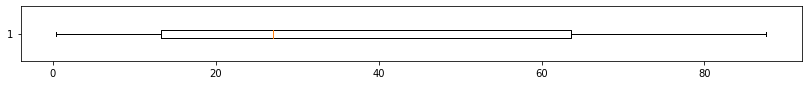

72
Error for day Monday, Hour  14.0
Mean Absolute Error =  35.762731481481495


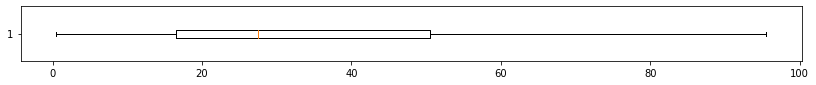

72
Error for day Monday, Hour  15.0
Mean Absolute Error =  37.54629629629629


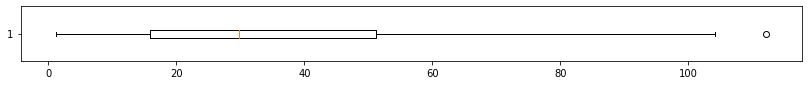

72
Error for day Monday, Hour  16.0
Mean Absolute Error =  34.74228395061727


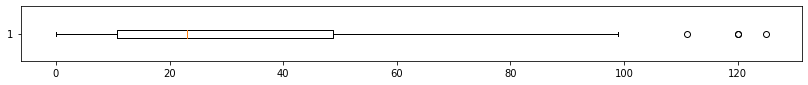

72
Error for day Monday, Hour  17.0
Mean Absolute Error =  36.05401234567901


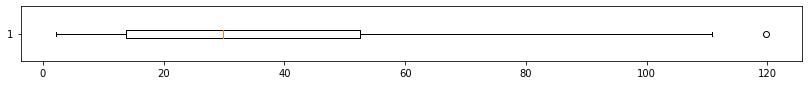

72
Error for day Monday, Hour  18.0
Mean Absolute Error =  35.00192901234566


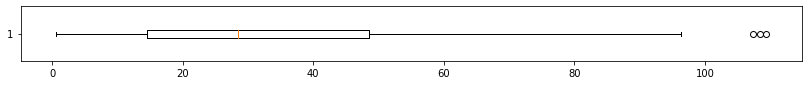

72
Error for day Monday, Hour  19.0
Mean Absolute Error =  29.646604938271594


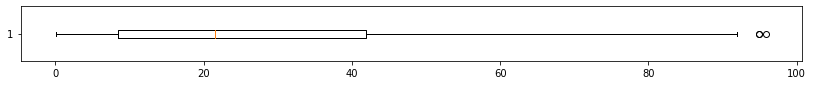

72
Error for day Monday, Hour  20.0
Mean Absolute Error =  26.826003086419757


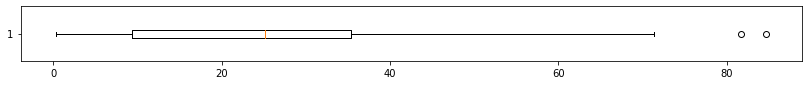

72
Error for day Monday, Hour  21.0
Mean Absolute Error =  24.459490740740744


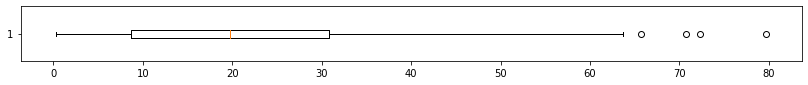

72
Error for day Monday, Hour  22.0
Mean Absolute Error =  23.399305555555557


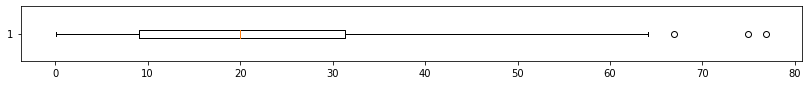

72
Error for day Monday, Hour  23.0
Mean Absolute Error =  22.63194444444444


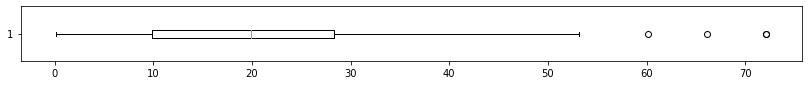

72
Error for day Tuesday, Hour  0.0
Mean Absolute Error =  31.05478395061728


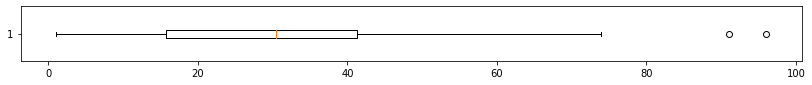

72
Error for day Tuesday, Hour  1.0
Mean Absolute Error =  23.363425925925924


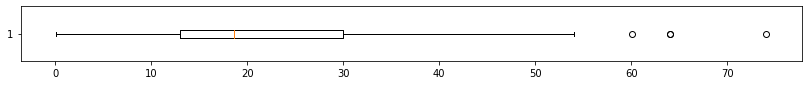

72
Error for day Tuesday, Hour  2.0
Mean Absolute Error =  20.78125


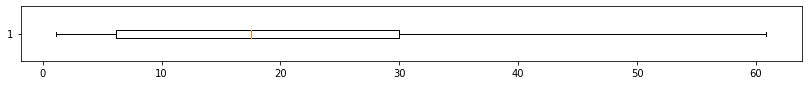

72
Error for day Tuesday, Hour  3.0
Mean Absolute Error =  18.31442901234568


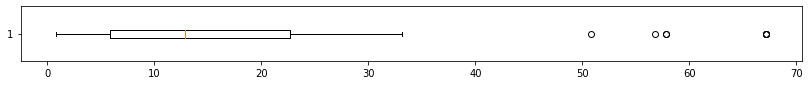

72
Error for day Tuesday, Hour  4.0
Mean Absolute Error =  16.29320987654321


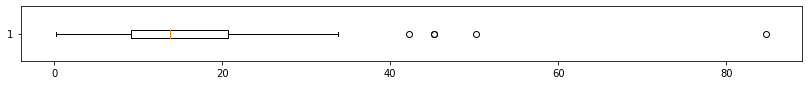

72
Error for day Tuesday, Hour  5.0
Mean Absolute Error =  16.48148148148148


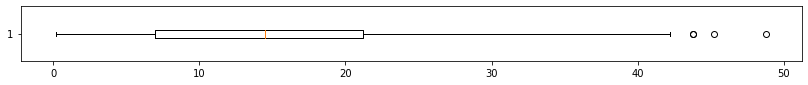

72
Error for day Tuesday, Hour  6.0
Mean Absolute Error =  16.375771604938272


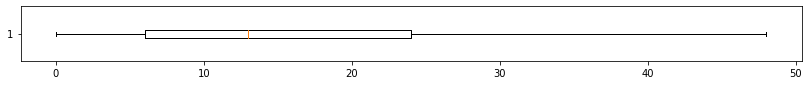

72
Error for day Tuesday, Hour  7.0
Mean Absolute Error =  15.031250000000004


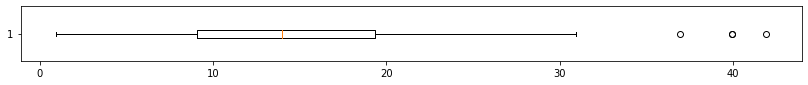

72
Error for day Tuesday, Hour  8.0
Mean Absolute Error =  22.069444444444443


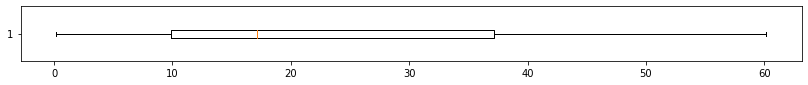

72
Error for day Tuesday, Hour  9.0
Mean Absolute Error =  23.13541666666666


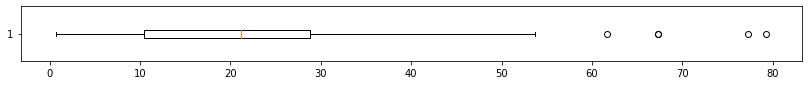

72
Error for day Tuesday, Hour  10.0
Mean Absolute Error =  26.51929012345679


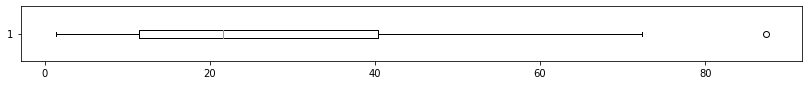

72
Error for day Tuesday, Hour  11.0
Mean Absolute Error =  26.053240740740748


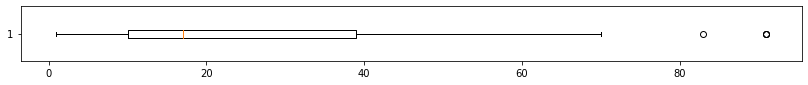

72
Error for day Tuesday, Hour  12.0
Mean Absolute Error =  27.119598765432087


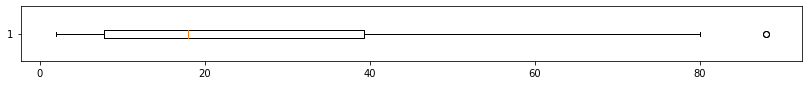

72
Error for day Tuesday, Hour  13.0
Mean Absolute Error =  30.45370370370371


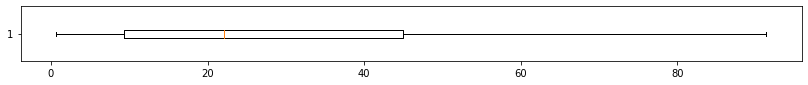

72
Error for day Tuesday, Hour  14.0
Mean Absolute Error =  33.206018518518526


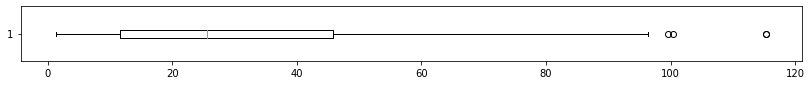

72
Error for day Tuesday, Hour  15.0
Mean Absolute Error =  31.123456790123456


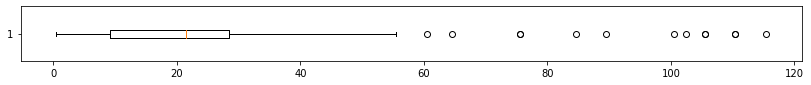

72
Error for day Tuesday, Hour  16.0
Mean Absolute Error =  33.29166666666666


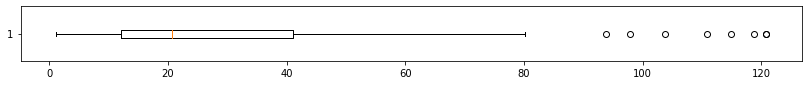

72
Error for day Tuesday, Hour  17.0
Mean Absolute Error =  30.842592592592585


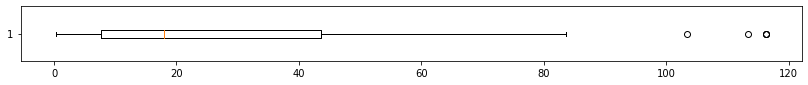

72
Error for day Tuesday, Hour  18.0
Mean Absolute Error =  29.149305555555557


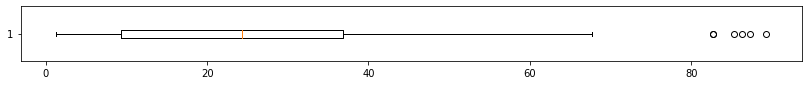

72
Error for day Tuesday, Hour  19.0
Mean Absolute Error =  29.997685185185187


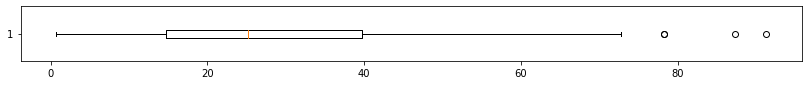

72
Error for day Tuesday, Hour  20.0
Mean Absolute Error =  34.59722222222222


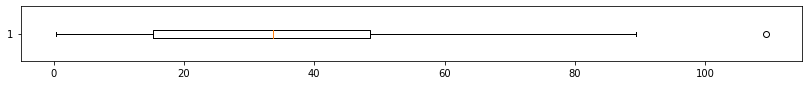

72
Error for day Tuesday, Hour  21.0
Mean Absolute Error =  30.214120370370374


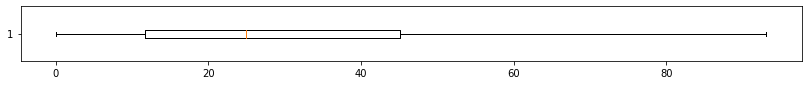

72
Error for day Tuesday, Hour  22.0
Mean Absolute Error =  27.391975308641975


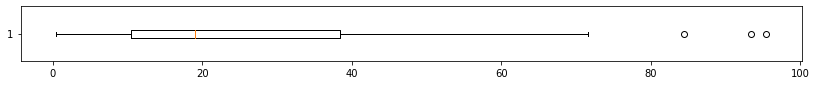

72
Error for day Tuesday, Hour  23.0
Mean Absolute Error =  29.089120370370374


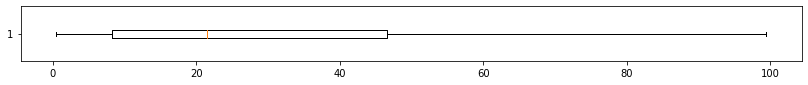

72
Error for day Wednesday, Hour  0.0
Mean Absolute Error =  26.46604938271605


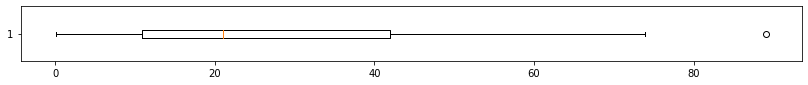

72
Error for day Wednesday, Hour  1.0
Mean Absolute Error =  24.633101851851855


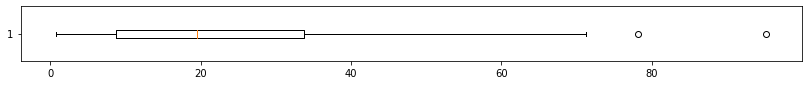

72
Error for day Wednesday, Hour  2.0
Mean Absolute Error =  22.22993827160494


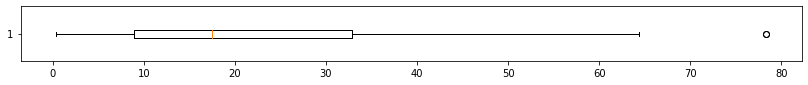

72
Error for day Wednesday, Hour  3.0
Mean Absolute Error =  20.377314814814817


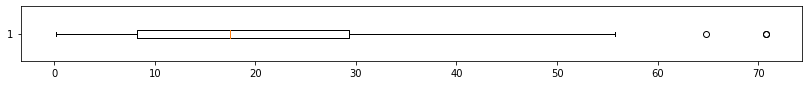

72
Error for day Wednesday, Hour  4.0
Mean Absolute Error =  19.744598765432098


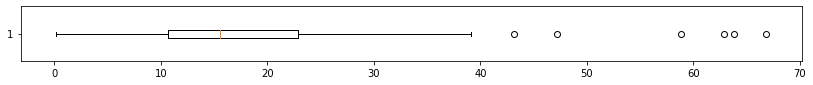

72
Error for day Wednesday, Hour  5.0
Mean Absolute Error =  19.489583333333332


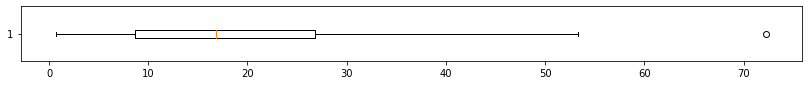

72
Error for day Wednesday, Hour  6.0
Mean Absolute Error =  17.859953703703702


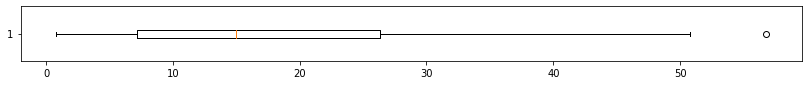

72
Error for day Wednesday, Hour  7.0
Mean Absolute Error =  18.160493827160494


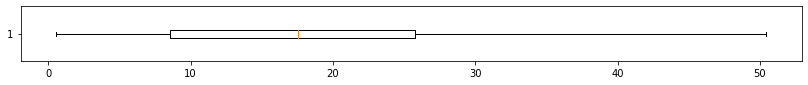

72
Error for day Wednesday, Hour  8.0
Mean Absolute Error =  19.47067901234568


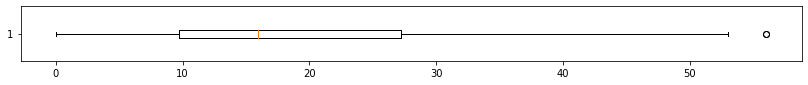

72
Error for day Wednesday, Hour  9.0
Mean Absolute Error =  24.477237654320987


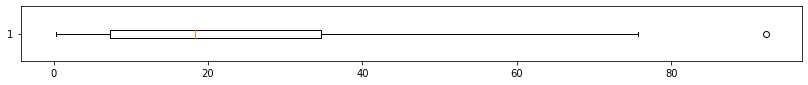

72
Error for day Wednesday, Hour  10.0
Mean Absolute Error =  31.481867283950617


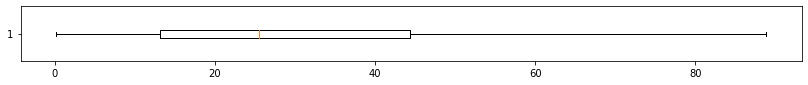

72
Error for day Wednesday, Hour  11.0
Mean Absolute Error =  25.704475308641975


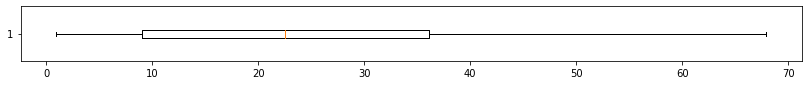

72
Error for day Wednesday, Hour  12.0
Mean Absolute Error =  21.483796296296294


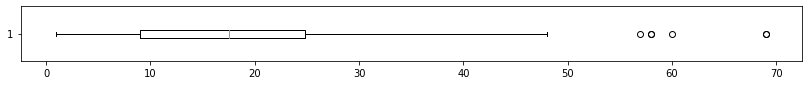

72
Error for day Wednesday, Hour  13.0
Mean Absolute Error =  25.864583333333332


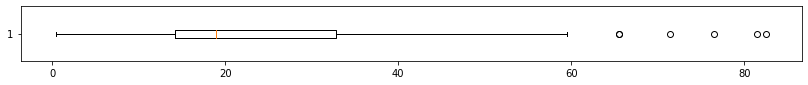

72
Error for day Wednesday, Hour  14.0
Mean Absolute Error =  25.36226851851852


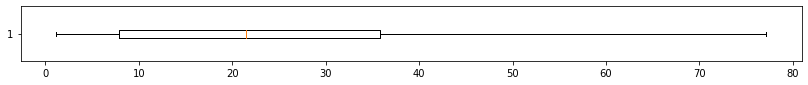

72
Error for day Wednesday, Hour  15.0
Mean Absolute Error =  26.21875


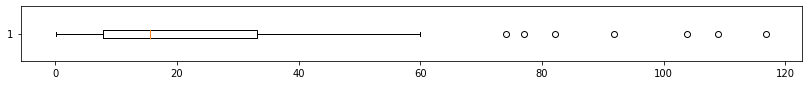

72
Error for day Wednesday, Hour  16.0
Mean Absolute Error =  30.694444444444443


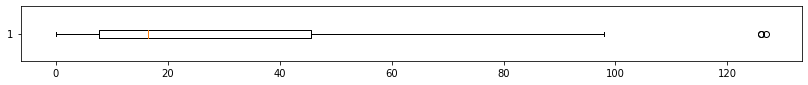

72
Error for day Wednesday, Hour  17.0
Mean Absolute Error =  27.365740740740744


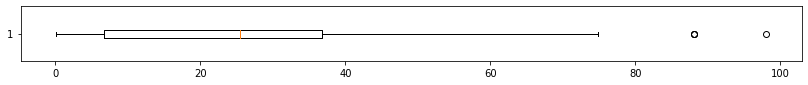

72
Error for day Wednesday, Hour  18.0
Mean Absolute Error =  27.481481481481485


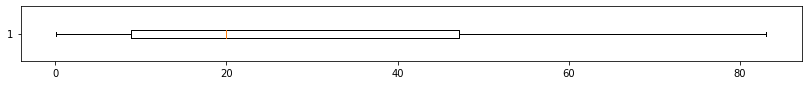

72
Error for day Wednesday, Hour  19.0
Mean Absolute Error =  23.25


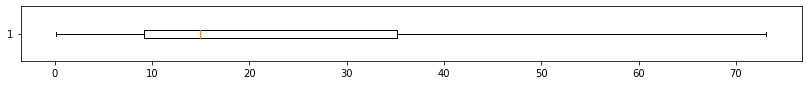

72
Error for day Wednesday, Hour  20.0
Mean Absolute Error =  26.05246913580247


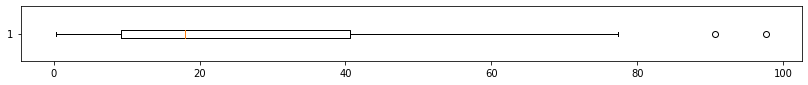

72
Error for day Wednesday, Hour  21.0
Mean Absolute Error =  21.48726851851852


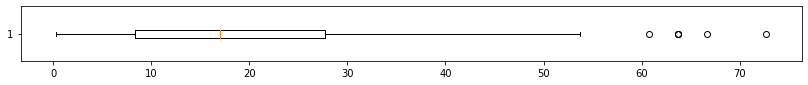

72
Error for day Wednesday, Hour  22.0
Mean Absolute Error =  20.602237654320984


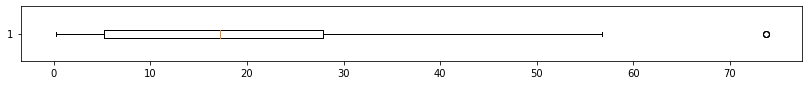

72
Error for day Wednesday, Hour  23.0
Mean Absolute Error =  19.719907407407405


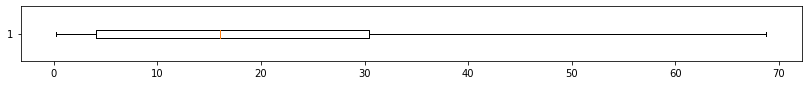

68
Error for day Thursday, Hour  0.0
Mean Absolute Error =  19.159169550173004


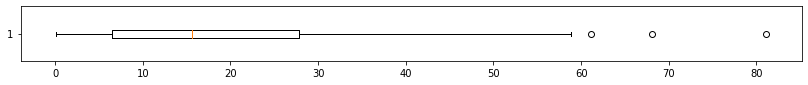

68
Error for day Thursday, Hour  1.0
Mean Absolute Error =  15.773788927335643


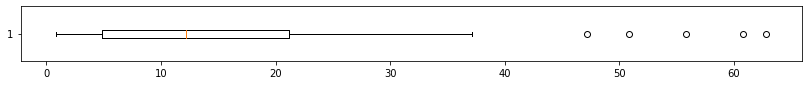

68
Error for day Thursday, Hour  2.0
Mean Absolute Error =  13.471885813148791


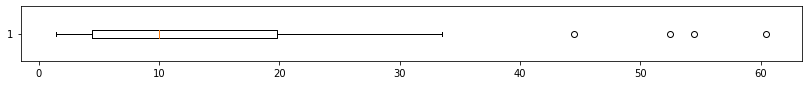

68
Error for day Thursday, Hour  3.0
Mean Absolute Error =  16.77162629757786


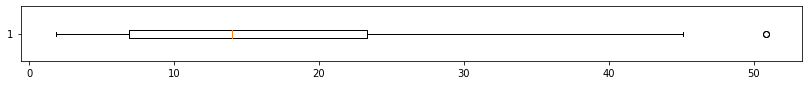

68
Error for day Thursday, Hour  4.0
Mean Absolute Error =  13.764705882352938


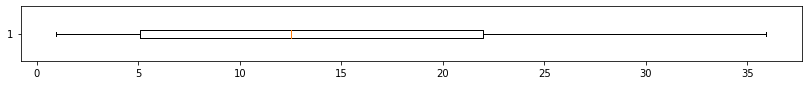

68
Error for day Thursday, Hour  5.0
Mean Absolute Error =  14.839532871972317


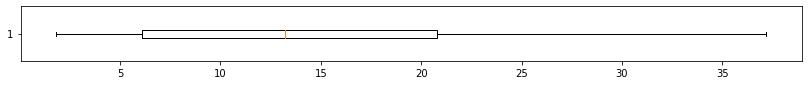

68
Error for day Thursday, Hour  6.0
Mean Absolute Error =  11.955882352941174


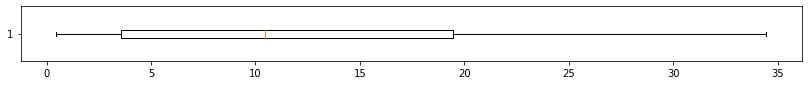

68
Error for day Thursday, Hour  7.0
Mean Absolute Error =  10.570934256055367


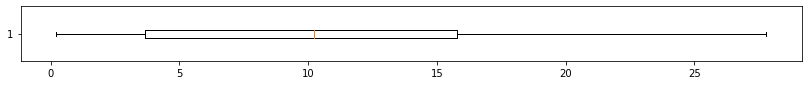

68
Error for day Thursday, Hour  8.0
Mean Absolute Error =  13.837370242214533


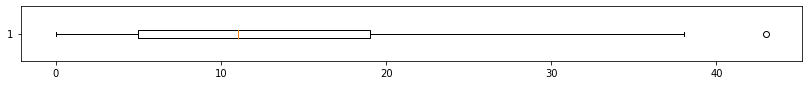

68
Error for day Thursday, Hour  9.0
Mean Absolute Error =  18.03806228373703


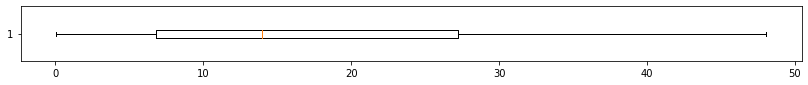

68
Error for day Thursday, Hour  10.0
Mean Absolute Error =  23.648788927335644


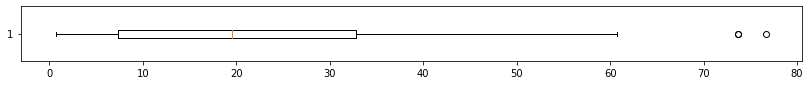

68
Error for day Thursday, Hour  11.0
Mean Absolute Error =  23.299307958477502


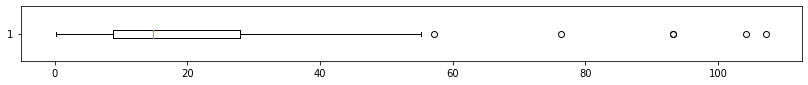

68
Error for day Thursday, Hour  12.0
Mean Absolute Error =  26.410034602076134


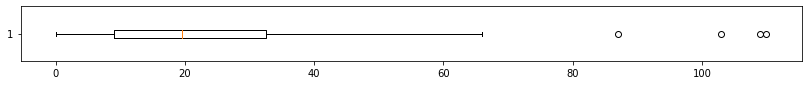

68
Error for day Thursday, Hour  13.0
Mean Absolute Error =  31.744377162629764


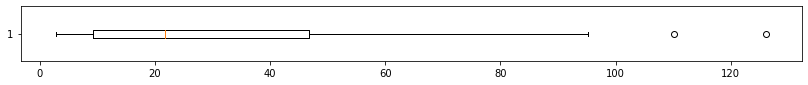

68
Error for day Thursday, Hour  14.0
Mean Absolute Error =  31.972318339100344


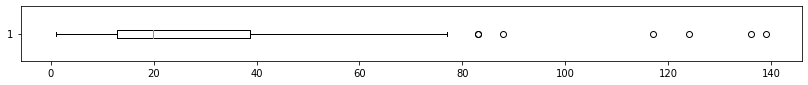

68
Error for day Thursday, Hour  15.0
Mean Absolute Error =  30.736159169550174


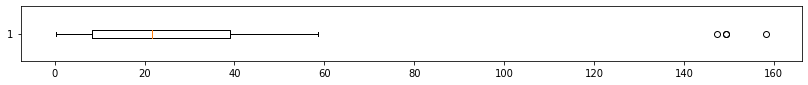

68
Error for day Thursday, Hour  16.0
Mean Absolute Error =  29.13148788927335


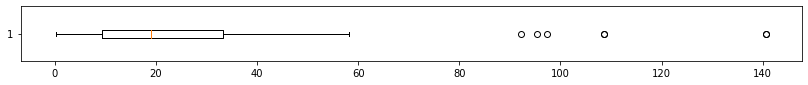

68
Error for day Thursday, Hour  17.0
Mean Absolute Error =  24.59342560553633


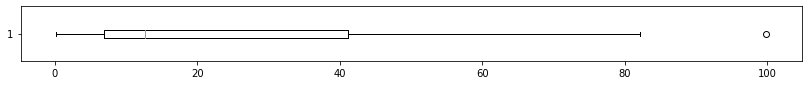

68
Error for day Thursday, Hour  18.0
Mean Absolute Error =  21.655709342560545


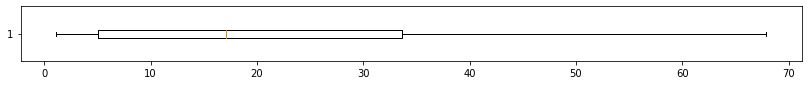

68
Error for day Thursday, Hour  19.0
Mean Absolute Error =  27.674740484429066


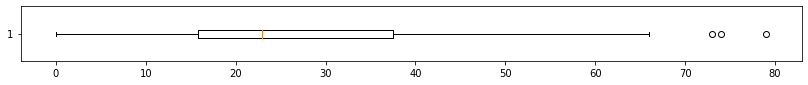

68
Error for day Thursday, Hour  20.0
Mean Absolute Error =  26.83823529411765


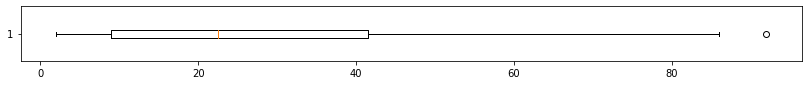

68
Error for day Thursday, Hour  21.0
Mean Absolute Error =  21.764705882352942


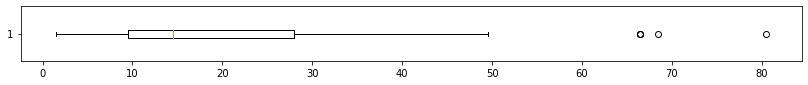

68
Error for day Thursday, Hour  22.0
Mean Absolute Error =  19.75475778546713


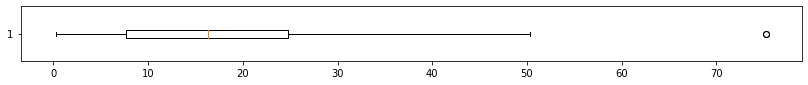

68
Error for day Thursday, Hour  23.0
Mean Absolute Error =  19.871107266435985


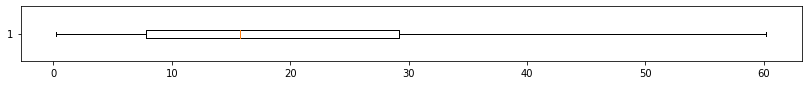

68
Error for day Friday, Hour  0.0
Mean Absolute Error =  26.403114186851205


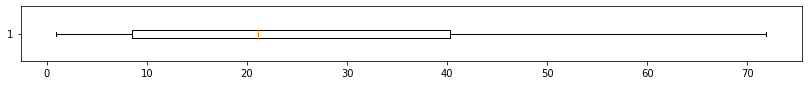

68
Error for day Friday, Hour  1.0
Mean Absolute Error =  19.28243944636678


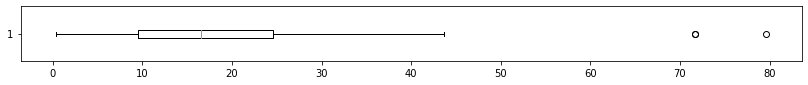

68
Error for day Friday, Hour  2.0
Mean Absolute Error =  19.066176470588236


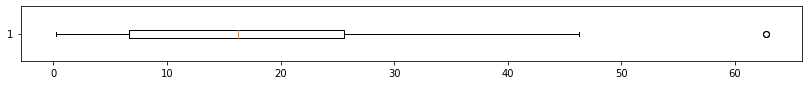

68
Error for day Friday, Hour  3.0
Mean Absolute Error =  18.736159169550177


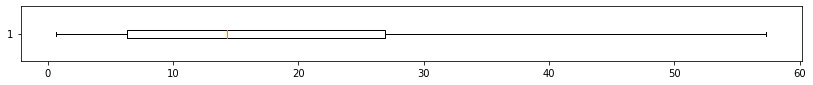

68
Error for day Friday, Hour  4.0
Mean Absolute Error =  17.80882352941176


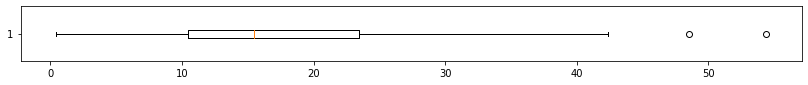

68
Error for day Friday, Hour  5.0
Mean Absolute Error =  16.970588235294116


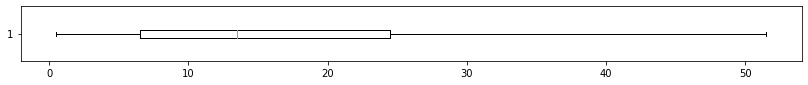

68
Error for day Friday, Hour  6.0
Mean Absolute Error =  16.409602076124568


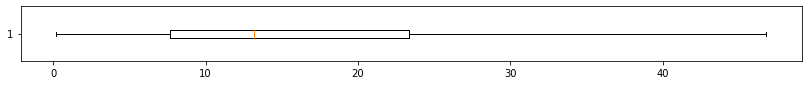

68
Error for day Friday, Hour  7.0
Mean Absolute Error =  15.961937716262977


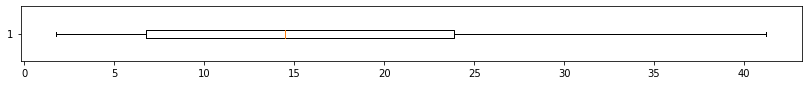

68
Error for day Friday, Hour  8.0
Mean Absolute Error =  15.760380622837367


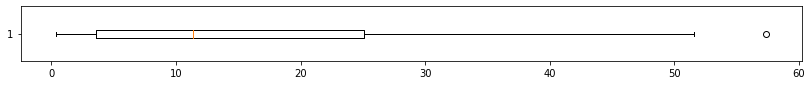

68
Error for day Friday, Hour  9.0
Mean Absolute Error =  29.035034602076127


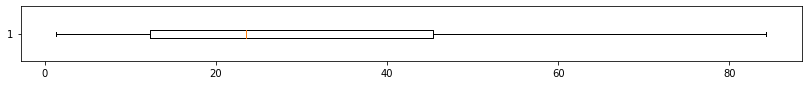

68
Error for day Friday, Hour  10.0
Mean Absolute Error =  32.396193771626294


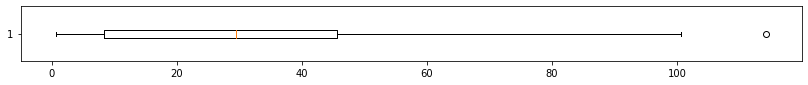

68
Error for day Friday, Hour  11.0
Mean Absolute Error =  33.113321799307954


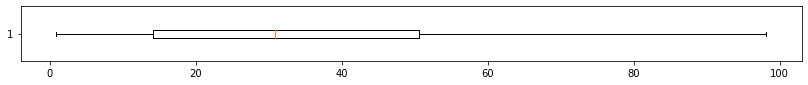

68
Error for day Friday, Hour  12.0
Mean Absolute Error =  23.47404844290658


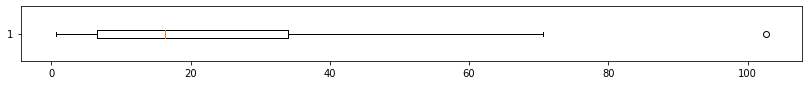

68
Error for day Friday, Hour  13.0
Mean Absolute Error =  22.64143598615917


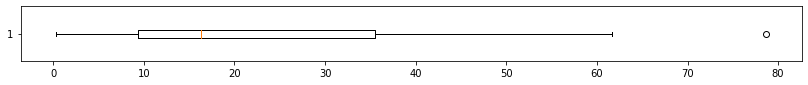

68
Error for day Friday, Hour  14.0
Mean Absolute Error =  24.484429065743953


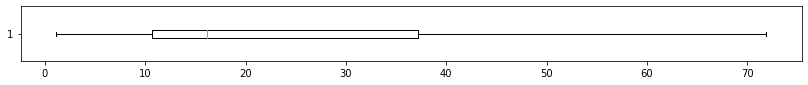

68
Error for day Friday, Hour  15.0
Mean Absolute Error =  23.61764705882353


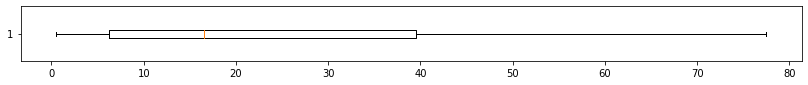

68
Error for day Friday, Hour  16.0
Mean Absolute Error =  24.26989619377163


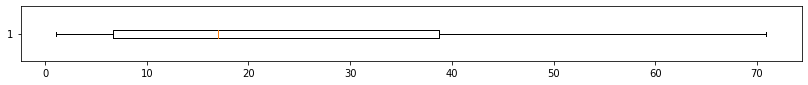

68
Error for day Friday, Hour  17.0
Mean Absolute Error =  27.588235294117652


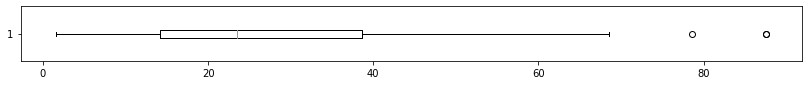

68
Error for day Friday, Hour  18.0
Mean Absolute Error =  29.668685121107266


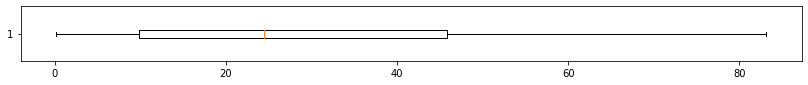

68
Error for day Friday, Hour  19.0
Mean Absolute Error =  28.202422145328722


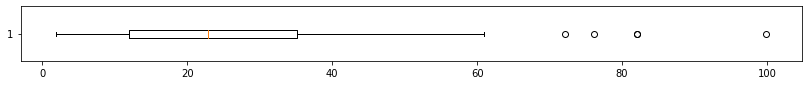

68
Error for day Friday, Hour  20.0
Mean Absolute Error =  29.897058823529413


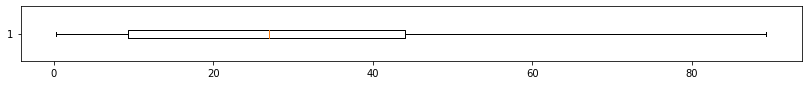

68
Error for day Friday, Hour  21.0
Mean Absolute Error =  23.777681660899656


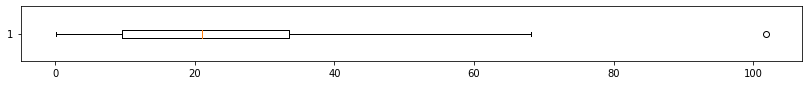

68
Error for day Friday, Hour  22.0
Mean Absolute Error =  23.61072664359862


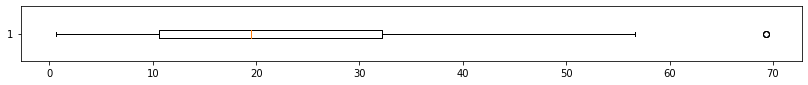

68
Error for day Friday, Hour  23.0
Mean Absolute Error =  21.98399653979239


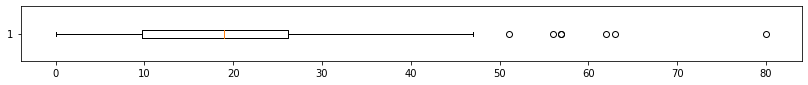

68
Error for day Saturday, Hour  0.0
Mean Absolute Error =  27.650519031141872


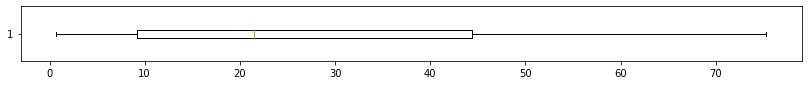

68
Error for day Saturday, Hour  1.0
Mean Absolute Error =  22.777681660899656


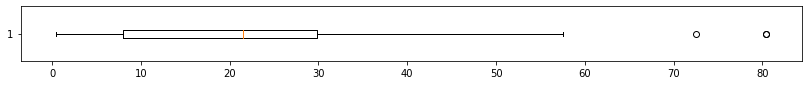

68
Error for day Saturday, Hour  2.0
Mean Absolute Error =  24.619377162629757


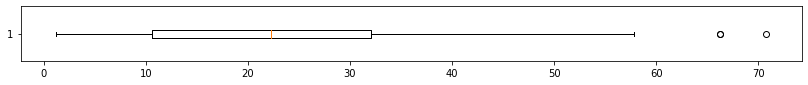

68
Error for day Saturday, Hour  3.0
Mean Absolute Error =  22.315311418685123


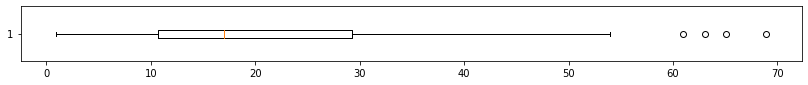

68
Error for day Saturday, Hour  4.0
Mean Absolute Error =  19.665224913494807


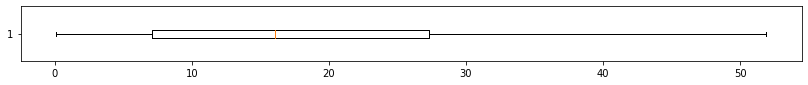

68
Error for day Saturday, Hour  5.0
Mean Absolute Error =  20.204152249134943


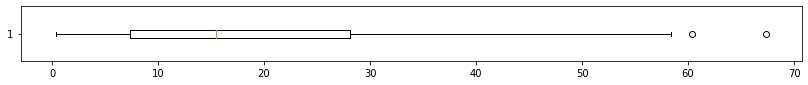

68
Error for day Saturday, Hour  6.0
Mean Absolute Error =  20.826124567474047


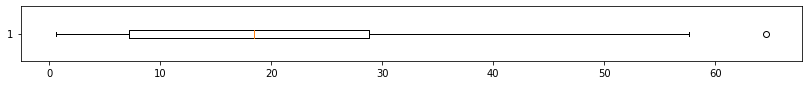

68
Error for day Saturday, Hour  7.0
Mean Absolute Error =  14.727508650519026


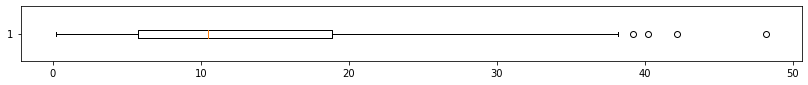

68
Error for day Saturday, Hour  8.0
Mean Absolute Error =  17.625432525951556


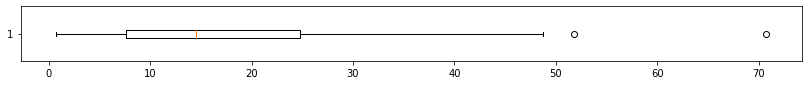

68
Error for day Saturday, Hour  9.0
Mean Absolute Error =  19.05276816608996


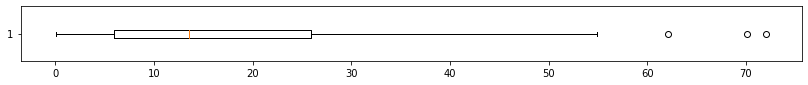

68
Error for day Saturday, Hour  10.0
Mean Absolute Error =  21.358131487889274


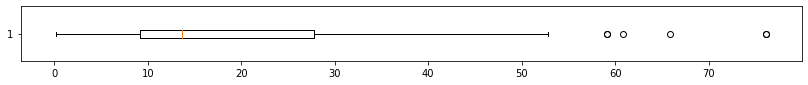

68
Error for day Saturday, Hour  11.0
Mean Absolute Error =  22.31833910034602


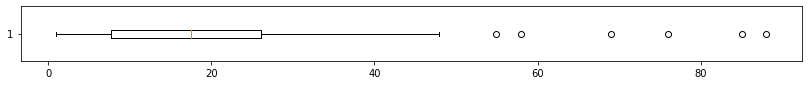

68
Error for day Saturday, Hour  12.0
Mean Absolute Error =  29.019031141868513


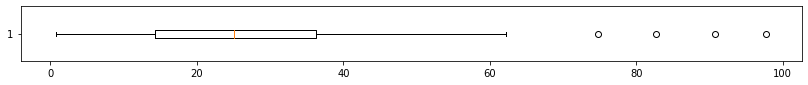

68
Error for day Saturday, Hour  13.0
Mean Absolute Error =  29.33650519031142


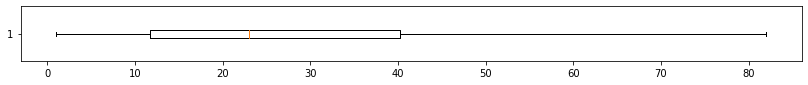

68
Error for day Saturday, Hour  14.0
Mean Absolute Error =  36.82698961937716


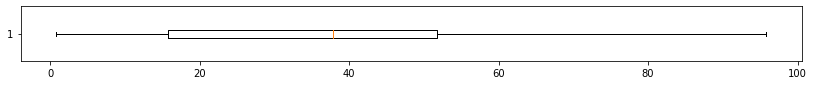

68
Error for day Saturday, Hour  15.0
Mean Absolute Error =  30.420415224913487


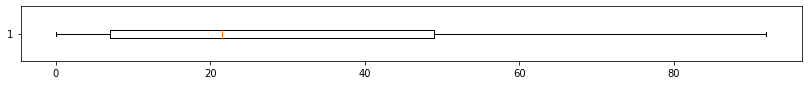

68
Error for day Saturday, Hour  16.0
Mean Absolute Error =  31.300173010380632


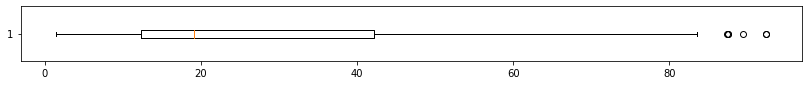

68
Error for day Saturday, Hour  17.0
Mean Absolute Error =  33.45025951557095


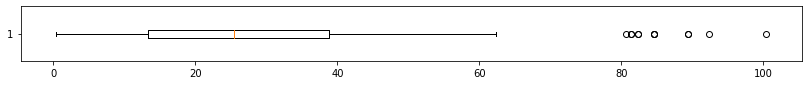

68
Error for day Saturday, Hour  18.0
Mean Absolute Error =  35.54152249134948


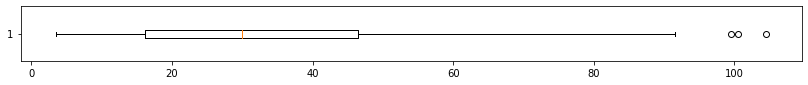

68
Error for day Saturday, Hour  19.0
Mean Absolute Error =  27.91782006920416


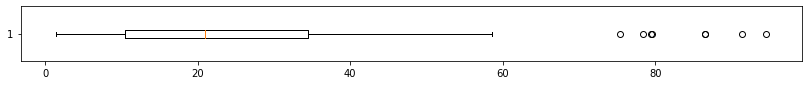

68
Error for day Saturday, Hour  20.0
Mean Absolute Error =  22.926470588235293


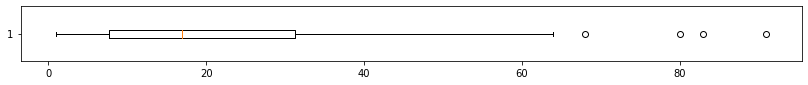

68
Error for day Saturday, Hour  21.0
Mean Absolute Error =  22.801903114186857


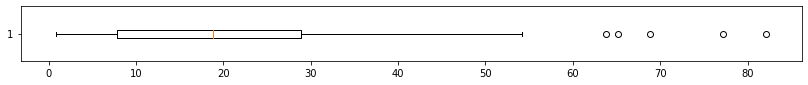

68
Error for day Saturday, Hour  22.0
Mean Absolute Error =  22.062283737024217


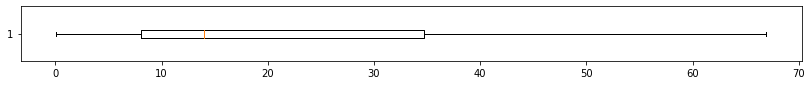

68
Error for day Saturday, Hour  23.0
Mean Absolute Error =  22.500000000000004


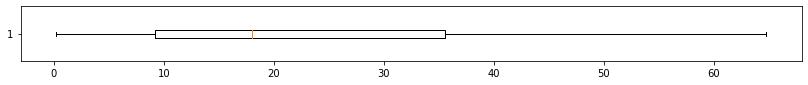

72
Error for day Sunday, Hour  0.0
Mean Absolute Error =  24.461805555555557


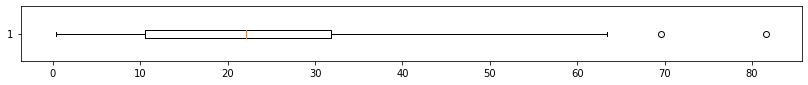

72
Error for day Sunday, Hour  1.0
Mean Absolute Error =  19.044753086419753


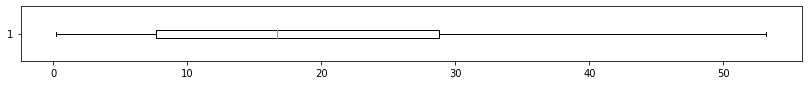

72
Error for day Sunday, Hour  2.0
Mean Absolute Error =  13.984182098765432


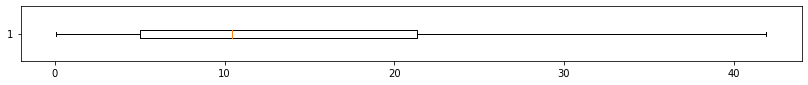

72
Error for day Sunday, Hour  3.0
Mean Absolute Error =  15.774691358024691


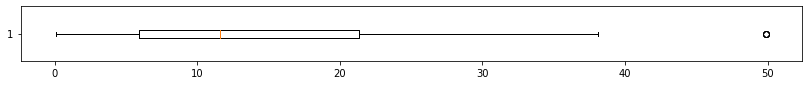

72
Error for day Sunday, Hour  4.0
Mean Absolute Error =  9.48611111111111


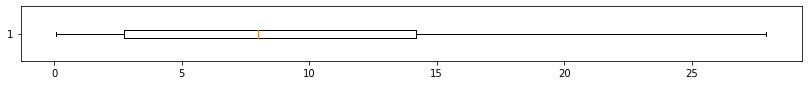

72
Error for day Sunday, Hour  5.0
Mean Absolute Error =  11.089506172839505


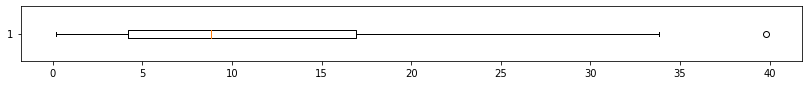

72
Error for day Sunday, Hour  6.0
Mean Absolute Error =  14.541666666666666


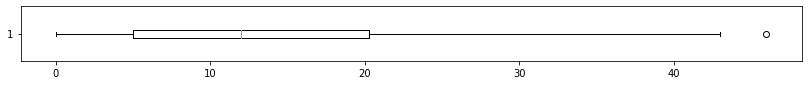

72
Error for day Sunday, Hour  7.0
Mean Absolute Error =  14.505787037037035


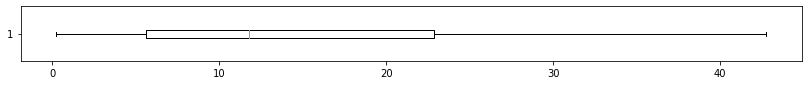

72
Error for day Sunday, Hour  8.0
Mean Absolute Error =  16.628858024691358


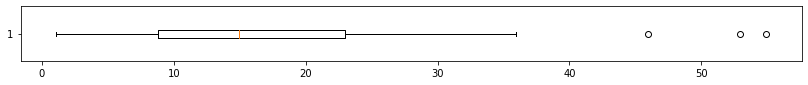

72
Error for day Sunday, Hour  9.0
Mean Absolute Error =  16.8179012345679


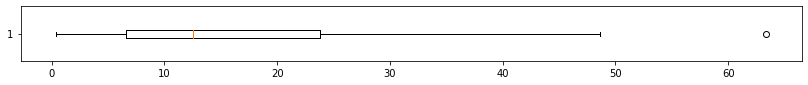

72
Error for day Sunday, Hour  10.0
Mean Absolute Error =  24.134645061728392


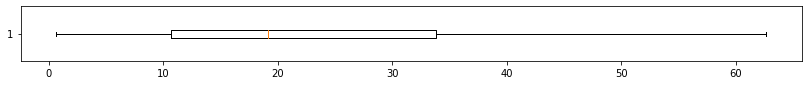

72
Error for day Sunday, Hour  11.0
Mean Absolute Error =  20.47762345679012


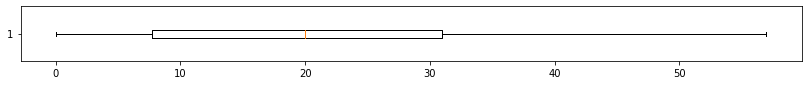

72
Error for day Sunday, Hour  12.0
Mean Absolute Error =  14.722222222222221


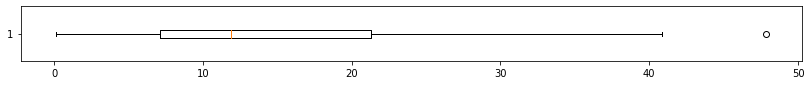

72
Error for day Sunday, Hour  13.0
Mean Absolute Error =  22.333333333333332


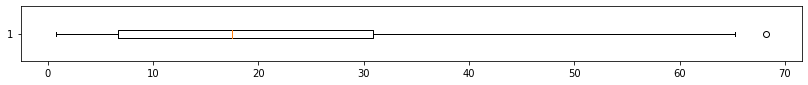

72
Error for day Sunday, Hour  14.0
Mean Absolute Error =  22.39351851851852


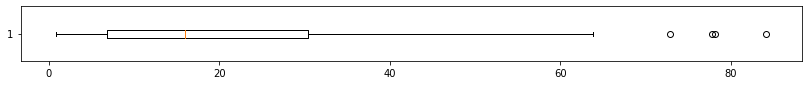

72
Error for day Sunday, Hour  15.0
Mean Absolute Error =  24.814814814814817


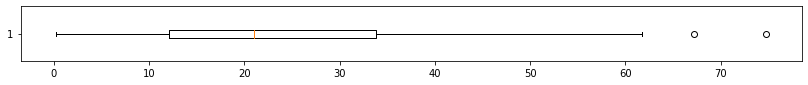

72
Error for day Sunday, Hour  16.0
Mean Absolute Error =  26.164351851851855


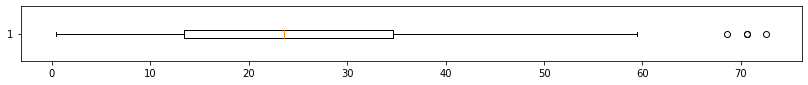

72
Error for day Sunday, Hour  17.0
Mean Absolute Error =  28.68055555555555


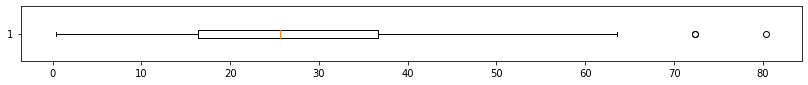

72
Error for day Sunday, Hour  18.0
Mean Absolute Error =  29.23263888888889


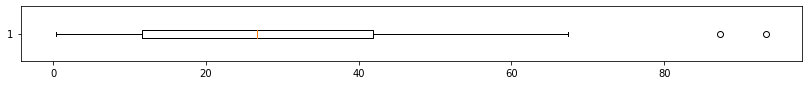

72
Error for day Sunday, Hour  19.0
Mean Absolute Error =  31.12654320987654


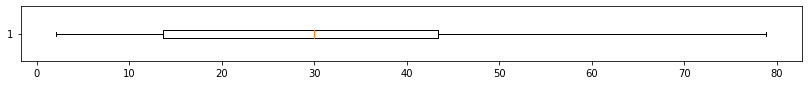

72
Error for day Sunday, Hour  20.0
Mean Absolute Error =  25.71875


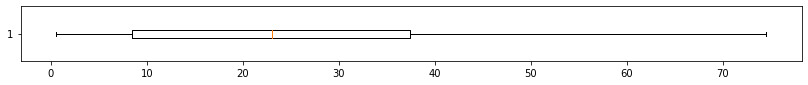

72
Error for day Sunday, Hour  21.0
Mean Absolute Error =  23.322145061728392


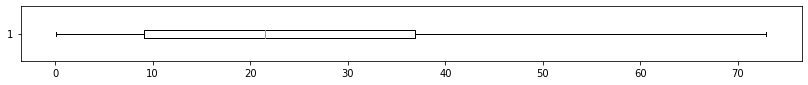

72
Error for day Sunday, Hour  22.0
Mean Absolute Error =  23.103009259259256


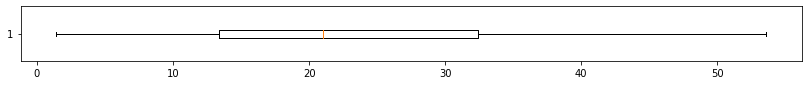

72
Error for day Sunday, Hour  23.0
Mean Absolute Error =  25.205246913580247


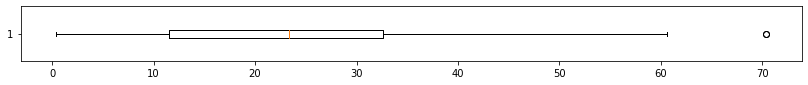

In [8]:
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
hours_of_day = [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 
                14.0, 15.0, 16.0, 17.0, 18.0,19.0, 20.0, 21.0, 22.0, 23.0]
#488-1258
for dow in days_of_week:
    for hod in hours_of_day:  
        value_day = []  
        for index, row in serie.iterrows():
        
            s = row['date'].split('-')
            year = int(s[0])
            month = int(s[1])
            day = int(s[2])
        
            dayofweek = datetime.date(year, month, day).strftime("%A")
            hour = row['hours']
            if (dayofweek == dow and hour == hod): 
                value_day.append(row['nr_people']) 
                
        # trasforma in numpy array
        value_day_array = np.array(value_day)
        print(len(value_day))
        # trova la media
        mean_day = value_day_array.mean()
        
        # fai la differenza tra i valori e la media 
        result = abs(value_day_array - mean_day)
        
        
        # show boxplot
        print('Error for day '+str(dow)+', Hour ',hod)
        print('Mean Absolute Error = ', np.mean(result))
       
    
        
        plt.figure(figsize = (14,1))
        plt.boxplot(result, vert= False);
        plt.show()    

### Previsione per tutte le celle usando la media dei valori di un particolare giorno e ora

72
Mean Absolute Error =  5.586805555555555
Cell -->  486-1252


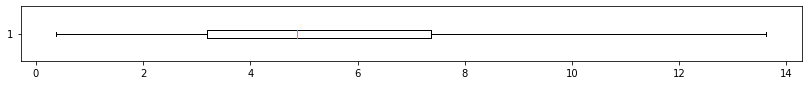

72
Mean Absolute Error =  6.152777777777778
Cell -->  486-1253


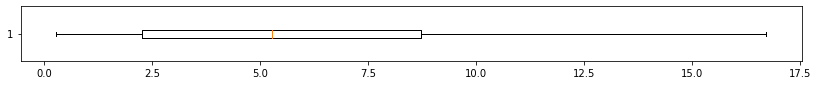

72
Mean Absolute Error =  6.403549382716048
Cell -->  486-1254


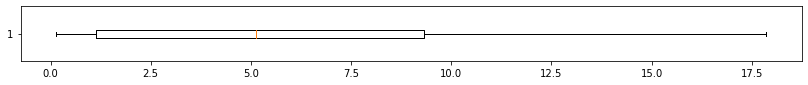

72
Mean Absolute Error =  6.586805555555555
Cell -->  486-1255


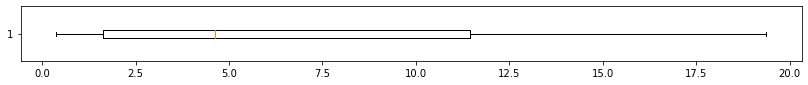

72
Mean Absolute Error =  6.668981481481483
Cell -->  486-1256


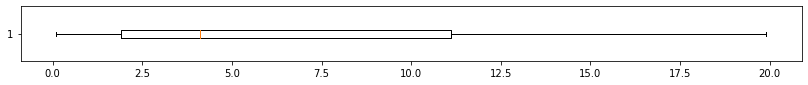

72
Mean Absolute Error =  5.170138888888889
Cell -->  486-1257


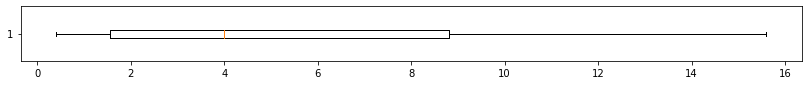

72
Mean Absolute Error =  5.421682098765432
Cell -->  486-1258


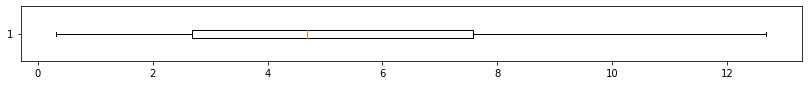

72
Mean Absolute Error =  5.352623456790123
Cell -->  486-1259


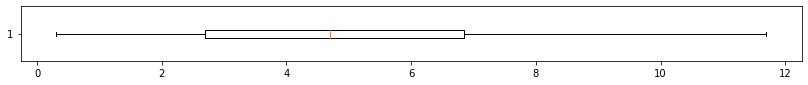

72
Mean Absolute Error =  5.2851080246913575
Cell -->  486-1260


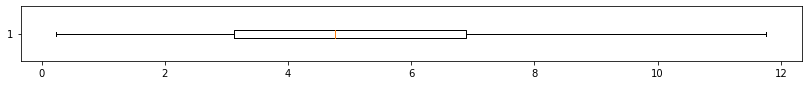

72
Mean Absolute Error =  5.229552469135802
Cell -->  486-1261


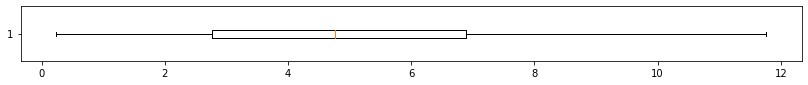

72
Mean Absolute Error =  5.084490740740741
Cell -->  486-1262


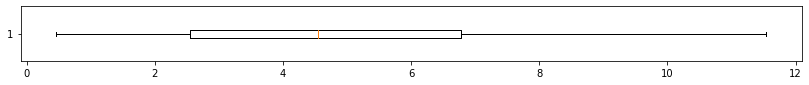

72
Mean Absolute Error =  52.80092592592593
Cell -->  486-1263


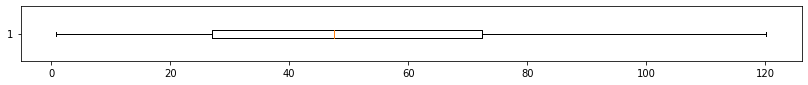

72
Mean Absolute Error =  52.036265432098766
Cell -->  486-1264


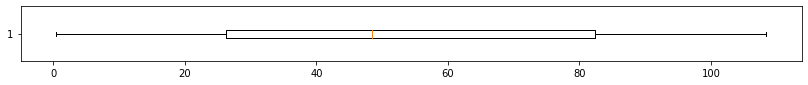

72
Mean Absolute Error =  42.09722222222222
Cell -->  486-1265


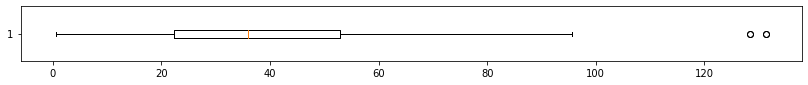

72
Mean Absolute Error =  13.39891975308642
Cell -->  486-1266


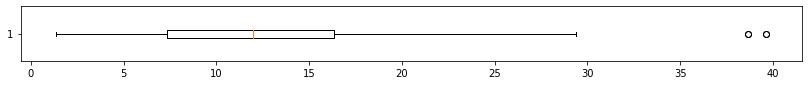

72
Mean Absolute Error =  1.9552469135802468
Cell -->  486-1267


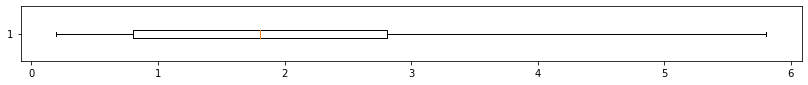

72
Mean Absolute Error =  2.244212962962963
Cell -->  486-1268


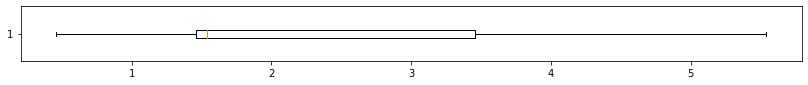

72
Mean Absolute Error =  6.674768518518519
Cell -->  487-1252


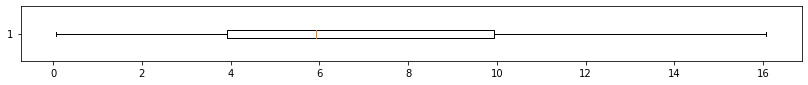

72
Mean Absolute Error =  6.567129629629629
Cell -->  487-1253


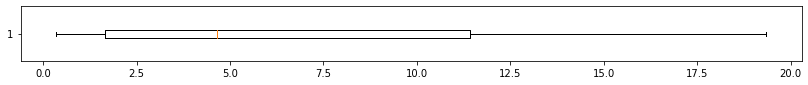

72
Mean Absolute Error =  6.1658950617283965
Cell -->  487-1254


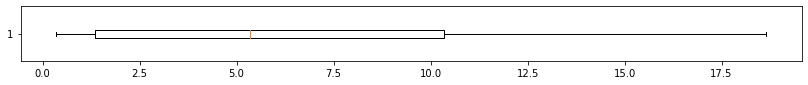

72
Mean Absolute Error =  6.366898148148146
Cell -->  487-1255


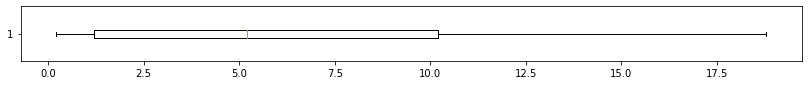

72
Mean Absolute Error =  6.524691358024692
Cell -->  487-1256


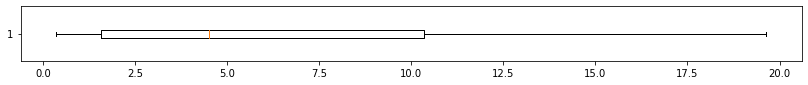

72
Mean Absolute Error =  6.06712962962963
Cell -->  487-1257


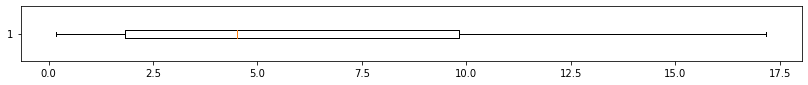

72
Mean Absolute Error =  5.123842592592593
Cell -->  487-1258


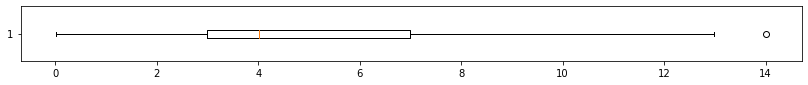

72
Mean Absolute Error =  5.642361111111111
Cell -->  487-1259


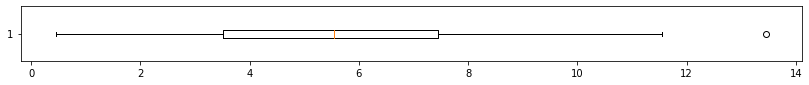

72
Mean Absolute Error =  5.565200617283951
Cell -->  487-1260


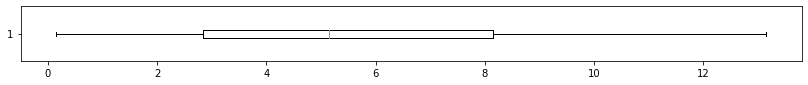

72
Mean Absolute Error =  5.4023919753086425
Cell -->  487-1261


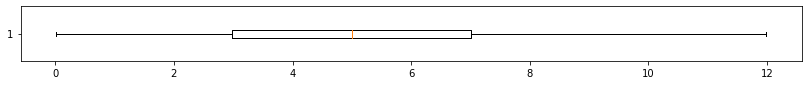

72
Mean Absolute Error =  8.907407407407407
Cell -->  487-1262


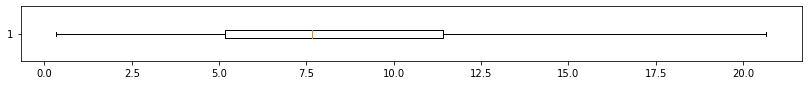

72
Mean Absolute Error =  61.486111111111114
Cell -->  487-1263


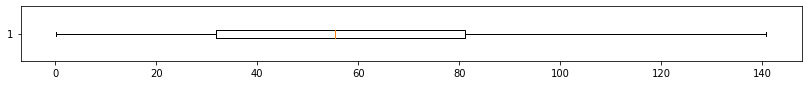

72
Mean Absolute Error =  37.94097222222222
Cell -->  487-1264


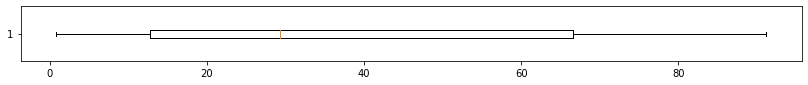

72
Mean Absolute Error =  48.02777777777778
Cell -->  487-1265


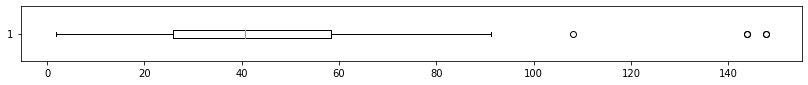

72
Mean Absolute Error =  15.664351851851855
Cell -->  487-1266


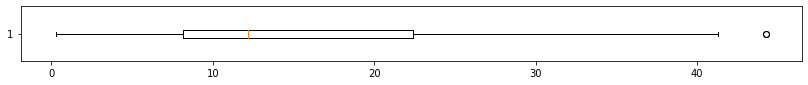

72
Mean Absolute Error =  1.7175925925925928
Cell -->  487-1267


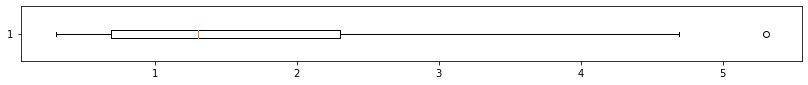

72
Mean Absolute Error =  8.55246913580247
Cell -->  487-1268


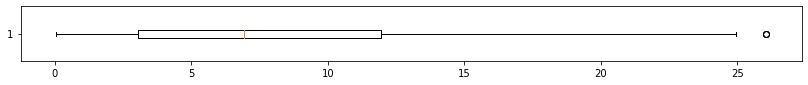

72
Mean Absolute Error =  30.025077160493822
Cell -->  488-1252


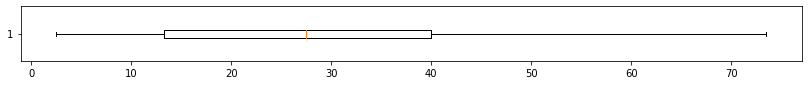

72
Mean Absolute Error =  31.625
Cell -->  488-1253


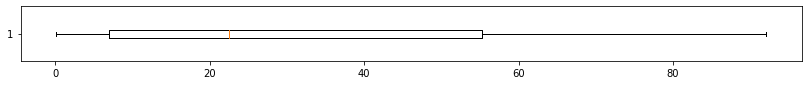

72
Mean Absolute Error =  12.616126543209877
Cell -->  488-1254


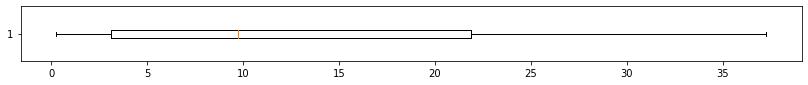

72
Mean Absolute Error =  6.632716049382718
Cell -->  488-1255


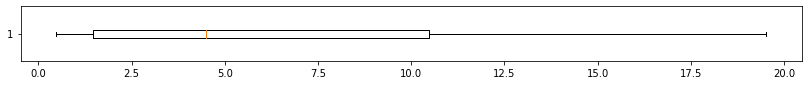

72
Mean Absolute Error =  6.586805555555554
Cell -->  488-1256


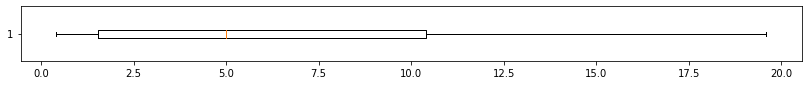

72
Mean Absolute Error =  6.387345679012346
Cell -->  488-1257


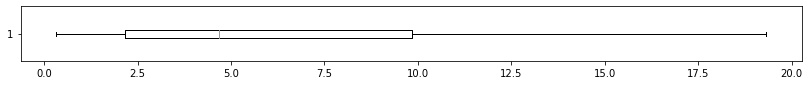

72
Mean Absolute Error =  6.708333333333333
Cell -->  488-1258


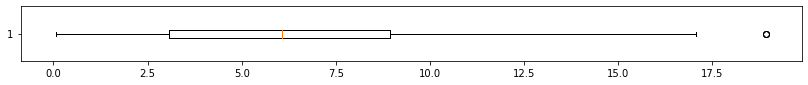

72
Mean Absolute Error =  5.780864197530864
Cell -->  488-1259


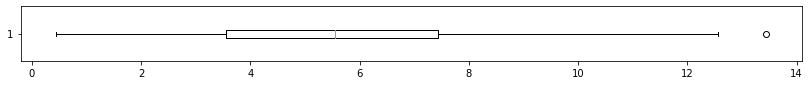

72
Mean Absolute Error =  5.721450617283951
Cell -->  488-1260


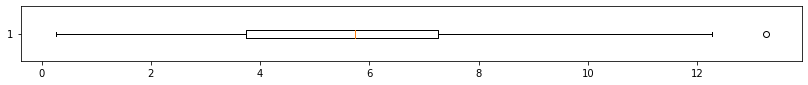

72
Mean Absolute Error =  5.527006172839506
Cell -->  488-1261


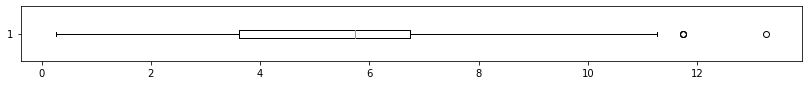

72
Mean Absolute Error =  6.260030864197531
Cell -->  488-1262


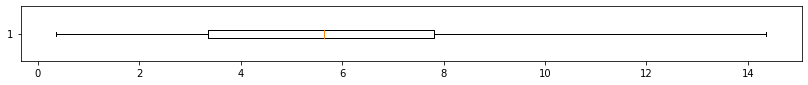

72
Mean Absolute Error =  40.05246913580247
Cell -->  488-1263


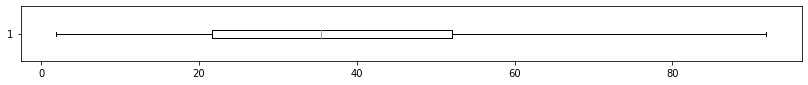

72
Mean Absolute Error =  36.15277777777778
Cell -->  488-1264


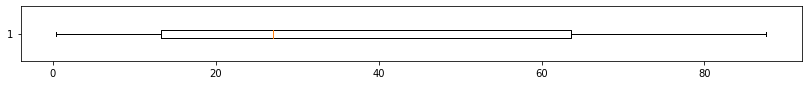

72
Mean Absolute Error =  36.29012345679012
Cell -->  488-1265


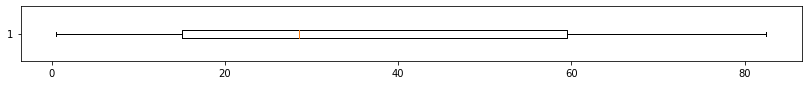

72
Mean Absolute Error =  17.257716049382715
Cell -->  488-1266


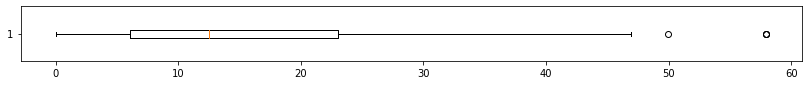

72
Mean Absolute Error =  5.675925925925927
Cell -->  488-1267


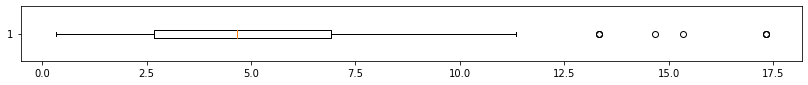

72
Mean Absolute Error =  10.541666666666666
Cell -->  488-1268


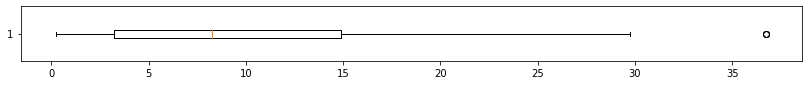

72
Mean Absolute Error =  50.81674382716049
Cell -->  489-1252


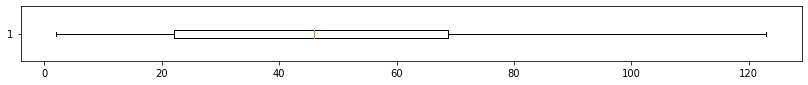

72
Mean Absolute Error =  51.93055555555556
Cell -->  489-1253


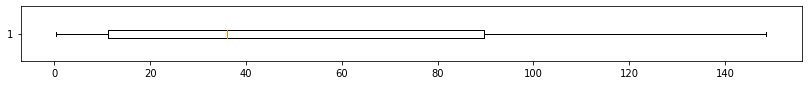

72
Mean Absolute Error =  32.56944444444444
Cell -->  489-1254


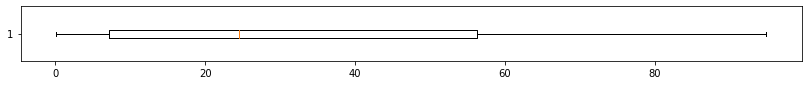

72
Mean Absolute Error =  27.351851851851848
Cell -->  489-1255


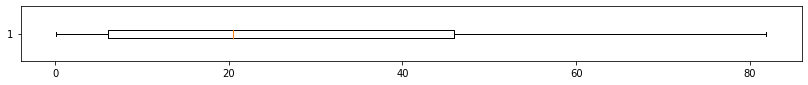

72
Mean Absolute Error =  10.536265432098764
Cell -->  489-1256


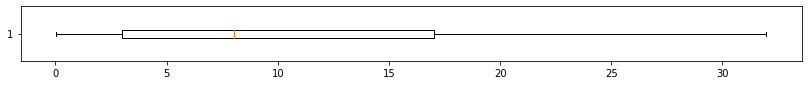

72
Mean Absolute Error =  6.586419753086421
Cell -->  489-1257


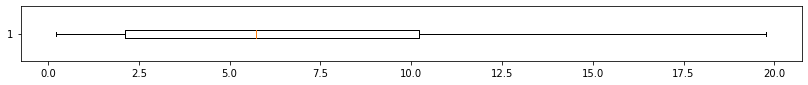

72
Mean Absolute Error =  6.792438271604938
Cell -->  489-1258


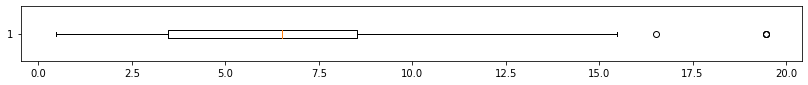

72
Mean Absolute Error =  6.538194444444445
Cell -->  489-1259


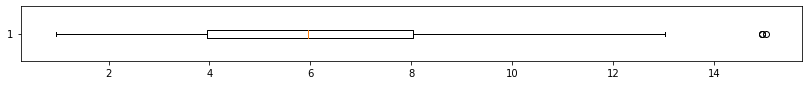

72
Mean Absolute Error =  6.116512345679013
Cell -->  489-1260


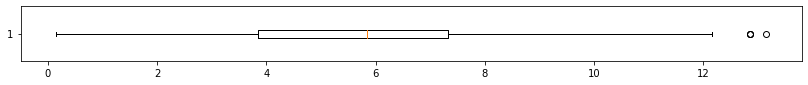

72
Mean Absolute Error =  5.661265432098765
Cell -->  489-1261


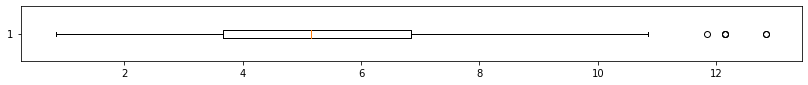

72
Mean Absolute Error =  5.5871913580246915
Cell -->  489-1262


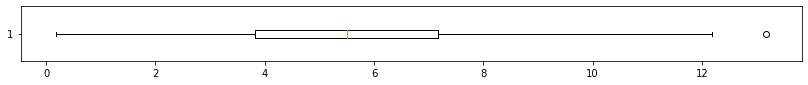

72
Mean Absolute Error =  5.378472222222222
Cell -->  489-1263


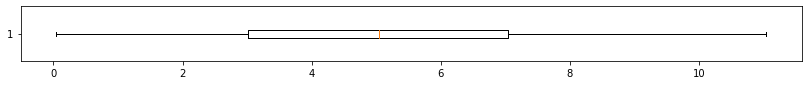

72
Mean Absolute Error =  11.238425925925927
Cell -->  489-1264


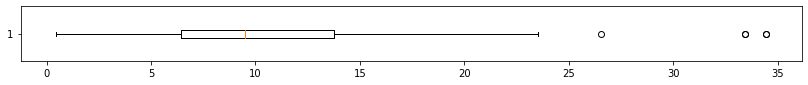

72
Mean Absolute Error =  21.319444444444443
Cell -->  489-1265


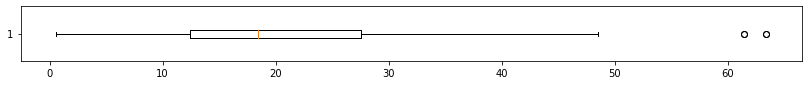

72
Mean Absolute Error =  28.916666666666668
Cell -->  489-1266


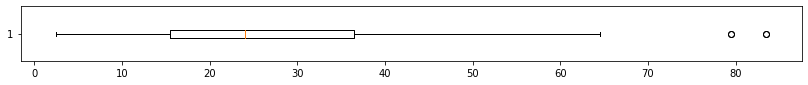

72
Mean Absolute Error =  7.886959876543208
Cell -->  489-1267


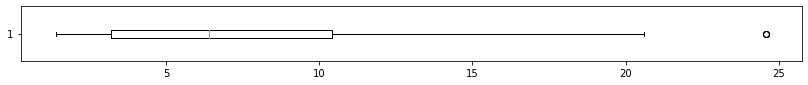

72
Mean Absolute Error =  11.537808641975309
Cell -->  489-1268


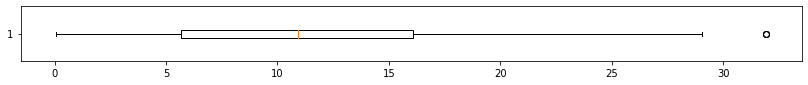

72
Mean Absolute Error =  25.592592592592595
Cell -->  490-1252


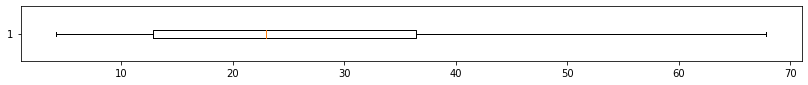

72
Mean Absolute Error =  11.562885802469136
Cell -->  490-1253


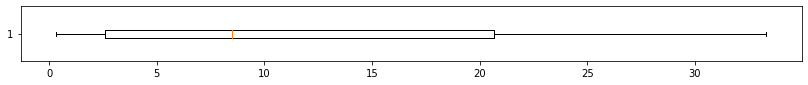

72
Mean Absolute Error =  55.88580246913581
Cell -->  490-1254


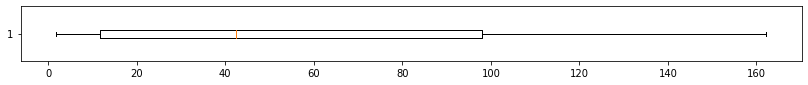

72
Mean Absolute Error =  16.796296296296294
Cell -->  490-1255


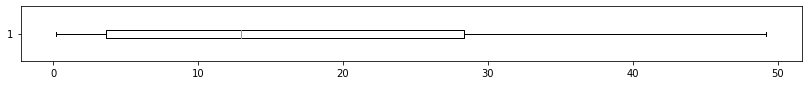

72
Mean Absolute Error =  55.16975308641976
Cell -->  490-1256


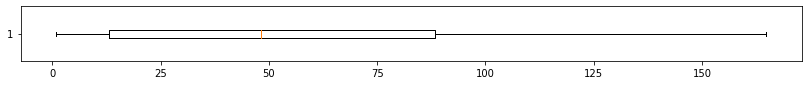

72
Mean Absolute Error =  19.49074074074074
Cell -->  490-1257


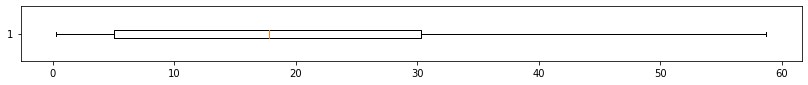

72
Mean Absolute Error =  6.826388888888889
Cell -->  490-1258


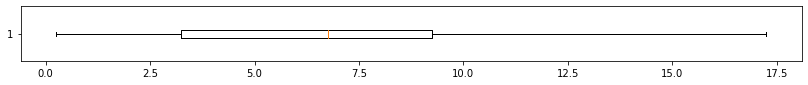

72
Mean Absolute Error =  7.000771604938271
Cell -->  490-1259


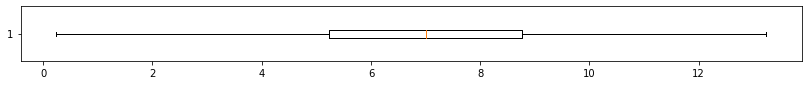

72
Mean Absolute Error =  6.800925925925926
Cell -->  490-1260


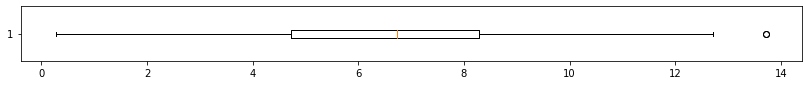

72
Mean Absolute Error =  6.326388888888889
Cell -->  490-1261


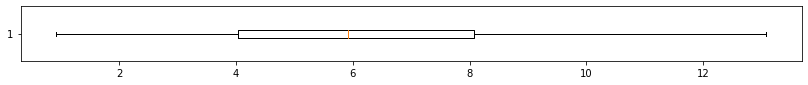

72
Mean Absolute Error =  6.026234567901235
Cell -->  490-1262


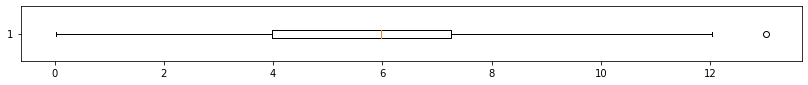

72
Mean Absolute Error =  6.5273919753086425
Cell -->  490-1263


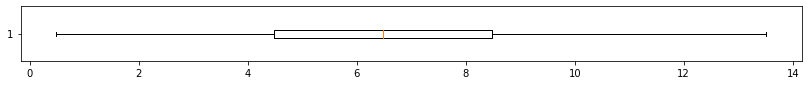

72
Mean Absolute Error =  3.1033950617283943
Cell -->  490-1264


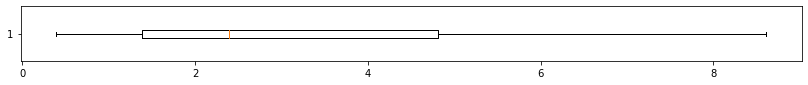

72
Mean Absolute Error =  2.986111111111111
Cell -->  490-1265


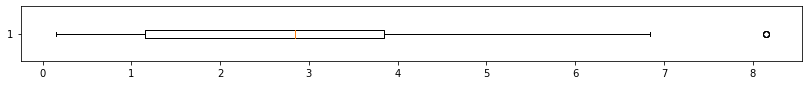

72
Mean Absolute Error =  3.994984567901235
Cell -->  490-1266


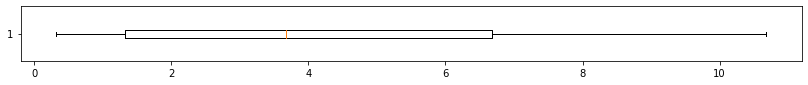

72
Mean Absolute Error =  3.319444444444445
Cell -->  490-1267


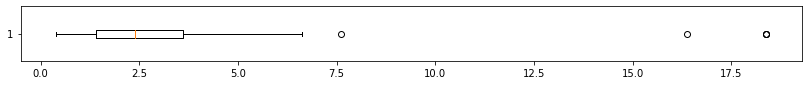

72
Mean Absolute Error =  9.912037037037036
Cell -->  490-1268


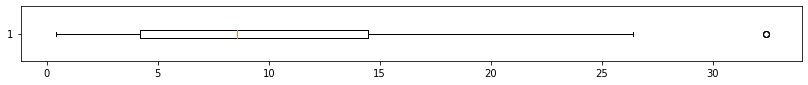

72
Mean Absolute Error =  6.084876543209877
Cell -->  491-1252


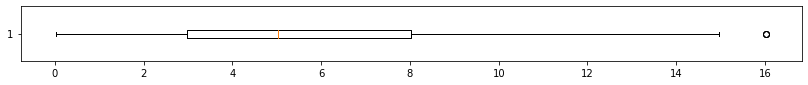

72
Mean Absolute Error =  6.121913580246914
Cell -->  491-1253


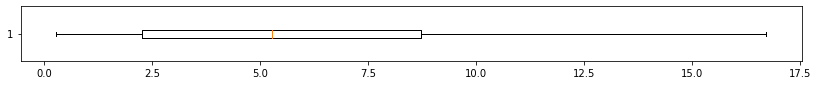

72
Mean Absolute Error =  14.880015432098768
Cell -->  491-1254


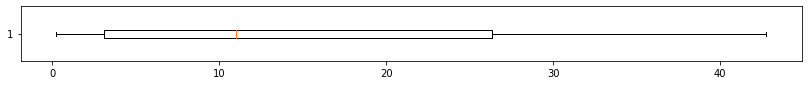

72
Mean Absolute Error =  36.25925925925926
Cell -->  491-1255


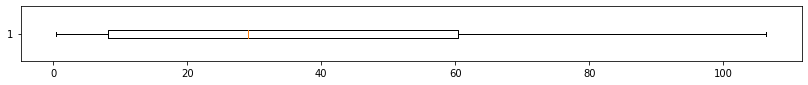

72
Mean Absolute Error =  26.372685185185187
Cell -->  491-1256


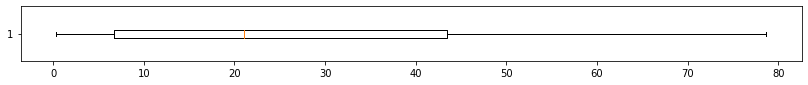

72
Mean Absolute Error =  29.657407407407405
Cell -->  491-1257


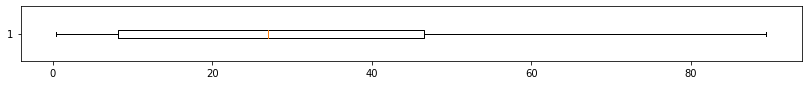

72
Mean Absolute Error =  119.83024691358024
Cell -->  491-1258


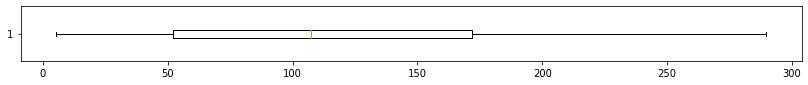

72
Mean Absolute Error =  152.59722222222223
Cell -->  491-1259


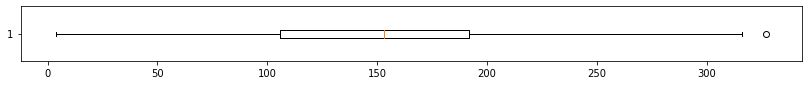

72
Mean Absolute Error =  43.907793209876544
Cell -->  491-1260


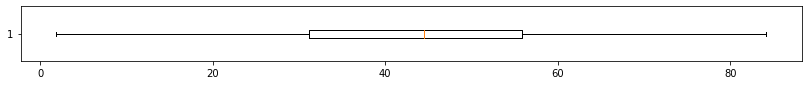

72
Mean Absolute Error =  6.584104938271604
Cell -->  491-1261


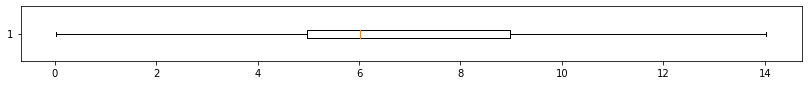

72
Mean Absolute Error =  9.653163580246915
Cell -->  491-1262


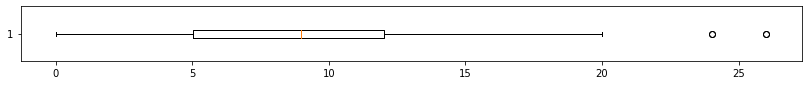

72
Mean Absolute Error =  3.966049382716049
Cell -->  491-1263


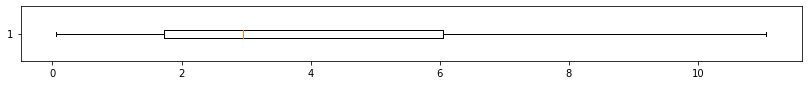

72
Mean Absolute Error =  2.891203703703704
Cell -->  491-1264


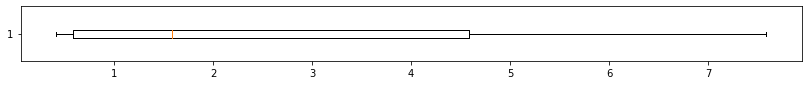

72
Mean Absolute Error =  3.1280864197530867
Cell -->  491-1265


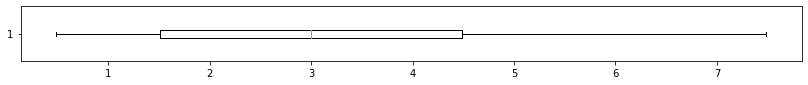

72
Mean Absolute Error =  1.8333333333333333
Cell -->  491-1266


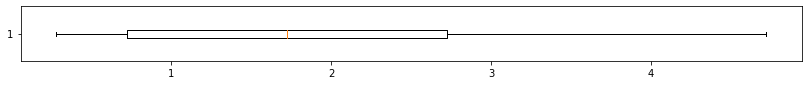

72
Mean Absolute Error =  1.0339506172839508
Cell -->  491-1267


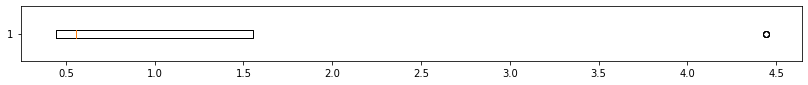

72
Mean Absolute Error =  14.787037037037035
Cell -->  491-1268


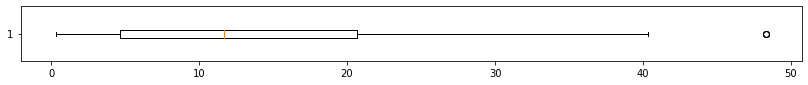

72
Mean Absolute Error =  10.915895061728396
Cell -->  492-1252


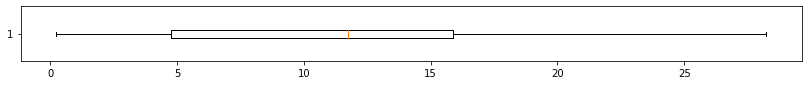

72
Mean Absolute Error =  9.584104938271606
Cell -->  492-1253


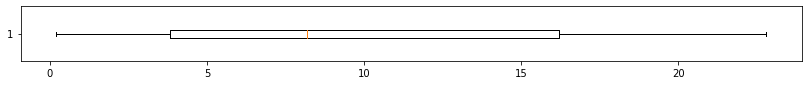

72
Mean Absolute Error =  25.231481481481485
Cell -->  492-1254


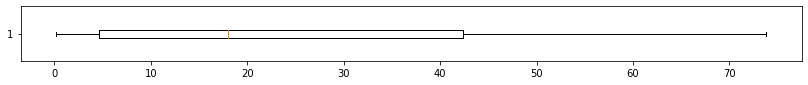

72
Mean Absolute Error =  36.01234567901234
Cell -->  492-1255


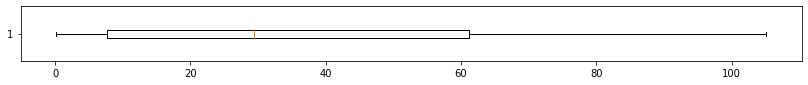

72
Mean Absolute Error =  38.52546296296296
Cell -->  492-1256


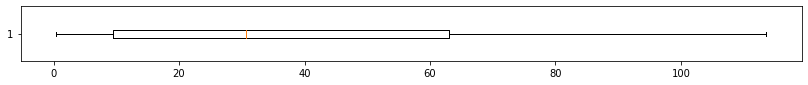

72
Mean Absolute Error =  33.85532407407408
Cell -->  492-1257


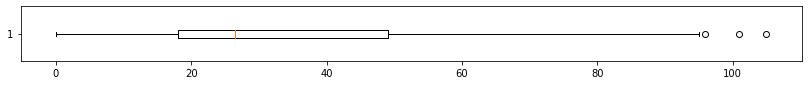

72
Mean Absolute Error =  82.00925925925927
Cell -->  492-1258


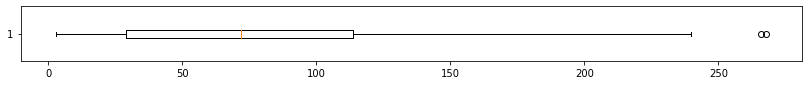

72
Mean Absolute Error =  24.694444444444443
Cell -->  492-1259


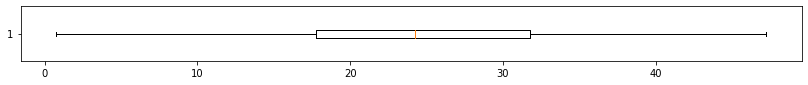

72
Mean Absolute Error =  66.58333333333333
Cell -->  492-1260


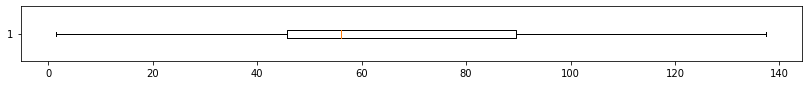

72
Mean Absolute Error =  45.625
Cell -->  492-1261


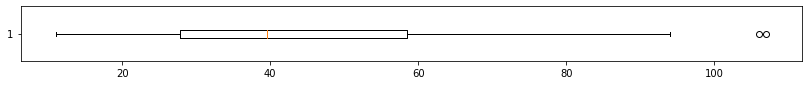

72
Mean Absolute Error =  7.097222222222222
Cell -->  492-1262


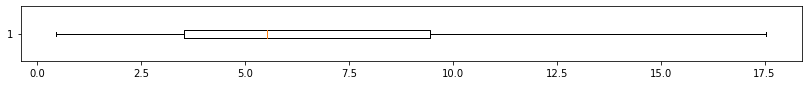

72
Mean Absolute Error =  3.763888888888889
Cell -->  492-1263


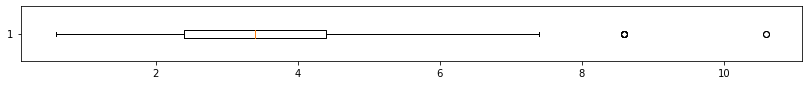

72
Mean Absolute Error =  2.8680555555555554
Cell -->  492-1264


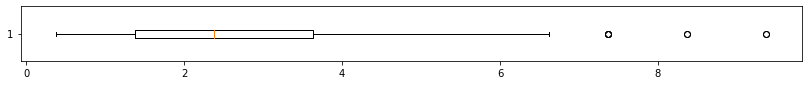

72
Mean Absolute Error =  1.9537037037037033
Cell -->  492-1265


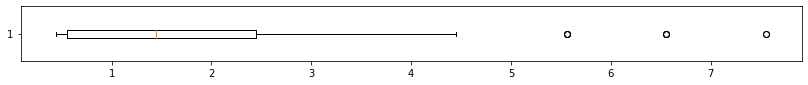

72
Mean Absolute Error =  1.5196759259259258
Cell -->  492-1266


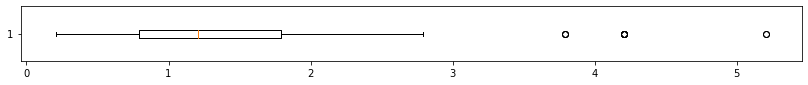

72
Mean Absolute Error =  3.7542438271604945
Cell -->  492-1267


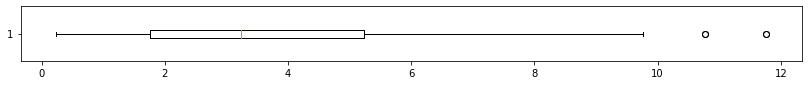

72
Mean Absolute Error =  10.70949074074074
Cell -->  492-1268


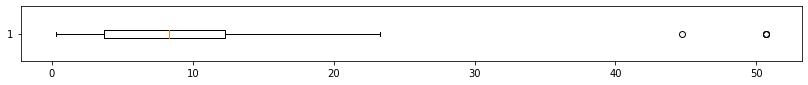

72
Mean Absolute Error =  1.7638888888888884
Cell -->  493-1252


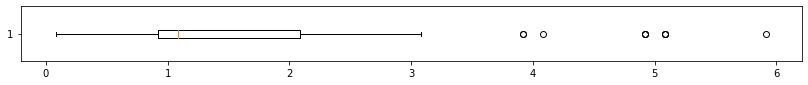

72
Mean Absolute Error =  10.856095679012347
Cell -->  493-1253


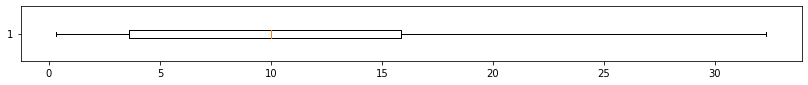

72
Mean Absolute Error =  42.333333333333336
Cell -->  493-1254


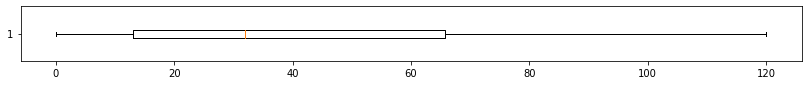

72
Mean Absolute Error =  15.962962962962962
Cell -->  493-1255


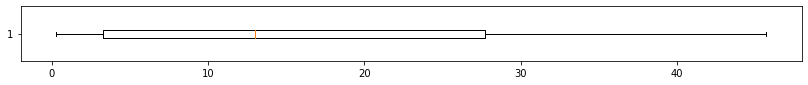

72
Mean Absolute Error =  17.265046296296298
Cell -->  493-1256


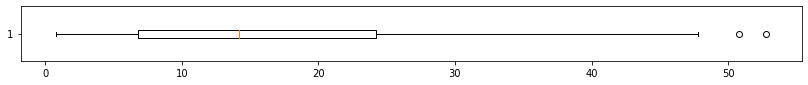

72
Mean Absolute Error =  13.578703703703704
Cell -->  493-1257


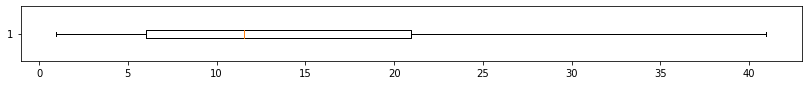

72
Mean Absolute Error =  41.26620370370371
Cell -->  493-1258


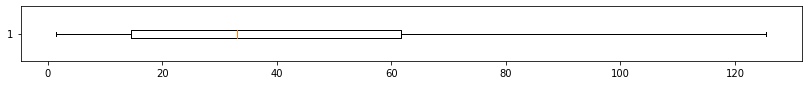

72
Mean Absolute Error =  14.29128086419753
Cell -->  493-1259


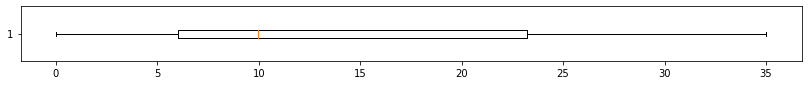

72
Mean Absolute Error =  87.76851851851852
Cell -->  493-1260


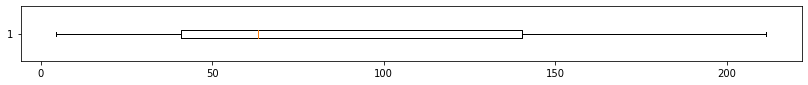

72
Mean Absolute Error =  30.282021604938272
Cell -->  493-1261


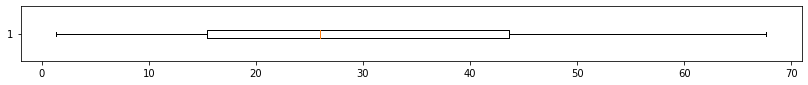

72
Mean Absolute Error =  3.3333333333333335
Cell -->  493-1262


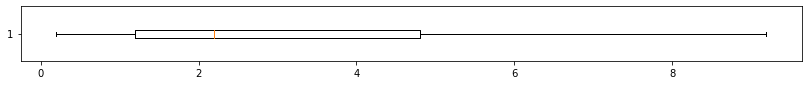

72
Mean Absolute Error =  3.4054783950617287
Cell -->  493-1263


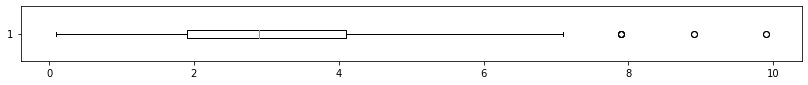

72
Mean Absolute Error =  3.486111111111111
Cell -->  493-1264


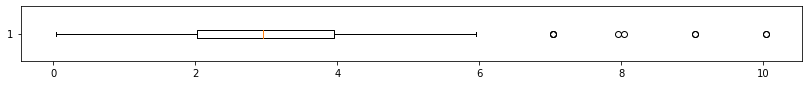

72
Mean Absolute Error =  3.7739197530864197
Cell -->  493-1265


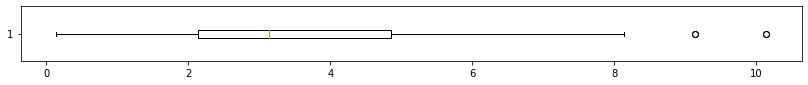

72
Mean Absolute Error =  1.0694444444444453
Cell -->  493-1266


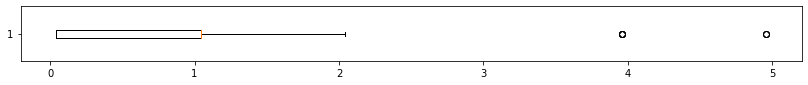

72
Mean Absolute Error =  5.530092592592593
Cell -->  493-1267


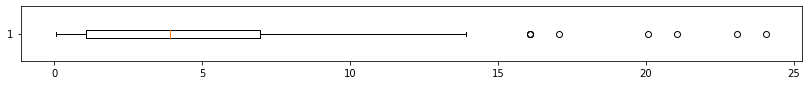

72
Mean Absolute Error =  9.030092592592592
Cell -->  493-1268


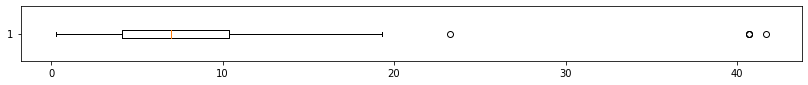

72
Mean Absolute Error =  3.951388888888889
Cell -->  494-1252


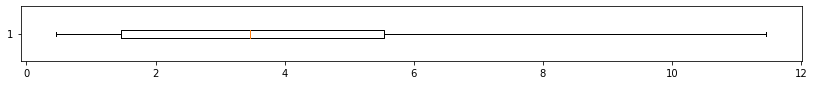

72
Mean Absolute Error =  3.6265432098765427
Cell -->  494-1253


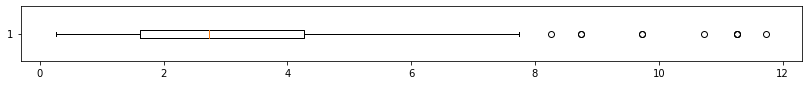

72
Mean Absolute Error =  19.701003086419753
Cell -->  494-1254


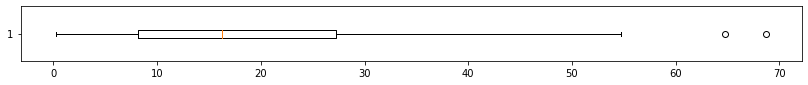

72
Mean Absolute Error =  33.65393518518519
Cell -->  494-1255


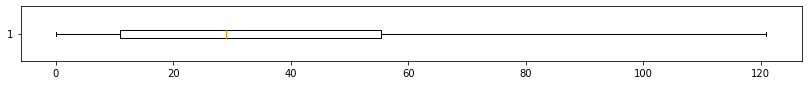

72
Mean Absolute Error =  33.839506172839506
Cell -->  494-1256


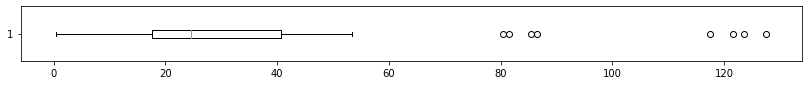

72
Mean Absolute Error =  56.01543209876544
Cell -->  494-1257


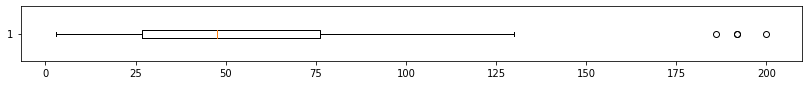

72
Mean Absolute Error =  18.791666666666668
Cell -->  494-1258


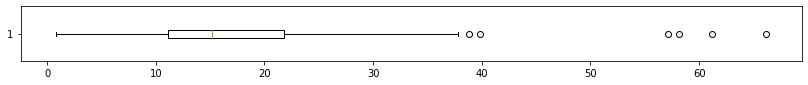

72
Mean Absolute Error =  10.872685185185185
Cell -->  494-1259


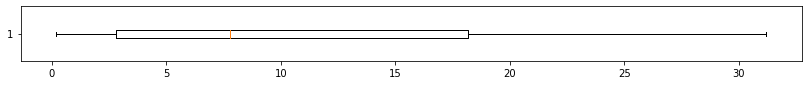

72
Mean Absolute Error =  6.25925925925926
Cell -->  494-1260


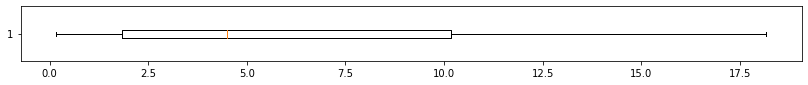

72
Mean Absolute Error =  4.0432098765432105
Cell -->  494-1261


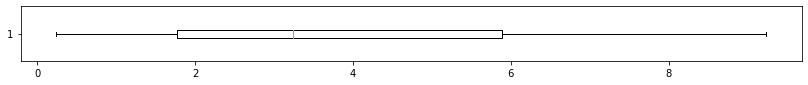

72
Mean Absolute Error =  3.592592592592593
Cell -->  494-1262


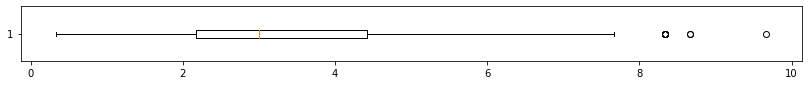

72
Mean Absolute Error =  3.4243827160493825
Cell -->  494-1263


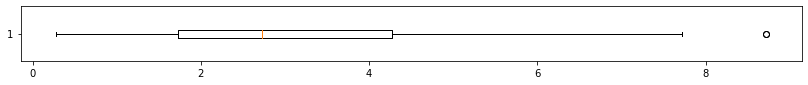

72
Mean Absolute Error =  3.4305555555555554
Cell -->  494-1264


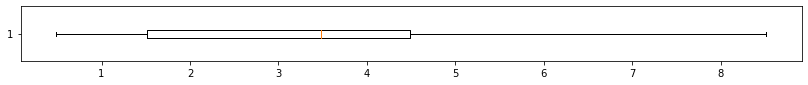

72
Mean Absolute Error =  3.0983796296296298
Cell -->  494-1265


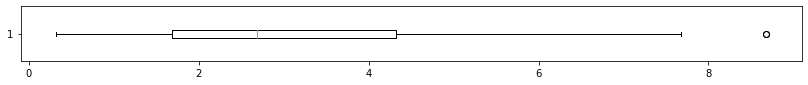

72
Mean Absolute Error =  1.367283950617284
Cell -->  494-1266


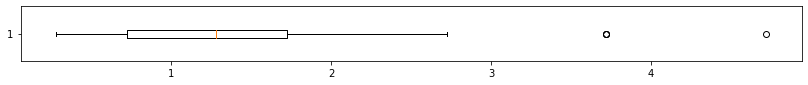

72
Mean Absolute Error =  11.699074074074076
Cell -->  494-1267


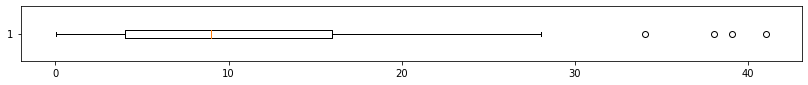

72
Mean Absolute Error =  22.696759259259256
Cell -->  494-1268


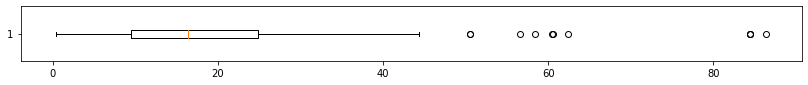

72
Mean Absolute Error =  1.5694444444444449
Cell -->  495-1252


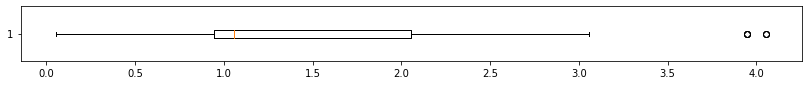

72
Mean Absolute Error =  1.858796296296296
Cell -->  495-1253


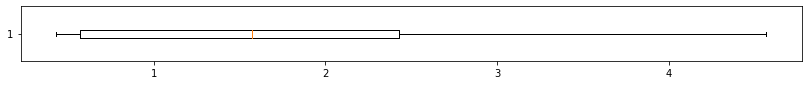

72
Mean Absolute Error =  2.4652777777777777
Cell -->  495-1254


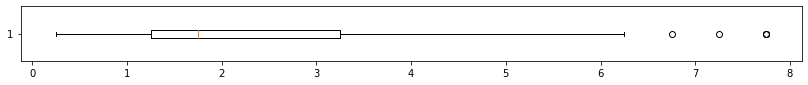

72
Mean Absolute Error =  11.621141975308642
Cell -->  495-1255


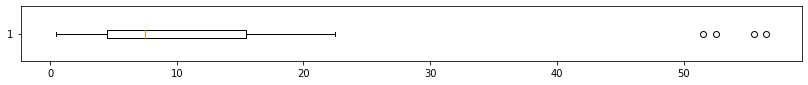

72
Mean Absolute Error =  54.81250000000001
Cell -->  495-1256


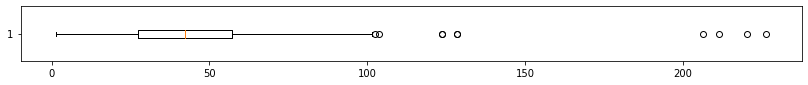

72
Mean Absolute Error =  55.04243827160494
Cell -->  495-1257


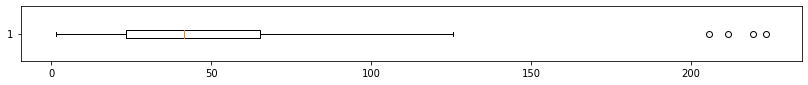

72
Mean Absolute Error =  60.30555555555556
Cell -->  495-1258


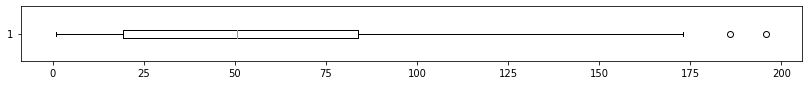

72
Mean Absolute Error =  33.839506172839506
Cell -->  495-1259


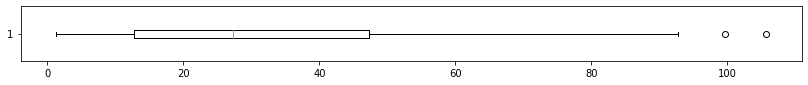

72
Mean Absolute Error =  31.913580246913583
Cell -->  495-1260


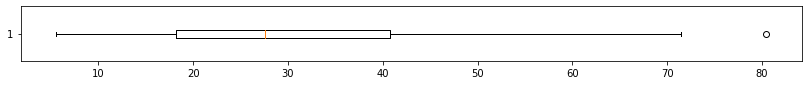

72
Mean Absolute Error =  43.12191358024691
Cell -->  495-1261


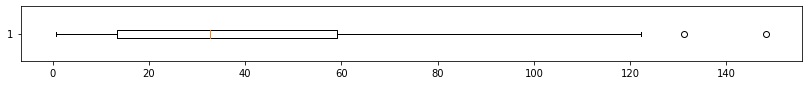

72
Mean Absolute Error =  71.91280864197532
Cell -->  495-1262


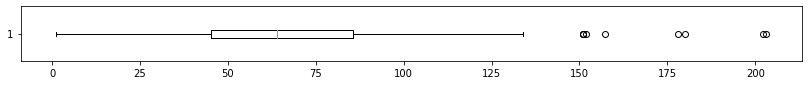

72
Mean Absolute Error =  66.54282407407408
Cell -->  495-1263


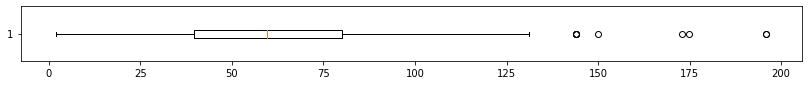

72
Mean Absolute Error =  56.51273148148149
Cell -->  495-1264


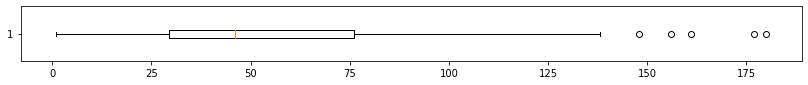

72
Mean Absolute Error =  34.06983024691358
Cell -->  495-1265


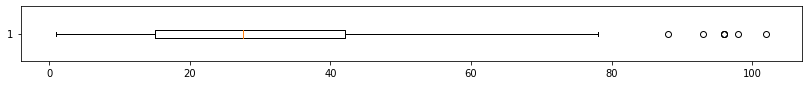

72
Mean Absolute Error =  19.805555555555557
Cell -->  495-1266


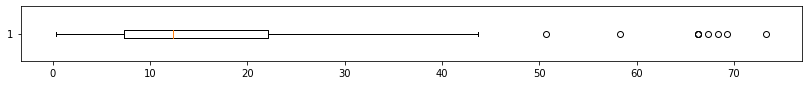

72
Mean Absolute Error =  29.04128086419753
Cell -->  495-1267


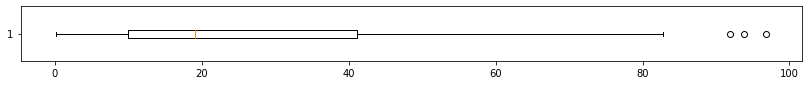

72
Mean Absolute Error =  15.463734567901234
Cell -->  495-1268


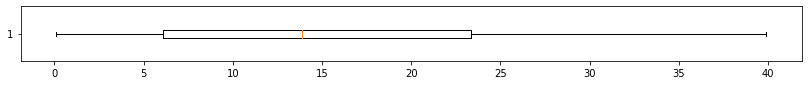

72
Mean Absolute Error =  21.46875
Cell -->  496-1252


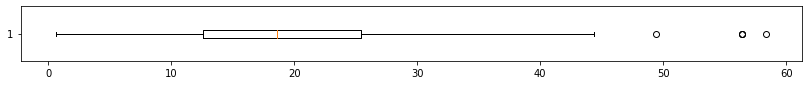

72
Mean Absolute Error =  20.182870370370374
Cell -->  496-1253


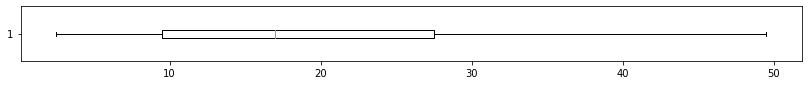

72
Mean Absolute Error =  11.913194444444445
Cell -->  496-1254


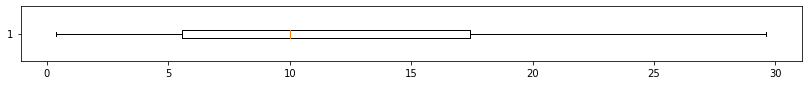

72
Mean Absolute Error =  39.032407407407405
Cell -->  496-1255


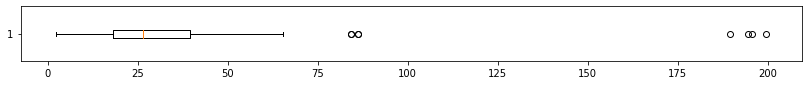

72
Mean Absolute Error =  43.19598765432099
Cell -->  496-1256


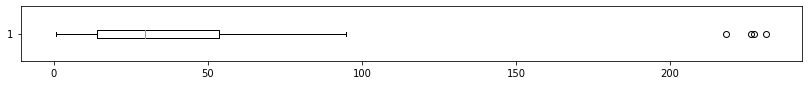

72
Mean Absolute Error =  37.486111111111114
Cell -->  496-1257


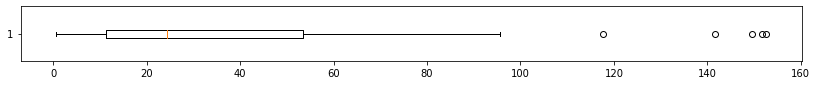

72
Mean Absolute Error =  37.41936728395061
Cell -->  496-1258


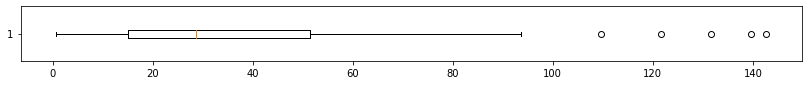

72
Mean Absolute Error =  38.47337962962963
Cell -->  496-1259


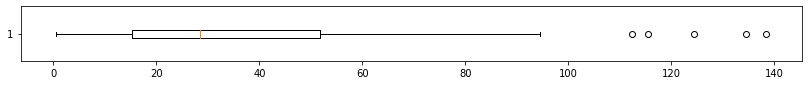

72
Mean Absolute Error =  28.09722222222222
Cell -->  496-1260


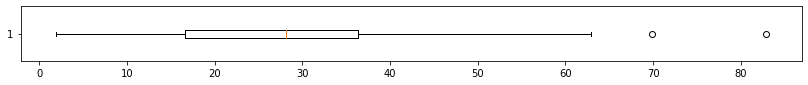

72
Mean Absolute Error =  4.771604938271604
Cell -->  496-1261


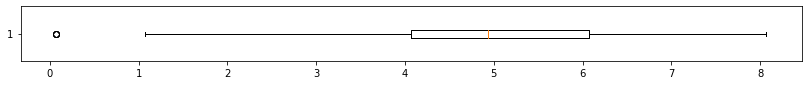

72
Mean Absolute Error =  1.974151234567901
Cell -->  496-1262


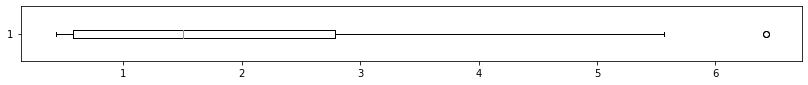

72
Mean Absolute Error =  1.8097993827160492
Cell -->  496-1263


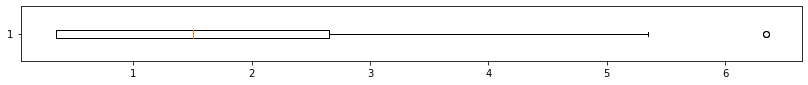

72
Mean Absolute Error =  1.1774691358024691
Cell -->  496-1264


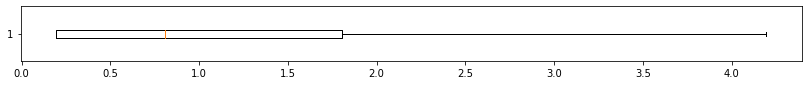

72
Mean Absolute Error =  1.5354938271604939
Cell -->  496-1265


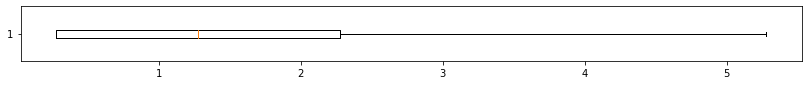

72
Mean Absolute Error =  1.7465277777777777
Cell -->  496-1266


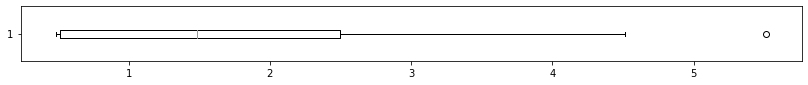

72
Mean Absolute Error =  1.4876543209876543
Cell -->  496-1267


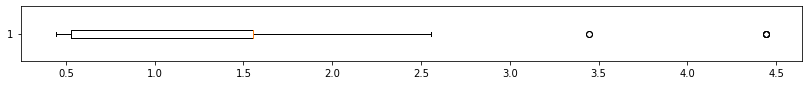

72
Mean Absolute Error =  3.4907407407407405
Cell -->  496-1268


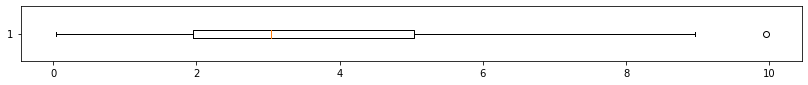

72
Mean Absolute Error =  3.182484567901234
Cell -->  497-1252


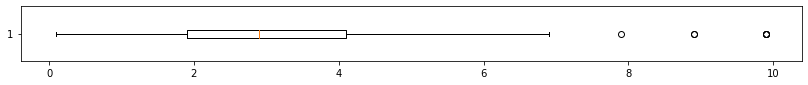

72
Mean Absolute Error =  1.0806327160493827
Cell -->  497-1253


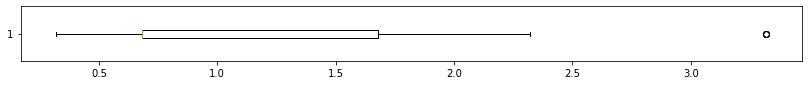

72
Mean Absolute Error =  21.086805555555557
Cell -->  497-1254


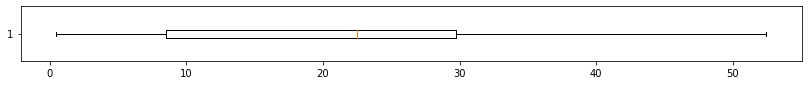

72
Mean Absolute Error =  19.854166666666668
Cell -->  497-1255


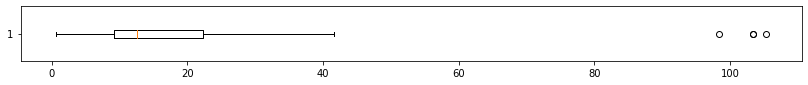

72
Mean Absolute Error =  4.675925925925927
Cell -->  497-1256


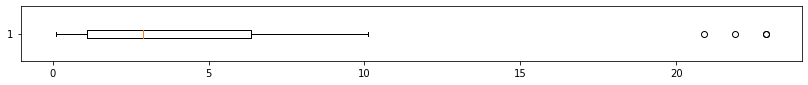

72
Mean Absolute Error =  10.774691358024691
Cell -->  497-1257


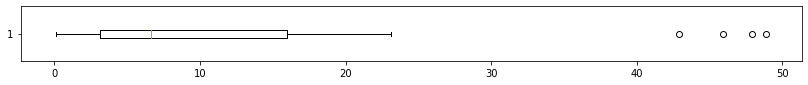

72
Mean Absolute Error =  16.13888888888889
Cell -->  497-1258


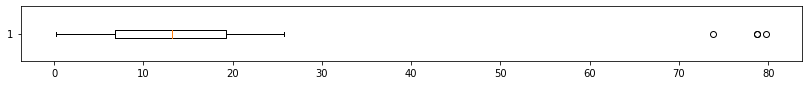

72
Mean Absolute Error =  23.24074074074074
Cell -->  497-1259


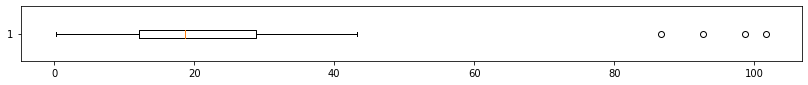

72
Mean Absolute Error =  15.089120370370372
Cell -->  497-1260


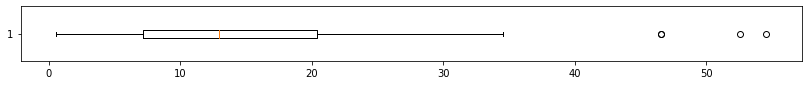

72
Mean Absolute Error =  3.762345679012346
Cell -->  497-1261


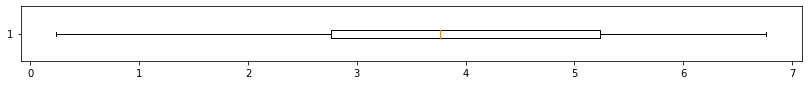

72
Mean Absolute Error =  2.0073302469135803
Cell -->  497-1262


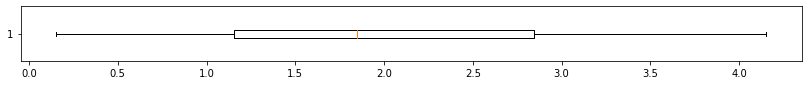

72
Mean Absolute Error =  1.1068672839506173
Cell -->  497-1263


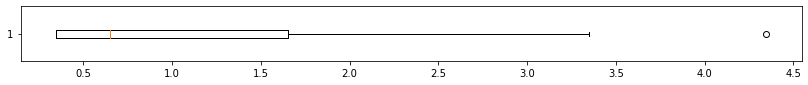

72
Mean Absolute Error =  1.733796296296296
Cell -->  497-1264


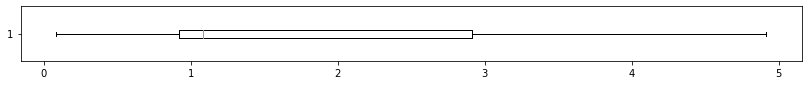

72
Mean Absolute Error =  2.109182098765432
Cell -->  497-1265


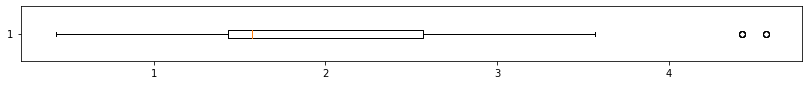

72
Mean Absolute Error =  1.753858024691358
Cell -->  497-1266


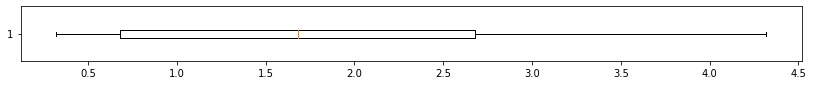

72
Mean Absolute Error =  1.2006172839506175
Cell -->  497-1267


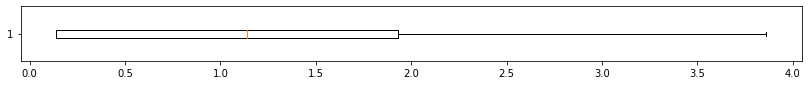

72
Mean Absolute Error =  10.93364197530864
Cell -->  497-1268


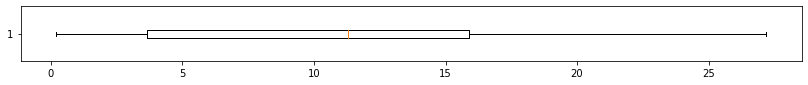

72
Mean Absolute Error =  9.571373456790125
Cell -->  498-1252


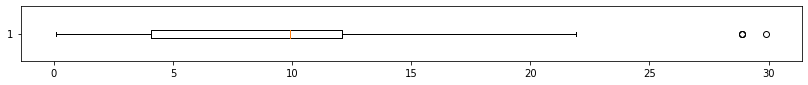

72
Mean Absolute Error =  11.215277777777779
Cell -->  498-1253


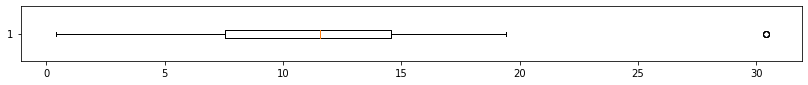

72
Mean Absolute Error =  14.04050925925926
Cell -->  498-1254


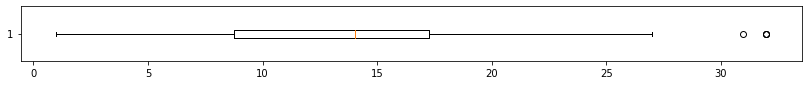

72
Mean Absolute Error =  0.7962962962962962
Cell -->  498-1255


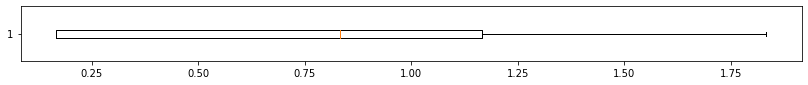

72
Mean Absolute Error =  4.5
Cell -->  498-1256


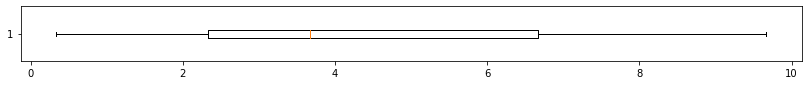

72
Mean Absolute Error =  8.902777777777779
Cell -->  498-1257


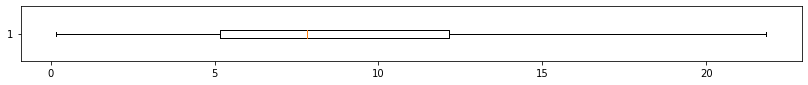

72
Mean Absolute Error =  8.36111111111111
Cell -->  498-1258


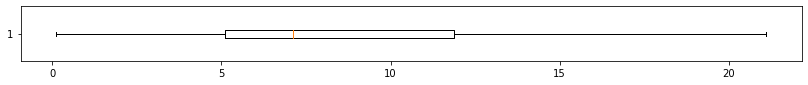

72
Mean Absolute Error =  8.546296296296298
Cell -->  498-1259


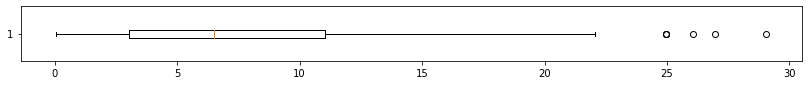

72
Mean Absolute Error =  8.375
Cell -->  498-1260


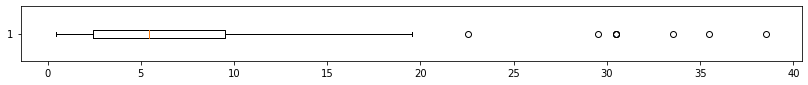

72
Mean Absolute Error =  5.189814814814814
Cell -->  498-1261


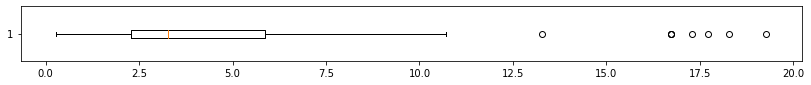

72
Mean Absolute Error =  1.1253858024691359
Cell -->  498-1262


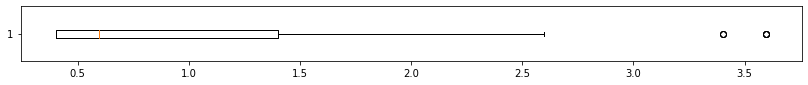

72
Mean Absolute Error =  1.1145833333333333
Cell -->  498-1263


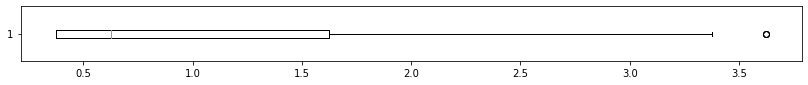

72
Mean Absolute Error =  1.9074074074074074
Cell -->  498-1264


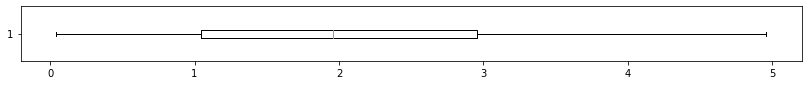

72
Mean Absolute Error =  1.2824074074074077
Cell -->  498-1265


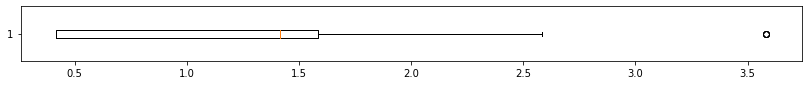

72
Mean Absolute Error =  1.180555555555556
Cell -->  498-1266


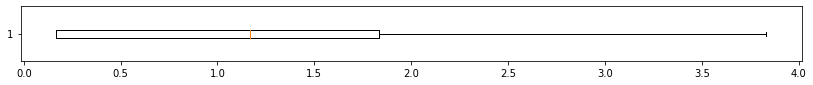

72
Mean Absolute Error =  13.040895061728396
Cell -->  498-1267


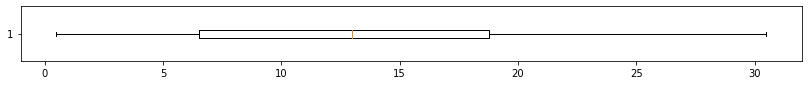

72
Mean Absolute Error =  4.516203703703703
Cell -->  498-1268


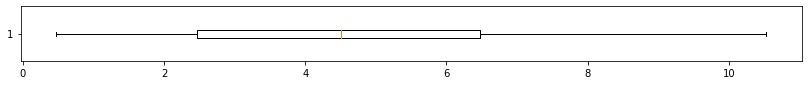

In [9]:
dict2data = {}
for i, k in agg_by_cell:
        cell_i = i
        value_day = []
        for index, row in k.iterrows():
        
            s = row['date'].split('-')
            year = int(s[0])
            month = int(s[1])
            day = int(s[2])
        
            dayofweek = datetime.date(year, month, day).strftime("%A")
            hour = row['hours']
            if (dayofweek == 'Monday' and hour == 13): 
                value_day.append(row['nr_people']) 
                
        # trasforma in numpy array
        value_day_array = np.array(value_day)
        
        # trova la media
        mean_day = value_day_array.mean()
        
        # fai la differenza tra i valori e la media 
        result = abs(value_day_array - mean_day)
        print(len(value_day_array))
        
         # collect data 2 dictionary
        minimum = np.amin(result)   
        per75 = np.percentile(result, 75)
        per50 = np.percentile(result, 50)
        per25 = np.percentile(result, 25)
        maximum = np.amax(result)
        l5i = [minimum, per25, per50, per75, maximum]
        dict2data[cell_i] = l5i
        
        # show boxplot
        print('Mean Absolute Error = ', np.mean(result))
        print('Cell --> ', cell_i)
        plt.figure(figsize = (14,1))
        plt.boxplot(result, vert= False);
        plt.show()  

### Scrivi risultati su file 

In [10]:
with open('error_data_4_Naive_Monday_h13.csv', 'w') as f:
    for key, value in dict2data.items():
        f.write('%s:%s\n' % (key, value))

### Calcolo per ogni cella l'errore di Naive

In [42]:
import math

In [46]:
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
hours_of_day = [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 
                14.0, 15.0, 16.0, 17.0, 18.0,19.0, 20.0, 21.0, 22.0, 23.0]

dict2data = {}
MAPE2data = {}
RMSE2data = {}
count = 0
for i,k in agg_by_cell:
    k = k.iloc[::4, :]
    error_per_cell = np.array([])
    mape_error_per_cell = np.array([])
    cell_i = i
    for dow in days_of_week:
        
        for hod in hours_of_day:  
            value_hour = [] 
            
            for index, row in k.iterrows():
        
                s = row['date'].split('-')
                year = int(s[0])
                month = int(s[1])
                day = int(s[2])
        
                dayofweek = datetime.date(year, month, day).strftime("%A")
                hour = row['hours']
                if (dayofweek == dow and hour == hod): 
                    value_hour.append(row['nr_people']) 
                
            # trasforma in numpy array
            value_day_array = np.array(value_hour)
            #print(len(value_hour))
            
            # trova la media
            mean_day = value_day_array.mean()
        
            # fai la differenza tra i valori e la media 
            result = abs(value_day_array - mean_day)
            error_per_cell = np.append(error_per_cell, result)
            mape_i = 100 * np.divide(result, value_day_array) 
            mape_error_per_cell = np.append(mape_error_per_cell, mape_i)
    #print('Elementi in error_per_cell ', len(error_per_cell))
    # show boxplot
    #print('Error for day '+str(dow)+', Hour ',hod)
    #print('Mean Absolute Error = ', np.mean(error_per_cell))   
    #plt.figure(figsize = (14,1))
    #plt.boxplot(error_per_cell, vert= False);
    #plt.show() 
    count = count +1
    print('count ', count)
    power_err = np.power(error_per_cell, 2)
    rmse = math.sqrt(np.mean(power_err))
    mape = np.mean(mape_error_per_cell)
    minimum = np.amin(error_per_cell)   
    per75 = np.percentile(error_per_cell, 75)
    per50 = np.percentile(error_per_cell, 50)
    per25 = np.percentile(error_per_cell, 25)
    maximum = np.amax(error_per_cell)
    l5i = [minimum, per25, per50, per75, maximum]
    
    dict2data[cell_i] = l5i
    MAPE2data[cell_i] = mape
    RMSE2data[cell_i] = rmse

count  1
count  2
count  3
count  4
count  5
count  6
count  7
count  8
count  9
count  10
count  11
count  12
count  13
count  14
count  15
count  16
count  17
count  18
count  19
count  20
count  21
count  22
count  23
count  24
count  25
count  26
count  27
count  28
count  29
count  30
count  31
count  32
count  33
count  34
count  35
count  36
count  37
count  38
count  39
count  40
count  41
count  42
count  43
count  44
count  45
count  46
count  47
count  48
count  49
count  50
count  51
count  52
count  53
count  54
count  55
count  56
count  57
count  58
count  59
count  60
count  61
count  62
count  63
count  64
count  65
count  66
count  67
count  68
count  69
count  70
count  71
count  72
count  73
count  74
count  75
count  76
count  77
count  78
count  79
count  80
count  81
count  82
count  83
count  84
count  85
count  86
count  87
count  88
count  89
count  90
count  91
count  92
count  93
count  94
count  95
count  96
count  97
count  98
count  99
count  100
count  1

In [47]:
with open('MAXAE_error_data_4_Naive_DayHourAveragePrediction.csv', 'w') as f:
    for key, value in dict2data.items():
        f.write('%s:%s\n' % (key, value))

In [48]:
with open('MAPE_error_data_4_Naive_DayHourAveragePrediction.csv', 'w') as f:
    for key, value in MAPE2data.items():
        f.write('%s:%s\n' % (key, value))
with open('RMSE_error_data_4_Naive_DayHourAveragePrediction.csv', 'w') as f:
    for key, value in RMSE2data.items():
        f.write('%s:%s\n' % (key, value))

In [12]:
## summary
data.describe()

,nr_people,hours,minutes
count,2.609568e+06,2.609568e+06,2.609568e+06
mean,1.504546e+02,1.150000e+01,2.250000e+01
std,1.801338e+02,6.922188e+00,1.677051e+01
min,8.000000e+00,0.000000e+00,0.000000e+00
25%,3.400000e+01,5.750000e+00,1.125000e+01
50%,7.700000e+01,1.150000e+01,2.250000e+01
75%,2.110000e+02,1.725000e+01,3.375000e+01
max,2.230000e+03,2.300000e+01,4.500000e+01


In [13]:
d = data.describe()
global_percent_75 = d['nr_people']['75%']
global_percent_50 = d['nr_people']['50%']
global_percent_25 = d['nr_people']['25%']
global_mean = d['nr_people']['mean']
print(global_percent_75, global_percent_50, global_percent_25, global_mean)


211.0 77.0 34.0 150.45458865222136


In [14]:
count = 0
values = []
is_low_activity = []
is_medium_activity = []
is_high_activity = []
is_very_high_activity = []

cell_activity = {}

count = 0
for i,k in agg_by_cell:
    
    cell_i = i
    values = k.describe()
    max_cell = values['nr_people']['75%']
    percent_75_cell = values['nr_people']['75%']
    percent_50_cell = values['nr_people']['50%']
    percent_25_cell = values['nr_people']['25%']
    mean_cell = values['nr_people']['mean']
    
    #for index, row in k.iterrows():   
    if max_cell < global_percent_25 :
            #is_low_activity.append(1)
            #is_medium_activity.append(0)
            #is_high_activity.append(0)
            #is_very_high_activity.append(0)
            cell_activity[cell_i] = 'is_low'
            
    if max_cell > global_percent_25 and max_cell < global_mean:
            #is_low_activity.append(0)
            #is_medium_activity.append(1)
            #is_high_activity.append(0)
            #is_very_high_activity.append(0)
            cell_activity[cell_i] = 'is_medium'
            
    if max_cell > global_mean and max_cell < global_percent_75:
            #is_low_activity.append(0)
            #is_medium_activity.append(0)
            #is_high_activity.append(1)
            #is_very_high_activity.append(0)
            cell_activity[cell_i] = 'is_high'
        
    if max_cell > global_mean and max_cell > global_percent_75:
            #is_low_activity.append(0)
            #is_medium_activity.append(0)
            #is_high_activity.append(0)
            #is_very_high_activity.append(1)
            cell_activity[cell_i] = 'is_very_high'
   

In [15]:
len(cell_activity)

221

In [16]:
count = 0
for index, row in data.iterrows():
    #print(index, row)
    
    cell_number = row['cell_num']   
    activity_level = cell_activity[cell_number]
    
    if activity_level == 'is_low':
            is_low_activity.append(1)
            is_medium_activity.append(0)
            is_high_activity.append(0)
            is_very_high_activity.append(0)
           
    if activity_level == 'is_medium':
            is_low_activity.append(0)
            is_medium_activity.append(1)
            is_high_activity.append(0)
            is_very_high_activity.append(0)
             
    if activity_level == 'is_high':
            is_low_activity.append(0)
            is_medium_activity.append(0)
            is_high_activity.append(1)
            is_very_high_activity.append(0)
            
    if activity_level == 'is_very_high':
            is_low_activity.append(0)
            is_medium_activity.append(0)
            is_high_activity.append(0)
            is_very_high_activity.append(1)   

In [17]:
print(len(is_very_high_activity))
print(len(is_high_activity))
print(len(is_medium_activity))
print(len(is_low_activity))

2609568
2609568
2609568
2609568


In [18]:
data['is_low_activity'] = is_low_activity
data['is_medium_activity'] = is_medium_activity
data['is_high_activity'] = is_high_activity
data['is_very_high_activity'] = is_very_high_activity

In [19]:
len(data)

2609568

In [20]:
very_high_activity_data = data[data['is_very_high_activity']==1]
high_activity_data = data[data['is_high_activity']==1]
medium_activity_data = data[data['is_medium_activity']==1]
low_activity_data = data[data['is_low_activity']==1]

In [21]:
print(len(very_high_activity_data))
print(len(high_activity_data))
print(len(medium_activity_data))
print(len(low_activity_data))

791136
212544
1074528
531360


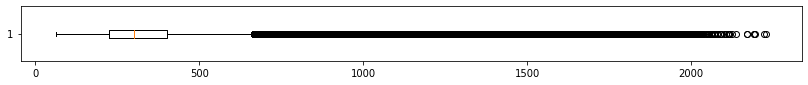

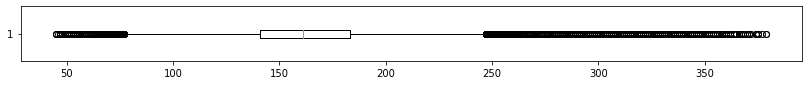

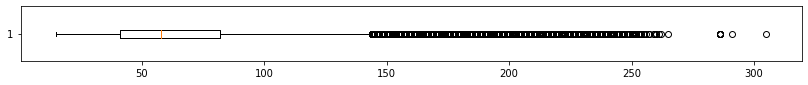

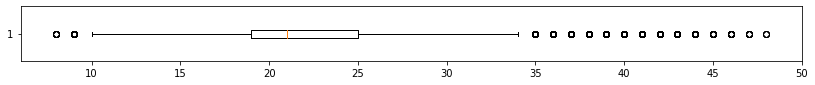

In [22]:
plt.figure(figsize = (14,1))
plt.boxplot(very_high_activity_data['nr_people'], vert= False);
plt.show()
plt.figure(figsize = (14,1))
plt.boxplot(high_activity_data['nr_people'], vert= False);
plt.show()  
plt.figure(figsize = (14,1))
plt.boxplot(medium_activity_data['nr_people'], vert= False);
plt.show() 
plt.figure(figsize = (14,1))
plt.boxplot(low_activity_data['nr_people'], vert= False);
plt.show() 